# Sistema de Aprendizaje Automático para la Asesoría Personalizada de Dosis de Insulina en Personas con Diabetes Tipo 1
- Alumno: Carlos Muñoz Sánchez
- Tutor: Salvador García López
- Año: 2025

Este cuaderno contiene todo el código del trabajo, desde la extracción de ejemplos de entrenamiento a partir de la base de datos hasta el entrenamiento y evaluación de los modelos propuestos.

## Configuración y funciones auxiliares

In [ ]:
!pip install pyod
!pip install tabpfn
!git clone https://github.com/priorlabs/tabpfn-extensions.git
!pip install -e tabpfn-extensions[all]
!pip install pytorch-tabnet

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 46.3/46.3 kB 1.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 200.6/200.6 kB 7.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 128.9/128.9 kB 12.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 363.4/363.4 MB 3.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 13.8/13.8 MB 88.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 24.6/24.6 MB 58.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 883.7/883.7 kB 34.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 664.8/664.8 MB 1.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 211.5/211.5 MB 6.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 56.3/56.3 MB 15.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 127.9/127.9 MB 7.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 207.5/207.5 MB 5.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━

⚠**DESPUÉS DE HABER EJECUTADO LA CELDA CON LAS DESCARGAS, ES IMPRESCINDIBLE REINICIAR EL ENTORNO DE EJECUCIÓN Y CONTINUAR EJECUTANDO EL RESTO DE CELDAS**⚠


In [ ]:
import math
import os
import re
import xml.etree.ElementTree as ET
from datetime import datetime, timedelta
from typing import List
from functools import reduce

import matplotlib.cm as cm
import matplotlib.colors as mcolors
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
import seaborn as sns
from google.colab import drive
from math import inf
from pyod.models.iforest import IForest
from pytorch_tabnet.tab_model import TabNetRegressor, TabNetClassifier
from scipy.interpolate import interp1d
from sklearn import svm
from sklearn.base import BaseEstimator, TransformerMixin
from sklearn.compose import ColumnTransformer
from sklearn.ensemble import RandomForestClassifier, RandomForestRegressor
from sklearn.impute import SimpleImputer
from sklearn.linear_model import LinearRegression, LogisticRegression
from sklearn.metrics import (ConfusionMatrixDisplay, accuracy_score,
                              confusion_matrix, f1_score, mean_squared_error,
                              precision_score, recall_score, roc_auc_score,
                              roc_curve, r2_score, mean_absolute_error,
                              mean_absolute_percentage_error)
from sklearn.model_selection import train_test_split, LearningCurveDisplay, GridSearchCV, StratifiedKFold, KFold
from sklearn.pipeline import Pipeline
from sklearn.preprocessing import OneHotEncoder, StandardScaler
from tabpfn import TabPFNRegressor, TabPFNClassifier
from tabpfn_extensions.post_hoc_ensembles.sklearn_interface import AutoTabPFNRegressor, AutoTabPFNClassifier
from tabpfn_extensions.interpretability import feature_selection
import warnings
warnings.filterwarnings("ignore")
import xgboost as xgb
import random
import numpy as np
import os

SEED = 42

# Python built-in
random.seed(SEED)
# NumPy
np.random.seed(SEED)
# Para ciertos frameworks que usen hash aleatorio
os.environ['PYTHONHASHSEED'] = str(SEED)

In [ ]:
# Para acceder a los ficheros almacenados en Google Drive
drive.mount('/content/drive')

Mounted at /content/drive


Para ejecutar este colab, se debe modificar la celda siguiente para que `data_folder` contenga la ruta a la carpeta de Google Drive en la que estén guardados los archivos con los datos. Dichos archivos pueden encontrarse en internet buscando OhioT1DM dataset (versión de 2018). Enlace: https://www.kaggle.com/datasets/ryanmouton/ohiot1dm

In [ ]:
# Ruta a los archivos de drive
data_folder = 'drive/MyDrive/Asignaturas/tfg/db/'
all_files = os.listdir(data_folder)

In [ ]:
# time stamp format
ts_format = "%d-%m-%Y %H:%M:%S"

# thresholds
hypo_threshold = 70  # Hypoglycemia
hyper_threshold = 180  # Hyperglycemia

def transform_timestamps(data):
  '''
  función que, dado un array de time stamps ordenados, devuelve otro array en el que el primer elemento
  toma el valor 0 y el resto de elementos toman un valor que representa la cantidad de horas que han pasado
  desde el anterior timestamp
  '''
  timestamps_transformed = [0]

  for i in range(1, len(data)):
    timestamps_transformed.append(time_diff(data[0], data[i]))

  return timestamps_transformed


def time_diff(ts1, ts2):
  '''
  función que obtiene la diferencia en horas entre dos timestamps en formato "dd-mm-aaaa hh-mm-ss"
  Se cumple que ts1 + time_diff = ts2, por lo que time_diff es positivo si ts1 ocurre antes que ts2
  y negativo en caso contrario
  '''
  # convert time stamps into datetime objects
  dt1 = datetime.strptime(ts1, ts_format)
  dt2 = datetime.strptime(ts2, ts_format)

  diff = dt2 - dt1

  hours = diff.total_seconds() / 3600

  return hours


def shift_timestamp(ts, h):
  '''
  Función que aplica un desplazamiento temporal a un timestamp (en horas)
  '''
  dt = datetime.strptime(ts, ts_format)
  dt_shifted = dt + timedelta(hours=h)

  return dt_shifted.strftime(ts_format)


def is_same_day(ts1, ts2):
  '''
  función que comprueba si dos timestamps corresponden al mismo día
  '''
  dt1 = datetime.strptime(ts1, ts_format).date()
  dt2 = datetime.strptime(ts2, ts_format).date()

  return dt1 == dt2


def normoglycemic_percentage(glucose_list):
  glucose_values = [int(record['value']) for record in glucose_list]

  normoglycemic_count = sum(1 for value in glucose_values if hypo_threshold <= value <= hyper_threshold)

  total_records = len(glucose_values)
  percentage = (normoglycemic_count / total_records) * 100

  return percentage


def draw_glucose(data, meals=None):
  '''
  Función para dibujar un gráfico con la evolución de la glucosa de un paciente
  'data' debe ser una lista con diccionarios con los siguientes campos:
    - ts (obligatorio): el timestamp de la medición
    - value (obligatorio): el valor de la medición
    -
  '''
  x = transform_timestamps([point['ts'] for point in data])
  y = [int(point['value']) for point in data]

  fig, ax = plt.subplots(figsize=(35, 5), layout='constrained') # constrained layout for better readability
  ax.plot(x, y, zorder=1)  # Plot data

  ax.set_yticks([value for value in range(0, 450, 25)]) # Set the y-tick marks
  ax.set_xticks([value for value in range(0, int(x[-1]), 8)]) # Set the x-tick marks

  ax.set_xlim(0, int(x[-1]))

  ax.axhline(y=70, color='green', linestyle='--', label='Hypoglycemia threshold (70)', zorder=2)
  ax.axhline(y=180, color='orange', linestyle='--', label='Hyperglycemia threshold (180)', zorder=2)
  ax.grid()

  ax.set_xlabel('Time (hours)')  # Add an x-label
  ax.set_ylabel('Glucose level (mg/dl)')  # Add a y-label
  ax.set_title("Glucose levels evolution ")  # Add a title

  # If meals data, plot them
  if meals:
      meal_x = transform_timestamps([meal['ts'] for meal in meals])
      meal_carbs = [int(meal['carbs']) for meal in meals]

      # Interpolation to define the y value of each dot in case it does not exactly match the timestamp of a glucose record
      interp_func = interp1d(x, y, kind='linear', bounds_error=False, fill_value="extrapolate")

      meal_y = interp_func(meal_x)

      # Color each dot depending on the carbs value
      norm = mcolors.Normalize(vmin=min(meal_carbs), vmax=max(meal_carbs))
      cmap = cm.RdYlGn_r

      scatter = ax.scatter(meal_x, meal_y, c=meal_carbs, cmap=cmap, norm=norm, edgecolors='black', s=100, label='Meal intake', zorder=3)

      cbar = fig.colorbar(scatter, ax=ax, orientation='horizontal', label='Meal\'s carbohydrates (g)')

  fig.legend(loc='upper left', bbox_to_anchor=(0.05, 0.95), ncols=2)
  fig.autofmt_xdate()

  plt.show()



In [ ]:
# Diccionario con todos los datos para tenerlos accesibles en cualquier momento
xml_train_data = {}
xml_test_data = {}

for file in all_files:
  if 'training' in file:
    xml_train_data[file] = ET.parse(data_folder + file).getroot()
  else:
    xml_test_data[file] = ET.parse(data_folder + file).getroot()

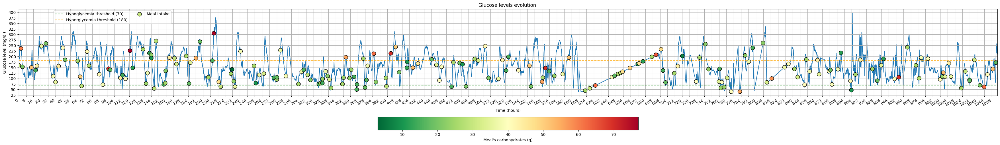

Normoglycemic records:  64.20208352539872 %


In [ ]:
# Ejemplo de dibujado de los datos de un archivo
root = xml_train_data['591-ws-training.xml']

glucose = root.find('glucose_level')
glucose_to_print = [event.attrib for event in list(glucose)]

meals = root.find('meal')
meals_to_print = [event.attrib for event in list(meals)]

draw_glucose(glucose_to_print, meals_to_print)
print('Normoglycemic records: ', normoglycemic_percentage(glucose_to_print), '%')

## Construcción de datos de entrenamiento

El primer reto de este trabajo está en la elaboración de ejemplos de entrenamiento a partir de los datos disponibles. Los datos nos vienen dados en archivos `.xml` con los registros de cada una de las variables. El objetivo final de los modelos que diseñemos será recomendar una dosis de insulina ante una ingesta. Siendo las ingestas el objeto fundamental del problema, es necesario construir ejemplos basándonos en estas ingestas y en toda su información asociada.

La función `build_examples` es la encargada de esta tarea. Las caracterísitcas que esta función permite incluir para cada ejemplo de entrenamiento son las sigueintes (siendo todas relativas a la ingesta concreta, salvo que se indiqu lo contrario):

- Media de pasos cada 5 minutos (de todos los registros del paciente)
- Nivel de glucosa
- Tendencia de glucosa
- Carbohidratos
- Tipo de ingesta
- Insulina basal
- Cantidad de sueño (de ese día)
- Calidad de sueño (de ese día)
- Duración de la jornada laboral (de ese día)
- Intensisdad física de la jornada laboral (de ese día)
- Eventos de estrés (de ese día)
- Eventos de enfermedad (de ese día)
- Duración del ejercicio realizado o por realizar (de ese día)
- Intensidad del ejercicio (de ese día)
- Pulsaciones
- GSR (Galvanic Skin Response)
- Temperatura de la piel
- Temperatura ambiente
- Insulina suministrada
- Tiempo de espera

Varias de estas variables no están directamente disponibles en la base de datos, sino que se requiere de un cálculo adicional:
- Media de pasos: requiere reecopilar todos los registros del paciente y computar la media.
- Tendencia de glucosa: se establece un umbral de tiempo y se calcula la variación de glucosa entre el momento de la ingesta y el momento `t_ingesta - t_umbral`.
- Insulina basal: se calcula la insulina basal activa en el momento de la ingesta y se añade la insulina basal temporal (si la hubiese en el momento de la ingesta).
- Tiempo de espera: se calcula la diferencia temporal entre la ingesta y el suministro de insulina.

También hay alguna información extra que se ha descartado:
- Nivel de glucosa (calculado mediante muestra de sangre): se descarta por redundancia con los niveles recogidos por la bomba de insulina.
- Tipo de suministro de insulina e intervalo de aplicación: Las bombas de insulina permiten diferentes modos de aplicación de insulina a parte del formato básico (inyectar todo de una vez). Estos modos son de utilidad para adaptarse a la naturaleza de los alimentos que se van a ingerir (por ejemplo, la unidad grasa-proteína o el índide glucémico). Debido a que la bbdd no contiene información de este tipo sobre los alimentos ni se especifica qué tipos de suministros hay disponibles, no tiene sentido contar con esta información en nuestros ejemplos de entrenamiento.
- Sueño: se utiliza sólo la calidad y duración introducida a mano por los pacientes en lugar de la recogida por las bandas de salud para simplificar la construcción de los ejemplos.
- Eventos de hipoglucemia: no se encuentra una utilidad clara de este dato para la predicción de dosis de insulina. La tendencia de glucosa y la glucosa en el momento de la ingesta tienen toda la información necesaria relacionada con la glucosa.

In [ ]:

# nombres de los campos que vamos a utilizar
field_names = [
    'id',
    'basis_steps',
    'glucose_level',
    'glucose_trend',
    'carbs',
    'type',
    'basal', # both basis and temporal
    'sleep_amount',
    'sleep_quality',
    'work_duration',
    'work_intensity',
    'stressors',
    'illness',
    'exercise_duration',
    'exercise_intensity',
    'basis_heart_rate',
    'basis_gsr', # galvanic skin response
    'basis_skin_temperature',
    'basis_air_temperature',
    # GOAL VARIABLES #
    'insulin_delivery_amount',
    'insilin_delivery_anticipation', # t between meal and insuline delivery
]

def get_value(data, meal_timestamp: str, keyword: str, field_name: str, timestamp_word: str = 'ts'):
  '''
  función que, dado un campo field_name, obtiene el el atributo keyword de dicho campo en data
  cuyo timestamp se acerque más a meal_timestamp

  data debe ser la lista de items xml

  usa búsqueda lineal para encontrar el valor más cercano a meal_timestamp
  '''
  best_diff = inf
  value = None
  for event in list(data.find(field_name)):
    diff = time_diff(meal_timestamp, event.attrib['ts'])
    if abs(diff) < abs(best_diff):
      best_diff = diff
      value = event.attrib[keyword]
  return value


def get_value_binary_search(
    data, meal_timestamp: str,
    keyword: str,
    field_name: str,
    timestamp_word: str = 'ts',
    strictly_before: bool = True
    ):
  '''
  función que, dado un campo field_name, obtiene el el atributo keyword de dicho campo en data
  cuyo timestamp se acerque más a meal_timestamp

  data debe ser la lista de items xml

  usa búsqueda binaria para encontrar el valor más cercano a meal_timestamp
  '''
  events = list(data.find(field_name))
  low = 0
  high = len(events) - 1
  closest_event = None
  min_diff = inf

  while low <= high:
    mid = (low + high) // 2
    diff = time_diff(meal_timestamp, events[mid].attrib[timestamp_word])
    if abs(diff) < min_diff:
      if strictly_before:
        if diff <= 0:# diff <= 0 cuz value has to be before the meal
          min_diff = abs(diff)
          closest_event = events[mid]
      else:
        min_diff = abs(diff)
        closest_event = events[mid]

    if diff < 0:  # meal_timestamp is later
      low = mid + 1
    else:  # meal_timestamp is before or equal
      high = mid - 1

  if closest_event == None:
    return None
  else:
    return closest_event.attrib[keyword]


def get_average_steps(data) -> float:
  total_steps = 0.0
  total_events = 0.0
  for event in data:
    total_steps += float(event.attrib['value'])
    total_events += 1.0
  return total_steps / total_events


def build_examples(filename: str | None = None, label: str = 'distance', fields: List | None = None) -> dict | list:
  '''
  función que construye ejemplos de entrenamiento. Si se le pasa el nombre de un archivo, serán los
  datos de ese archivo los que se procesarán y se devolverá una tupla con los ejemplos construidos donde
  el primer elemento es una lista con las características y el segundo una lista con las etiquetas.
  En caso contrario, se procesarán todos los archivos de entrenamiento disponibles en xml_train_data
  y se devolverá un diccionario donde cada llave corresponde a un archivo de entrenamiento y su
  correspondiente valor es una tupla como la descrita anteriormente con los ejemplos construidos.

  @param filename Nombre del archivo xml a procesar (None para procesar todo xml_train_data)
  @param label Tipo de etiqueta.
    'distance' -> distancia al umbral de normoglucemia
    'raw' -> valor de glucosa a las 2 horas de la ingesta
    'bool' -> etiqueta booleana, True para normoglucemia, False en caso contrario
  @param include_waiting_time Si True, incluye una segunda etiqueta que corresponde al tiempo de espera
'''
  hypo_threshold = 70 # hypoglycemia threshold
  hyper_threshold = 180 # hyperglycemia threshold
  post_meal_time = 2 # time after the meal used for defining the label, in hours
  glucose_trend_time = 0.5 # time before the meal used to compute the glucose tendency, in hours
  bolus_proximity_threshold = 0.33 # time threshold between a meal and an insulin intake for them to be associated

  if filename == None: # compute all training data
    training_examples = {}
    # -- iterate over each file --
    for file, data in xml_train_data.items():
      print('Processing ', file)
      # -- features --
      features = []
      # -- constant file features --
      id = None
      if fields and 'id' in fields:
        id = int(re.search('\d+', file).group()) # id

      avg_steps = None
      if fields and 'basis_steps' in fields:
        avg_steps = get_average_steps(data.find('basis_steps'))
      # -- labels --
      labels = []
      # -- iterate over each example (meal) --
      for meal in list(data.find('meal')):
        example_features = []
        example_labels = []

        # -- add constant file features --
        # id
        if fields and 'id' in fields:
          example_features.append(id)

        # daily average steps
        if fields and 'basis_steps' in fields:
          example_features.append(avg_steps)

        # -- add features --
        # current glucose
        if fields and 'glucose_level' in fields:
          val = get_value_binary_search(data, meal.attrib['ts'], 'value', 'glucose_level')
          if val:
            example_features.append(int(val))
          else:
            example_features.append(int(list(data.find('glucose_level'))[0].attrib['value']))

        # glucose trend
        if fields and 'glucose_trend' in fields:
          val1 = get_value_binary_search(data, meal.attrib['ts'], 'value', 'glucose_level')
          val2 = get_value_binary_search(data, shift_timestamp(meal.attrib['ts'], -glucose_trend_time), 'value', 'glucose_level', strictly_before=False)
          if val1 == None:
            val1 = list(data.find('glucose_level'))[0].attrib['value']
          if val2 == None:
            val2 = list(data.find('glucose_level'))[0].attrib['value']
          example_features.append(int(val1) - int(val2))

        # carbohydrates
        if fields and 'carbs' in fields:
          example_features.append(int(meal.attrib['carbs']))

        # meal type
        if fields and 'type' in fields:
          example_features.append(meal.attrib['type'])

        # basal aggregation
        if fields and 'basal' in fields:
          basal = get_value_binary_search(data, meal.attrib['ts'], 'value', 'basal')
          basal_ts = get_value_binary_search(data, meal.attrib['ts'], 'ts', 'basal')
          temp_basal_begin = get_value_binary_search(data, meal.attrib['ts'], 'ts_begin', 'temp_basal', 'ts_begin')
          temp_basal_end = get_value_binary_search(data, meal.attrib['ts'], 'ts_begin', 'temp_basal', 'ts_end')

          if basal == None or basal_ts == None:
            example_features.append(None)
          elif temp_basal_begin == None or temp_basal_end == None:
            example_features.append(float(basal))
          # check if temp_basal is superseeding basal
          elif time_diff(basal_ts, temp_basal_begin) >= 0 and time_diff(temp_basal_end, meal.attrib['ts']) >= 0:
            # temp basal is active
            temp_basal_value = get_value_binary_search(data, meal.attrib['ts'], 'value', 'temp_basal', 'ts_begin')
            if temp_basal_value != None and float(temp_basal_value) != 0:
              example_features.append(float(temp_basal_value) + float(basal))
            else:
              example_features.append(0)
          else:
            # no temp basal
            example_features.append(float(basal))

        # sleep amount and quality
        if fields and 'sleep_amount' in fields and 'sleep_quality' in fields:
          sleep_begin = get_value_binary_search(data, meal.attrib['ts'], 'ts_begin', 'sleep', 'ts_begin')
          if sleep_begin != None:
            sleep_end = get_value_binary_search(data, meal.attrib['ts'], 'ts_end', 'sleep', 'ts_begin')
            sleep_quality = get_value_binary_search(data, meal.attrib['ts'], 'quality', 'sleep', 'ts_begin')

            example_features.append(time_diff(sleep_begin, sleep_end))
            example_features.append(int(sleep_quality))
          else:
            example_features.append(None)
            example_features.append(None)

        # work duration and intensity
        if fields and 'work_duration' in fields and 'work_intensity' in fields:
          work_begin = get_value_binary_search(data, meal.attrib['ts'], 'ts_begin', 'work', 'ts_begin')
          if work_begin != None and is_same_day(meal.attrib['ts'], work_begin):
            work_end = get_value_binary_search(data, meal.attrib['ts'], 'ts_end', 'work', 'ts_begin')
            work_intensity = get_value_binary_search(data, meal.attrib['ts'], 'intensity', 'work', 'ts_begin')
            example_features.append(time_diff(work_begin, work_end))
            example_features.append(int(work_intensity))
          else:
            example_features.append(0)
            example_features.append(0)

        # stress. True if there is a stress event before the meal and the same day
        if fields and 'stressors' in fields:
          stress_begin = get_value_binary_search(data, meal.attrib['ts'], 'ts', 'stressors', 'ts')
          if stress_begin != None and is_same_day(meal.attrib['ts'], stress_begin) and time_diff(stress_begin, meal.attrib['ts']) >= 0:
            example_features.append(1)
          else:
            example_features.append(0)

        # whether the patient was ill while having the meal
        if fields and 'illness' in fields:
          illness_begin = get_value_binary_search(data, meal.attrib['ts'], 'ts_begin', 'illness', 'ts_begin')
          illness_end = get_value_binary_search(data, meal.attrib['ts'], 'ts_end', 'illness', 'ts_begin')
          if (illness_begin != None and illness_begin != ''
              and illness_end != None and illness_end != ''
              and time_diff(illness_begin, meal.attrib['ts']) >= 0
              and time_diff(meal.attrib['ts'], illness_end) >= 0):
            example_features.append(1)
          else:
            example_features.append(0)

        # exercise duration and intensity
        if fields and 'exercise_duration' in fields and 'exercise_intensity' in fields:
          exercise_ts = get_value_binary_search(data, meal.attrib['ts'], 'ts', 'exercise')
          if exercise_ts != None and is_same_day(meal.attrib['ts'], exercise_ts):
            example_features.append(int(get_value_binary_search(data, meal.attrib['ts'], 'duration', 'exercise')))
            example_features.append(int(get_value_binary_search(data, meal.attrib['ts'], 'intensity', 'exercise')))
          else:
            example_features.append(0)
            example_features.append(0)

        # heart rate
        if fields and 'basis_heart_rate' in fields:
          val = get_value_binary_search(data, meal.attrib['ts'], 'value', 'basis_heart_rate')
          if val:
            example_features.append(int(val))
          else:
            example_features.append(None)

        # galvanic skin response #TODO: float???
        if fields and 'basis_gsr' in fields:
          gsr = get_value_binary_search(data, meal.attrib['ts'], 'value', 'basis_gsr')
          if gsr:
            example_features.append(float(gsr))
          else:
            example_features.append(None)

        # skin temperature
        if fields and 'basis_skin_temperature' in fields:
          val = get_value_binary_search(data, meal.attrib['ts'], 'value', 'basis_skin_temperature')
          if val:
            example_features.append(float(val))
          else:
            example_features.append(None)

        # air temperature
        if fields and 'basis_air_temperature' in fields:
          val = get_value_binary_search(data, meal.attrib['ts'], 'value', 'basis_air_temperature')
          if val:
            example_features.append(float(val))
          else:
            example_features.append(None)

        # -- GOAL VARIABLES --
        if fields and 'insulin_delivery_amount':
          bolus_ts = get_value_binary_search(data, meal.attrib['ts'], 'ts_begin', 'bolus', 'ts_begin', False)
          if bolus_ts and abs(time_diff(meal.attrib['ts'], bolus_ts)) <= bolus_proximity_threshold:
            example_features.append(float(get_value_binary_search(data, meal.attrib['ts'], 'dose', 'bolus', 'ts_begin', False)))
          else:
            example_features.append(0.0)
        if fields and 'insilin_delivery_anticipation':
          bolus_ts = get_value_binary_search(data, meal.attrib['ts'], 'ts_begin', 'bolus', 'ts_begin', False)

          if bolus_ts:
            ts_diff = time_diff(meal.attrib['ts'], bolus_ts)
            if abs(ts_diff) <= bolus_proximity_threshold:
              example_features.append(ts_diff)
            else:
              example_features.append(0.0)
          else:
            example_features.append(0.0)
        # -- add labels --
        postmeal_glucose = get_value_binary_search(data, shift_timestamp(meal.attrib['ts'], post_meal_time), 'value', 'glucose_level')
        if postmeal_glucose:
          postmeal_glucose = int(postmeal_glucose)
        else:
          glucose_list = list(data.find('glucose_level'))
          postmeal_glucose = glucose_list[len(glucose_list)].attrib['value']

        if label == 'raw':
          example_labels.append(postmeal_glucose)
        elif label == 'distance':
          if postmeal_glucose > hyper_threshold:
            example_labels.append(postmeal_glucose - hyper_threshold)
          elif postmeal_glucose < hypo_threshold:
            example_labels.append(postmeal_glucose - hypo_threshold)
          else:
            example_labels.append(0)
        elif label == 'bool':
          example_labels.append(hypo_threshold <= postmeal_glucose <= hyper_threshold)
        else:
          raise ValueError(f'Invalid label: {label}')

        # -- add this example's features and labels to this file's examples --
        features.append(example_features)
        labels.append(example_labels)

      training_examples[file] = (features, labels)

    return training_examples
  else:
    print('FILENAME SPECIFIC CONSTRUCTION IS NOT IMPLEMENTED YET')
    return []


## Análisis de los datos

El objetivo del análisis de datos nos permite conocer mejor nuestros datos. En concreto, nos interesa:
- Detectar si hay muchos valores nulos.
- Detectar qué características podrían ser más o menos relevantes.


In [ ]:
# Construiremos dataframes para trabajar mejor con los datos
data_raw = build_examples(label='raw', fields=field_names)
data_binary = build_examples(label='bool', fields=field_names)
data_distance = build_examples(label='distance', fields=field_names)

def build_dataframe(data):
  '''
  Dado el diccionario devuelto por build_examples, construye dataframes

  @param data El valor devuelto por build_examples
  @return Un dataframe con los datos y sus etiquetas
  '''
  dataframes = {}

  for file, (x, y) in data.items():
    # Create a DataFrame for each file
    df_temp = pd.DataFrame(x)

    df_temp['label'] = [label[0] for label in y]
    df_temp.columns = field_names + ['label']

    dataframes[file] = df_temp

  return pd.concat([dataframe for dataframe in dataframes.values()], ignore_index=True)

# create a combined DataFrame
df_raw = build_dataframe(data_raw)
df_binary = build_dataframe(data_binary)
df_distance = build_dataframe(data_distance)

Processing  588-ws-training.xml
Processing  575-ws-training.xml
Processing  570-ws-training.xml
Processing  559-ws-training.xml
Processing  591-ws-training.xml
Processing  563-ws-training.xml
Processing  588-ws-training.xml
Processing  575-ws-training.xml
Processing  570-ws-training.xml
Processing  559-ws-training.xml
Processing  591-ws-training.xml
Processing  563-ws-training.xml
Processing  588-ws-training.xml
Processing  575-ws-training.xml
Processing  570-ws-training.xml
Processing  559-ws-training.xml
Processing  591-ws-training.xml
Processing  563-ws-training.xml


In [ ]:
df_raw

,id,basis_steps,glucose_level,glucose_trend,carbs,type,basal,sleep_amount,sleep_quality,work_duration,...,illness,exercise_duration,exercise_intensity,basis_heart_rate,basis_gsr,basis_skin_temperature,basis_air_temperature,insulin_delivery_amount,insilin_delivery_anticipation,label
0,588,2.291269,117,1,37,Lunch,1.20,NaN,NaN,0.000000,...,0,0,0,111.0,0.000067,92.30,91.22,5.1,0.082500,151
1,588,2.291269,100,-12,8,Snack,1.25,NaN,NaN,5.000000,...,0,0,0,82.0,0.000061,86.90,83.84,0.0,0.000000,77
2,588,2.291269,87,-11,70,Dinner,1.25,NaN,NaN,5.000000,...,0,0,0,88.0,0.000060,84.38,80.24,9.7,0.058056,79
3,588,2.291269,84,-1,30,Snack,1.25,NaN,NaN,5.000000,...,0,36,5,99.0,0.000062,85.10,80.60,0.0,0.000000,86
4,588,2.291269,81,-5,25,Snack,1.25,NaN,NaN,5.000000,...,0,36,5,79.0,0.000060,86.00,83.30,0.0,0.000000,97
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1086,563,4.748559,293,7,30,Dinner,0.80,-5.966667,2.0,8.833333,...,0,0,0,104.0,0.000082,88.70,83.48,6.0,0.054722,276
1087,563,4.748559,204,35,15,Breakfast,0.80,-5.966667,2.0,0.000000,...,0,0,0,94.0,0.000066,86.00,82.40,5.2,-0.120556,138
1088,563,4.748559,168,-15,35,Dinner,0.80,-5.966667,2.0,8.750000,...,0,0,0,92.0,0.002860,88.34,83.84,0.0,0.000000,136
1089,563,4.748559,135,4,53,Lunch,0.80,-5.966667,2.0,8.750000,...,0,0,0,105.0,0.000145,87.80,83.66,11.9,-0.049444,131


In [ ]:
df_binary

,id,basis_steps,glucose_level,glucose_trend,carbs,type,basal,sleep_amount,sleep_quality,work_duration,...,illness,exercise_duration,exercise_intensity,basis_heart_rate,basis_gsr,basis_skin_temperature,basis_air_temperature,insulin_delivery_amount,insilin_delivery_anticipation,label
0,588,2.291269,117,1,37,Lunch,1.20,NaN,NaN,0.000000,...,0,0,0,111.0,0.000067,92.30,91.22,5.1,0.082500,True
1,588,2.291269,100,-12,8,Snack,1.25,NaN,NaN,5.000000,...,0,0,0,82.0,0.000061,86.90,83.84,0.0,0.000000,True
2,588,2.291269,87,-11,70,Dinner,1.25,NaN,NaN,5.000000,...,0,0,0,88.0,0.000060,84.38,80.24,9.7,0.058056,True
3,588,2.291269,84,-1,30,Snack,1.25,NaN,NaN,5.000000,...,0,36,5,99.0,0.000062,85.10,80.60,0.0,0.000000,True
4,588,2.291269,81,-5,25,Snack,1.25,NaN,NaN,5.000000,...,0,36,5,79.0,0.000060,86.00,83.30,0.0,0.000000,True
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1086,563,4.748559,293,7,30,Dinner,0.80,-5.966667,2.0,8.833333,...,0,0,0,104.0,0.000082,88.70,83.48,6.0,0.054722,False
1087,563,4.748559,204,35,15,Breakfast,0.80,-5.966667,2.0,0.000000,...,0,0,0,94.0,0.000066,86.00,82.40,5.2,-0.120556,True
1088,563,4.748559,168,-15,35,Dinner,0.80,-5.966667,2.0,8.750000,...,0,0,0,92.0,0.002860,88.34,83.84,0.0,0.000000,True
1089,563,4.748559,135,4,53,Lunch,0.80,-5.966667,2.0,8.750000,...,0,0,0,105.0,0.000145,87.80,83.66,11.9,-0.049444,True


In [ ]:
df_distance

,id,basis_steps,glucose_level,glucose_trend,carbs,type,basal,sleep_amount,sleep_quality,work_duration,...,illness,exercise_duration,exercise_intensity,basis_heart_rate,basis_gsr,basis_skin_temperature,basis_air_temperature,insulin_delivery_amount,insilin_delivery_anticipation,label
0,588,2.291269,117,1,37,Lunch,1.20,NaN,NaN,0.000000,...,0,0,0,111.0,0.000067,92.30,91.22,5.1,0.082500,0
1,588,2.291269,100,-12,8,Snack,1.25,NaN,NaN,5.000000,...,0,0,0,82.0,0.000061,86.90,83.84,0.0,0.000000,0
2,588,2.291269,87,-11,70,Dinner,1.25,NaN,NaN,5.000000,...,0,0,0,88.0,0.000060,84.38,80.24,9.7,0.058056,0
3,588,2.291269,84,-1,30,Snack,1.25,NaN,NaN,5.000000,...,0,36,5,99.0,0.000062,85.10,80.60,0.0,0.000000,0
4,588,2.291269,81,-5,25,Snack,1.25,NaN,NaN,5.000000,...,0,36,5,79.0,0.000060,86.00,83.30,0.0,0.000000,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1086,563,4.748559,293,7,30,Dinner,0.80,-5.966667,2.0,8.833333,...,0,0,0,104.0,0.000082,88.70,83.48,6.0,0.054722,96
1087,563,4.748559,204,35,15,Breakfast,0.80,-5.966667,2.0,0.000000,...,0,0,0,94.0,0.000066,86.00,82.40,5.2,-0.120556,0
1088,563,4.748559,168,-15,35,Dinner,0.80,-5.966667,2.0,8.750000,...,0,0,0,92.0,0.002860,88.34,83.84,0.0,0.000000,0
1089,563,4.748559,135,4,53,Lunch,0.80,-5.966667,2.0,8.750000,...,0,0,0,105.0,0.000145,87.80,83.66,11.9,-0.049444,0


### Valores nulos

La única diferencia entre los dataframes que hemos construido está en su etiqueta, así que no hace falta que analicemos cada uno por separado.

In [ ]:
print(df_raw.isnull().sum())

id                                0
basis_steps                       0
glucose_level                     0
glucose_trend                     0
carbs                             0
type                              0
basal                             0
sleep_amount                     17
sleep_quality                    17
work_duration                     0
work_intensity                    0
stressors                         0
illness                           0
exercise_duration                 0
exercise_intensity                0
basis_heart_rate                 13
basis_gsr                        13
basis_skin_temperature           13
basis_air_temperature            13
insulin_delivery_amount           0
insilin_delivery_anticipation     0
label                             0
dtype: int64


Los valores nulos no serán un problema: a penas hay y en los campos en los que hay, tiene sentido usar métodos de imputación sencillos como la mediana

### Análisis estadísticos

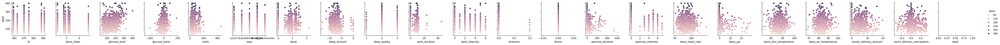

In [ ]:
sns.pairplot(df_raw, hue="label", y_vars=["label"], x_vars=df_raw.columns)

In [ ]:
def statistics(df):
    """
    Devuelve un DataFrame con estadísticas descriptivas clave:
    mínimo, media, mediana, máximo y desviación estándar.

    @param df (pd.DataFrame): DataFrame de entrada con valores numéricos.

    @return pd.DataFrame: DataFrame con una fila por estadística y columnas originales.
    """
    df_num = df.select_dtypes(include=['number'])

    values = pd.DataFrame({
        "Min": df_num.min(),
        "Avg": df_num.mean(),
        "Median": df_num.median(),
        "Max": df_num.max(),
        "Std": df_num.std()
    })

    return values.T

stats = statistics(df_raw)
stats

,id,basis_steps,glucose_level,glucose_trend,carbs,basal,sleep_amount,sleep_quality,work_duration,work_intensity,...,illness,exercise_duration,exercise_intensity,basis_heart_rate,basis_gsr,basis_skin_temperature,basis_air_temperature,insulin_delivery_amount,insilin_delivery_anticipation,label
Min,559.000000,2.291269,40.000000,-255.000000,0.000000,0.000000,-13.000000,1.000000,0.000000,0.000000,...,0.0,0.000000,0.000000,51.000000,0.000042,73.580000,68.720000,0.000000,-0.316389,40.000000
Avg,576.500458,3.087945,138.642530,-6.664528,42.524290,0.667003,-7.313160,2.538175,3.470593,1.386801,...,0.0,15.896425,0.962420,85.873840,0.857243,86.855575,83.065798,3.325481,0.012654,159.407883
Median,575.000000,2.910858,132.000000,-4.000000,35.000000,0.780000,-7.366667,3.000000,0.000000,0.000000,...,0.0,0.000000,0.000000,86.000000,0.000094,86.900000,82.760000,2.500000,0.000000,152.000000
Max,591.000000,4.748559,400.000000,186.000000,450.000000,2.160000,0.000000,3.000000,45.100000,6.000000,...,0.0,613.000000,7.000000,145.000000,28.000000,100.040000,100.580000,19.700000,0.326111,400.000000
Std,11.712956,0.692884,60.014972,30.325319,34.203628,0.457779,1.438545,0.576759,4.917699,1.988677,...,0.0,51.946879,2.008573,13.141712,3.279136,3.130323,3.660908,3.680160,0.091595,65.954234


Hay varios detalles interesantes que se extraen de estos análisis:
- Los gráficos que enfrentan cada característica con la etiqueta no muestran relaciones claras (al menos, no relaciones lineales directas entre las características y la etiqueta). Puede que sea una señal de que, como suponíamos, estamos ante un problema complejo.
- El campo `illness` no tiene ninguna variabilidad. Revisando la bbdd, resulta que los sujetos han marcado el inicio de los periodos de enfermedad pero no el final. Por tanto, esta característica no nos será de mucha utilidad, ya que es imposible saber qué ingestas tras el inicio de la enfermedad siguen estando bajo su efecto.
- Algunos campos muestran valores máximos y mínimos un poco desproporcionados. Por ejemplo, la tendencia de glucosa muestra un registro de -255 puntos en 30 minutos y la cantidad de carbohidratos tiene un máximo de 450, mucho mayor que la media. Esto nos habla de la posible existencia de outliers.

## Preprocesado de datos

El preprocesado de datos nos permitirá preparar el dataset para que pueda ser utilizado en el entrenamiento de modelos. Las tareas del preprocesado incluyen:
- Eliminación de columnas no deseadas.
- Imputación de valores nulos.
- Codificación de variables categóricas.
- Escalado de datos.

In [ ]:
# 1. eliminación de atributos
# crearemos un transformador específico para eliminar las features que nos interesen
unwanted_features = ['illness', 'id']

class FeatureDeleter(BaseEstimator, TransformerMixin):
  def __init__(self): # no *args or **kargs
      pass
  def fit(self, X, y=None):
      return self  # nothing else to do
  def transform(self, X): # eliminamos de nuestros datos las columnas que no nos interesan
      return X.drop(columns=unwanted_features)

# 2. Codificación. El campo 'type', que representa el tipo de comida, no puede tener un orden asociado debido a los tipos snack y hypo correction, que pueden darse
# indistintamente entre el resto de comidas del día. Por tanto, se codificarán mediante one hot encoding, ya que tampoco hay tantas opciones como para preocuparnos
# por el aumento en la dimensionalidad del problema
non_ordinal_features = ['type']

categorical_management = ColumnTransformer([
    ("non_ordinal", OneHotEncoder(drop='first'), non_ordinal_features)# codificar variables categóricas que no tienen relación de orden
    ],
    remainder='passthrough'
    )

# 3. Imputación de valores nulos y escalado de los datos. La mediana es un sistema de imputación sólido.
# el escalado estándar es fundamental para la eficacia del entrenamiento
common_preprocessing_steps = Pipeline([
    ('simple_imputer', SimpleImputer(strategy = 'median')),
    ('standard_scaler', StandardScaler())
])

full_pipeline = Pipeline([
    ('feature_deleter', FeatureDeleter()),
    ('categorical_management', categorical_management),
    ('common_preprocessing_steps', common_preprocessing_steps)
])

In [ ]:
# Separamos las etiquetas de las características de los dataframes. Al ser la etiqueta lo único que diferencia a los dataframes,
# acabaremos teniendo un df para cada tipo de etiqueta y un df común con las características
df_label_raw = df_raw['label']
df_label_binary = df_binary['label']
df_label_distance = df_distance['label']

separated_ids_labels_raw = {}
for unique_id in df_raw['id'].unique():
  separated_ids_labels_raw[unique_id] = df_label_raw[df_raw['id'] == unique_id].values


df_raw.pop('label')
df_binary.pop('label')
df_distance.pop('label')
# antes de preprocesar, aprovechamos que tenemos las etiquetas para crear DataFrames específicos de cada archivo
id_separated_dfs = {}
for unique_id in df_raw['id'].unique():
  id_separated_dfs[unique_id] = df_raw[df_raw['id'] == unique_id]

all_ids_features_prepared = full_pipeline.fit_transform(df_raw) # estos son los datos ya preprocesados!

separated_ids_features_prepared = {}
for unique_id, df in id_separated_dfs.items():
  separated_ids_features_prepared[unique_id] = full_pipeline.fit_transform(df) # datos preprocesados por separado (según id)!

In [ ]:
print(all_ids_features_prepared.shape)
print(np.isnan(all_ids_features_prepared).sum())
print(list(separated_ids_features_prepared.values())[0].shape)
# check that the sum of all individual examples matches the complete example set
print(reduce((lambda a, b : a + b), [item.shape[0] for item in list(separated_ids_features_prepared.values())]))

(1091, 22)
0
(221, 22)
1091


### Detección de outliers

La detección de outliers nos permite averiguar si hay anomalías en nuestros datos de entrenamiento. Que un dato sea anómalo no necesariamente significa que sea erróneo, pues a veces hay casos reales que son extremos. Sin embargo, algunos modelos pueden perder eficacia al tratar de ajustarse a este tipo de ejemplos, ya que sus características son muy distintas a la del resto.

Vamos a utilizar un Isolation Forest para investigar la posible existencia de outliers en nuestro dataset. Un Isolation Forest es un algoritmo de aprendizaje automático no supervisado que se utiliza para la detección de anomalías o valores atípicos. Funciona aislando las observaciones mediante la construcción aleatoria de árboles de decisión. Las observaciones que son fáciles de aislar, es decir, que requieren menos divisiones en el árbol, son consideradas anomalías.

In [ ]:
isft = IForest(contamination=0.01, behaviour='new')

isft.fit(all_ids_features_prepared)

# Training data
outlier_scores = isft.decision_function(all_ids_features_prepared)
outlier_preds = isft.predict(all_ids_features_prepared)

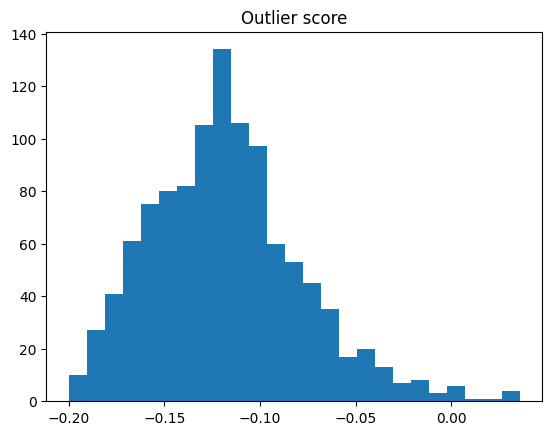

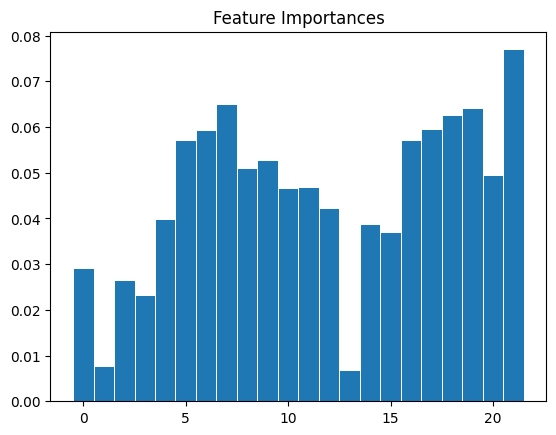

,Group,Count,Count %,0,1,2,3,4,5,6,...,13,14,15,16,17,18,19,20,21,Anomaly_Score
0,Normal,1080,98.991751,0.003,-0.012,0.003,-0.005,0.005,0.001,0.007,...,-0.030,-0.009,-0.021,-0.011,-0.023,0.010,0.009,0.004,0.002,-0.119
1,Outlier,11,1.008249,-0.334,1.188,-0.306,0.474,-0.523,-0.140,-0.674,...,2.924,0.842,2.056,1.110,2.294,-0.957,-0.843,-0.388,-0.180,0.016


In [ ]:
# Análisis de los resultados
plt.hist(outlier_scores, bins='auto')
plt.title("Outlier score")
plt.show()

isft_vi = isft.feature_importances_

fig, ax = plt.subplots()
ax.bar(range(all_ids_features_prepared.shape[1]), isft_vi, width=1, edgecolor="white", linewidth=0.7)
ax.set_title("Feature Importances")
plt.show()

threshold = isft.threshold_

def descriptive_stat_threshold(df,pred_score, threshold):
    # Let's see how many '0's and '1's.
    df = pd.DataFrame(df)
    df['Anomaly_Score'] = pred_score
    df['Group'] = np.where(df['Anomaly_Score']< threshold, 'Normal', 'Outlier')

    # Now let's show the summary statistics:
    cnt = df.groupby('Group')['Anomaly_Score'].count().reset_index().rename(columns={'Anomaly_Score':'Count'})
    cnt['Count %'] = (cnt['Count'] / cnt['Count'].sum()) * 100 # The count and count %
    stat = df.groupby('Group').mean().round(3).reset_index() # The avg.
    stat = cnt.merge(stat, left_on='Group',right_on='Group') # Put the count and the avg. together
    return (stat)

descriptive_stat_threshold(all_ids_features_prepared,outlier_scores, threshold) #y_train_scores = isft.decision_scores_

Dadas las gráficas y los resultados estadísticos, podemos decir que prácticamente no hay outliers en nuestro dataset o que, en caso de haberlos, tampoco son tan distintos a los ejemplos normales. Esto se ve especialmente bien en el histograma de puntuación de outliers, donde se puede apreciar que los datos se agrupan en un intervalo realmente pequeño.

En este experimento, hemos colocado un umbral correspondiente a un 1% de outliers y aún así se aprecia que la diferencia entre las instancias etiquetadas con 1 y con 0 no se diferencian tanto. Por ello, podemos considerar que no hay incentivo para tratar de aislar estos outliers.

## Experimentos y entrenamiento de modelos

### Funciones de construcción y evaluación

In [ ]:
def split_classification(features, labels):
  '''
  Genera particiones de entrenamiento y validación para clasificación
  '''
  return train_test_split(
    features,
    labels,
    test_size=0.15,
    shuffle=True,
    stratify=labels
  )

def split_regression(features, labels):
  '''
  Genera particiones de entrenamiento y validación para regresión
  '''
  return train_test_split(
    features,
    labels,
    test_size=0.15,
    shuffle=True
  )

# función para mostrar la puntuación roc (https://drivendata.co/blog/predict-flu-vaccine-data-benchmark/)
def plot_roc(y_true, y_score, title, ax):
  fpr, tpr, thresholds = roc_curve(y_true, y_score)
  ax.plot(fpr, tpr)
  ax.plot([0, 1], [0, 1], color='grey', linestyle='--')
  ax.set_ylabel('TPR')
  ax.set_xlabel('FPR')
  ax.set_title(
      f"{title}: AUC = {roc_auc_score(y_true, y_score):.4f}"
  )
  plt.show()

def plot_confusion_matrix(y_true, y_pred,title):
  cm = confusion_matrix(y_true, y_pred)
  disp = ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=np.unique(y_true))
  disp.plot(cmap=plt.cm.Blues, colorbar=False)
  ax.set_title(f'Matriz de Confusión: {title}')
  plt.show()

def plot_classification_metrics(y_true, y_pred, title, binary):
  a = accuracy_score(y_true, y_pred)
  if binary:
    p = precision_score(y_true, y_pred)
    r = recall_score(y_true, y_pred)
    f1 = f1_score(y_true, y_pred, average="micro")

  print(f'Evaluation metrics for {title}')
  print(f'Accuracy: {a}')
  if binary:
    print(f'Precision: {p}')
    print(f'Recall: {r}')
    print(f'F1 Score: {f1}')
    return [a, p, r, f1]
  else:
    return a

def evaluate_classification(y_true, y_pred, title, binary=False):
  if binary:
    plot_roc(y_true, y_pred, title, plt.gca())
  plot_confusion_matrix(y_true, y_pred, title)
  return plot_classification_metrics(y_true, y_pred, title, binary)

def plot_regression_metrics(y_true, y_preds, title):
  mse = mean_squared_error(y_true, y_preds)
  rmse = math.sqrt(mse)
  r2 = r2_score(y_true, y_preds)
  mae = mean_absolute_error(y_true, y_preds)
  mape = mean_absolute_percentage_error(y_true, y_preds)

  print(f'Evaluation metrics for {title}')
  print(f'MSE: {mse}')
  print(f'RMSE: {rmse}')
  print(f'R2: {r2}')
  print(f'MAE: {mae}')
  print(f'MAPE: {mape}')

  return [mse, rmse, r2, mae, mape]

def plot_regression_results(y_true, y_preds, title):
  x = np.arange(len(y_true))
  plt.figure(figsize=(30, 6))
  plt.plot(x, y_true, label='Valores reales', linestyle='-', marker='o')
  plt.plot(x, y_preds, label='Predicciones', linestyle='--', marker='x')
  plt.title('Comparación entre valores reales y predichos')
  plt.xlabel('Índice')
  plt.ylabel('Valor')
  plt.legend()
  plt.grid(True)
  plt.tight_layout()
  plt.show()

def evaluate_regression(y_true, y_preds, title):
  plot_regression_results(y_true, y_preds, title)

  return plot_regression_metrics(y_true, y_preds, title)

def calculate_suitable_insulin(model, example, min=0.0, max=20.0, step=0.1, plot_result = False):
  '''
  Función que calcula el rango de valores de insulina recomendados según un modelo para un ejemplo concreto.
  También puede dibujar un gráfico.
  '''
  insulin_values = np.arange(min, max, step)
  df = example
  rows = []
  for value in insulin_values: # get all possible insulin values
    row = example.copy()
    row['insulin_delivery_amount'] = value
    rows.append(row)

  rows = pd.concat(rows, ignore_index=True)

  X = full_pipeline.transform(rows)
  predicted_outcome = model.predict(X)

  plt.figure(figsize=(8, 6))
  plt.plot(insulin_values, predicted_outcome)
  plt.xlabel("Insuline dose")
  plt.ylabel("Predicted Outcome")
  plt.title("Insulin dose - Predicted outcome")
  plt.grid(True)
  plt.show()

  return predicted_outcome

In [ ]:
'''
CLARKE ERROR GRID ANALYSIS      ClarkeErrorGrid.py

Need Matplotlib Pyplot


The Clarke Error Grid shows the differences between a blood glucose predictive measurement and a reference measurement,
and it shows the clinical significance of the differences between these values.
The x-axis corresponds to the reference value and the y-axis corresponds to the prediction.
The diagonal line shows the prediction value is the exact same as the reference value.
This grid is split into five zones. Zone A is defined as clinical accuracy while
zones C, D, and E are considered clinical error.

Zone A: Clinically Accurate
    This zone holds the values that differ from the reference values no more than 20 percent
    or the values in the hypoglycemic range (<70 mg/dl).
    According to the literature, values in zone A are considered clinically accurate.
    These values would lead to clinically correct treatment decisions.

Zone B: Clinically Acceptable
    This zone holds values that differe more than 20 percent but would lead to
    benign or no treatment based on assumptions.

Zone C: Overcorrecting
    This zone leads to overcorrecting acceptable BG levels.

Zone D: Failure to Detect
    This zone leads to failure to detect and treat errors in BG levels.
    The actual BG levels are outside of the acceptable levels while the predictions
    lie within the acceptable range

Zone E: Erroneous treatment
    This zone leads to erroneous treatment because prediction values are opposite to
    actual BG levels, and treatment would be opposite to what is recommended.


SYNTAX:
        plot, zone = clarke_error_grid(ref_values, pred_values, title_string)

INPUT:
        ref_values          List of n reference values.
        pred_values         List of n prediciton values.
        title_string        String of the title.

OUTPUT:
        plot                The Clarke Error Grid Plot returned by the function.
                            Use this with plot.show()
        zone                List of values in each zone.
                            0=A, 1=B, 2=C, 3=D, 4=E

EXAMPLE:
        plot, zone = clarke_error_grid(ref_values, pred_values, "00897741 Linear Regression")
        plot.show()

References:
[1]     Clarke, WL. (2005). "The Original Clarke Error Grid Analysis (EGA)."
        Diabetes Technology and Therapeutics 7(5), pp. 776-779.
[2]     Maran, A. et al. (2002). "Continuous Subcutaneous Glucose Monitoring in Diabetic
        Patients" Diabetes Care, 25(2).
[3]     Kovatchev, B.P. et al. (2004). "Evaluating the Accuracy of Continuous Glucose-
        Monitoring Sensors" Diabetes Care, 27(8).
[4]     Guevara, E. and Gonzalez, F. J. (2008). Prediction of Glucose Concentration by
        Impedance Phase Measurements, in MEDICAL PHYSICS: Tenth Mexican
        Symposium on Medical Physics, Mexico City, Mexico, vol. 1032, pp.
        259261.
[5]     Guevara, E. and Gonzalez, F. J. (2010). Joint optical-electrical technique for
        noninvasive glucose monitoring, REVISTA MEXICANA DE FISICA, vol. 56,
        no. 5, pp. 430434.


Made by:
Trevor Tsue
7/18/17

Based on the Matlab Clarke Error Grid Analysis File Version 1.2 by:
Edgar Guevara Codina
codina@REMOVETHIScactus.iico.uaslp.mx
March 29 2013
'''


#This function takes in the reference values and the prediction values as lists and returns a list with each index corresponding to the total number
#of points within that zone (0=A, 1=B, 2=C, 3=D, 4=E) and the plot
def clarke_error_grid(ref_values, pred_values, title_string):

    #Checking to see if the lengths of the reference and prediction arrays are the same
    assert (len(ref_values) == len(pred_values)), "Unequal number of values (reference : {}) (prediction : {}).".format(len(ref_values), len(pred_values))

    #Checks to see if the values are within the normal physiological range, otherwise it gives a warning
    if max(ref_values) > 400 or max(pred_values) > 400:
        print("Input Warning: the maximum reference value {} or the maximum prediction value {} exceeds the normal physiological range of glucose (<400 mg/dl).".format(max(ref_values), max(pred_values)))
    if min(ref_values) < 0 or min(pred_values) < 0:
        print("Input Warning: the minimum reference value {} or the minimum prediction value {} is less than 0 mg/dl.".format(min(ref_values),  min(pred_values)))

    #Clear plot
    plt.clf()

    #Set up plot
    plt.scatter(ref_values, pred_values, marker='o', color='black', s=8)
    plt.title(title_string + " Clarke Error Grid")
    plt.xlabel("Reference Concentration (mg/dl)")
    plt.ylabel("Prediction Concentration (mg/dl)")
    plt.xticks([0, 50, 100, 150, 200, 250, 300, 350, 400])
    plt.yticks([0, 50, 100, 150, 200, 250, 300, 350, 400])
    plt.gca().set_facecolor('white')

    #Set axes lengths
    plt.gca().set_xlim([0, 400])
    plt.gca().set_ylim([0, 400])
    plt.gca().set_aspect((400)/(400))

    #Plot zone lines
    plt.plot([0,400], [0,400], ':', c='black')                      #Theoretical 45 regression line
    plt.plot([0, 175/3], [70, 70], '-', c='black')
    #plt.plot([175/3, 320], [70, 400], '-', c='black')
    plt.plot([175/3, 400/1.2], [70, 400], '-', c='black')           #Replace 320 with 400/1.2 because 100*(400 - 400/1.2)/(400/1.2) =  20% error
    plt.plot([70, 70], [84, 400],'-', c='black')
    plt.plot([0, 70], [180, 180], '-', c='black')
    plt.plot([70, 290],[180, 400],'-', c='black')
    # plt.plot([70, 70], [0, 175/3], '-', c='black')
    plt.plot([70, 70], [0, 56], '-', c='black')                     #Replace 175.3 with 56 because 100*abs(56-70)/70) = 20% error
    # plt.plot([70, 400],[175/3, 320],'-', c='black')
    plt.plot([70, 400], [56, 320],'-', c='black')
    plt.plot([180, 180], [0, 70], '-', c='black')
    plt.plot([180, 400], [70, 70], '-', c='black')
    plt.plot([240, 240], [70, 180],'-', c='black')
    plt.plot([240, 400], [180, 180], '-', c='black')
    plt.plot([130, 180], [0, 70], '-', c='black')

    #Add zone titles
    plt.text(30, 15, "A", fontsize=15)
    plt.text(370, 260, "B", fontsize=15)
    plt.text(280, 370, "B", fontsize=15)
    plt.text(160, 370, "C", fontsize=15)
    plt.text(160, 15, "C", fontsize=15)
    plt.text(30, 140, "D", fontsize=15)
    plt.text(370, 120, "D", fontsize=15)
    plt.text(30, 370, "E", fontsize=15)
    plt.text(370, 15, "E", fontsize=15)

    #Statistics from the data
    zone = [0] * 5
    for i in range(len(ref_values)):
        if (ref_values[i] <= 70 and pred_values[i] <= 70) or (pred_values[i] <= 1.2*ref_values[i] and pred_values[i] >= 0.8*ref_values[i]):
            zone[0] += 1    #Zone A

        elif (ref_values[i] >= 180 and pred_values[i] <= 70) or (ref_values[i] <= 70 and pred_values[i] >= 180):
            zone[4] += 1    #Zone E

        elif ((ref_values[i] >= 70 and ref_values[i] <= 290) and pred_values[i] >= ref_values[i] + 110) or ((ref_values[i] >= 130 and ref_values[i] <= 180) and (pred_values[i] <= (7/5)*ref_values[i] - 182)):
            zone[2] += 1    #Zone C
        elif (ref_values[i] >= 240 and (pred_values[i] >= 70 and pred_values[i] <= 180)) or (ref_values[i] <= 175/3 and pred_values[i] <= 180 and pred_values[i] >= 70) or ((ref_values[i] >= 175/3 and ref_values[i] <= 70) and pred_values[i] >= (6/5)*ref_values[i]):
            zone[3] += 1    #Zone D
        else:
            zone[1] += 1    #Zone B

    return plt, zone

### Establecer una baseline

Primero, entrenaremos modelos muy sencillos para obtener una baseline. A partir de ella, podemos colocar un listón que marque "lo mínimo a lo que deben aspirar el resto de modelos".

In [ ]:
x_train_binary, x_eval_binary, y_train_binary, y_eval_binary = split_classification(all_ids_features_prepared, df_label_binary)
x_train_raw, x_eval_raw, y_train_raw, y_eval_raw = split_regression(all_ids_features_prepared, df_label_raw)
x_train_distance, x_eval_distance, y_train_distance, y_eval_distance = split_regression(all_ids_features_prepared, df_label_distance)
print(x_train_binary.shape)
print(x_eval_binary.shape)
print(y_train_binary.shape)
print(y_eval_binary.shape)

(927, 22)
(164, 22)
(927,)
(164,)


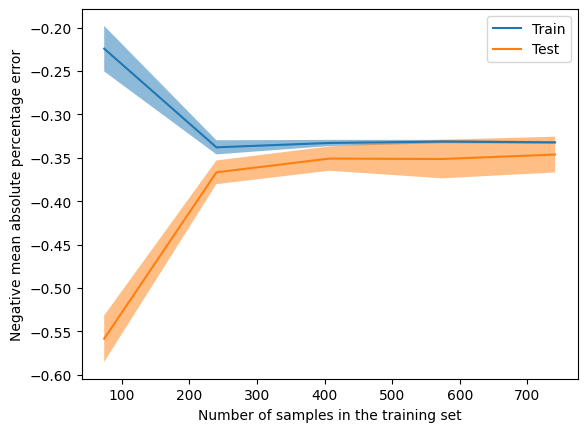

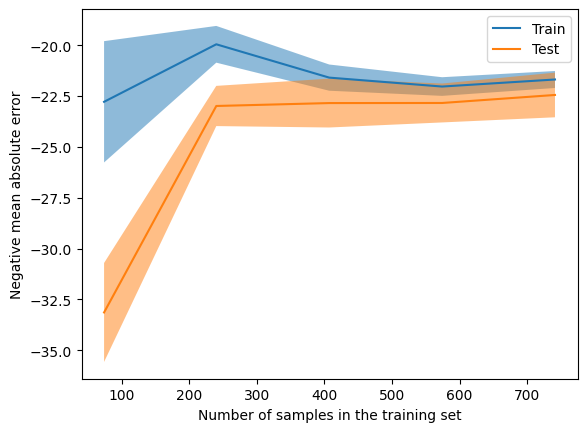

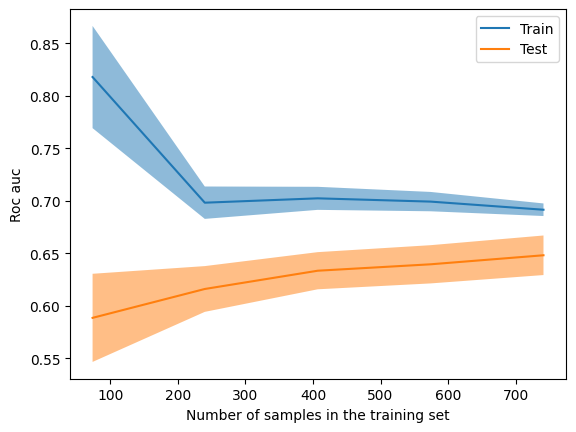

In [ ]:
lin_reg_raw = LinearRegression()
LearningCurveDisplay.from_estimator(lin_reg_raw, x_train_raw, y_train_raw, cv=5, scoring='neg_mean_absolute_percentage_error')
lin_reg_raw.fit(x_train_raw, y_train_raw)
y_preds_raw = lin_reg_raw.predict(x_eval_raw)

lin_reg_distance = LinearRegression()
LearningCurveDisplay.from_estimator(lin_reg_distance, x_train_distance, y_train_distance, cv=5, scoring='neg_mean_absolute_error')
lin_reg_distance.fit(x_train_distance, y_train_distance)
y_preds_distance = lin_reg_distance.predict(x_eval_distance)

log_reg_binary = LogisticRegression()
LearningCurveDisplay.from_estimator(log_reg_binary, x_train_binary, y_train_binary, cv=5, scoring='roc_auc')
log_reg_binary.fit(x_train_binary, y_train_binary)
y_preds_binary = log_reg_binary.predict(x_eval_binary)

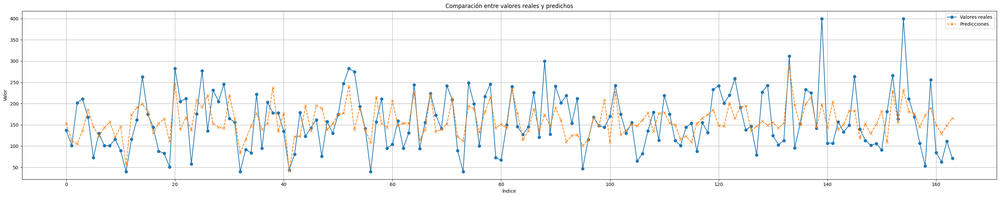

Evaluation metrics for raw
MSE: 3276.389803819841
RMSE: 57.23975719567511
R2: 0.29639073814419636
MAE: 45.822936659191825
MAPE: 0.3721861882074065


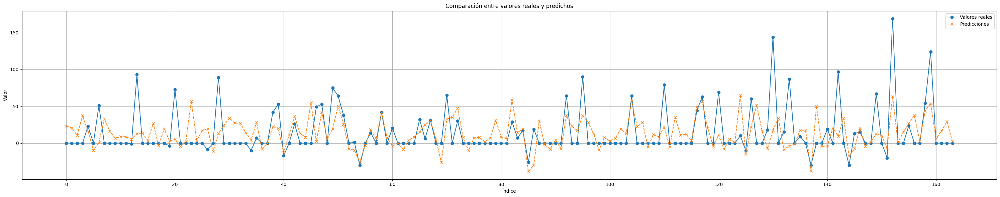

Evaluation metrics for distance
MSE: 860.9142007763304
RMSE: 29.34133945095776
R2: 0.11136525873438552
MAE: 20.046058496813334
MAPE: 4.100042827089546e+16


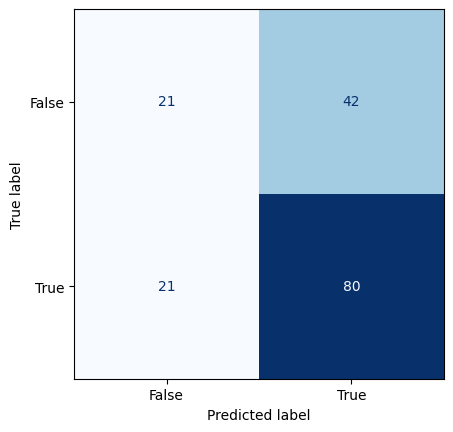

Evaluation metrics for binary
Accuracy: 0.6158536585365854


0.6158536585365854

In [ ]:
y_preds_raw = lin_reg_raw.predict(x_eval_raw)
y_preds_distance = lin_reg_distance.predict(x_eval_distance)
y_preds_binary = log_reg_binary.predict(x_eval_binary)

evaluate_regression(y_eval_raw, y_preds_raw, 'raw')
evaluate_regression(y_eval_distance, y_preds_distance, 'distance')
evaluate_classification(y_eval_binary, y_preds_binary, 'binary')

Ejemplo de recomendación de insulina para el primer ejemplo del dataset:

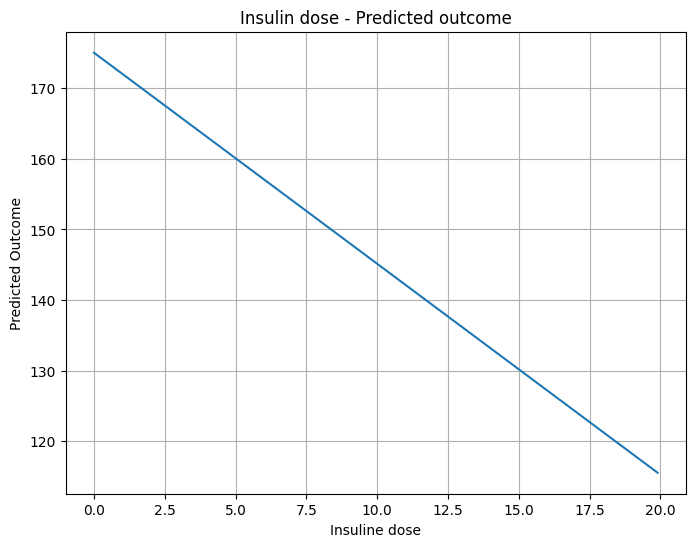

In [ ]:
example_raw = df_raw.iloc[[0]]
full_pipeline.fit(df_raw)
_ = calculate_suitable_insulin(lin_reg_raw, example_raw, plot_result=True)

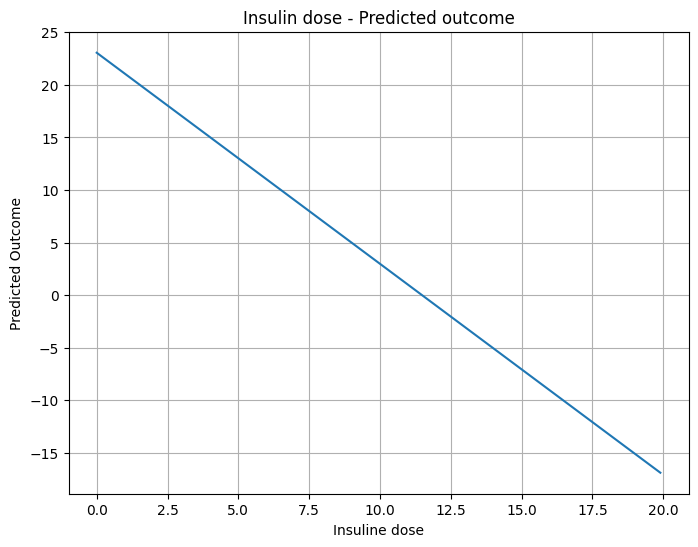

In [ ]:
example_distance = df_distance.iloc[[0]]
full_pipeline.fit(df_distance)
_ = calculate_suitable_insulin(lin_reg_distance, example_distance, plot_result=True)

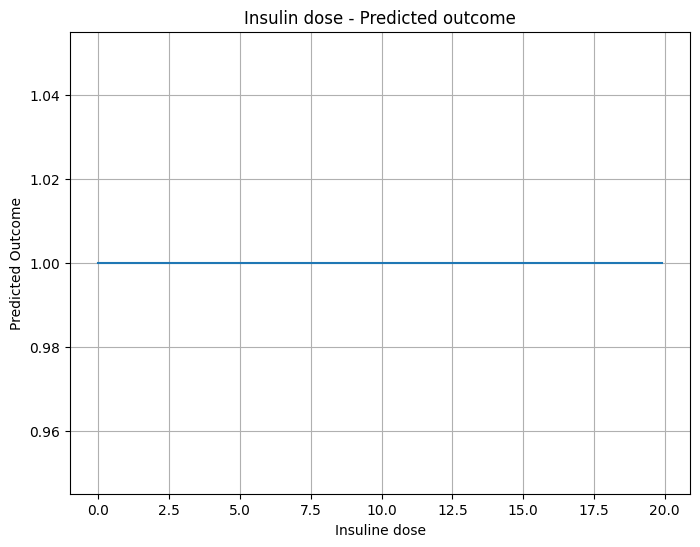

In [ ]:
example_binary = df_binary.iloc[[0]]
full_pipeline.fit(df_binary)
_ = calculate_suitable_insulin(log_reg_binary, example_binary, plot_result=True)

Tal y como se podía preveer, los resultados no son muy buenos. En general, todos los modelos tienden a dar predicciones que se parecen bastante a la media: los de regresión fallan principalmente los casos en los que la glucemia es muy baja o muy alta y el modelo de clasificación tiene una accuracy del 67% en un problema de clasificación binaria en el que la distribución de clases es de alrededor del 65% positivas y 35% negativas...

Las curvas de aprendizaje parecen indicar que los modelos sufren más de sesgo que de varianza. Probar con modelos más complejos es el siguiente paso lógico.

### Reflexión tras el establecimiento de la baseline

El objetivo final de los modelos entrenados es recomendar dosis de insulina. Dadas las características de los datos en los que los modelos son entrenados, estas recomendaciones se hacen de forma indirecta. En lugar de obtener directamente el valor de insulina recomendado, se debe realizar una especie de simulación para cada caso en el que el modelo realiza una predicción con diferenttes valores posibles de insulina. Tras ello, se obtiene un cierto rango de valores para los que el modelo estima que el usuario mantendrá niveles estables de glucosa.

Se han estado entrenando los modelos en tres datasets distintos:
1. Dataset "raw" en el que los modelos predicen exactamente el valor de glucosa que el paciente tendrá a las 2h de la ingesta.
2. Dataset "distance" donde la predicción es la distancia entre el valor de glucosa del paciente y el rango de normoglucemia.
3. Dataset "binary" en el que el modelo predice positivo o negativo según estime que el paciente estará en normoglucemia o no, respectivamente.

Obtener un valor único de insulina, que sería al fin y al cabo el objeto final del modelo, es un paso extra que debe ser pensado detenidamente. Por ejemplo, un modelo podría predecir que dosis entre 2 y 10 unidades de insulina mantienen al paciente en rango. Dentro de este rango, ¿qué valor se debe dar como recomendación final? Una idea sería un valor central, como 6. Pero, en realidad, quizá lo más sensato sea dar aquel valor que tenga más margen de error. Por ejemplo, un modelo puede calcular que 6 unidades de insulina mantienen la paciente en rango, pero no es lo mismo que se mantenga a 176 de glucosa que a 120. En el segundo caso, un pequeño error en la precisión de los cálculos tiene mucho margen tanto por encima como por debajo, ya que valores entre 70 y 180 se consideran adecuados tras una ingesta. En el primer caso, un pequeño error puede provocar una ligera hiperglucemia en el paciente. Para realizar este tipo de cálculos, es necesario que la predicción del modelo sea suficientemente interpretable.

Los modelos entrenados con el dataset "binary" no ofrecen esta posibilidad, puesto que su respuesta es simplemente "sí" o "no". No hay manera de saber cuánto margen de error tienen las predicciones. El % de confianza con el que el modelo clasifica el ejemplo en la clase positiva o negativa no necesariamente habla del valor de glucosa asociado a ese ejemplo concreto. Los modelos entrenados con el dataset "distance" tienen un problema semejante. La forma en la que dicen que un paciente queda en rango es respondiendo un valor muy cercano a 0. Pero, de nuevo, ese 0 significa que el paciente acaba en normoglucemia, pero no hay forma de saber con qué margen de error. Además, los modelos de este tipo difícilmente responden con un 0.0 exacto, lo que supone otro problema: ¿cuánta cercanía al 0.0 se considera un caso en el que el paciente acaba en situación de normoglucemia? ¿1.5 se considera normoglucémico? ¿Y -3.7?

Es por esto por lo que usar el dataset raw es más práctico, ya que se obtiene directamente la predicción sobre el nivel de glucosa de los pacientes tras la ingesta. Con esta información, se puede sugerir al paciente el valor de insulina con el que el modelo estima que quedaría en un valor de glucosa con mucho margen de error, como 120. Además, en caso de tener suficiente confianza en el modelo, se podría incluso ofrecer la posibilidad de que el modelo recomiende un valor de insulina con el que el paciente queda en un valor concreto de glucosa. Por ejemplo, un paciente podría querer reducir el riesgo de hipoglucemia porque va a estar en un contexto en el que le es difícil o incómodo comer (en una excursión, trabajando, etc). En ese caso, podría pedirle al modelo la cantidad de insulina con la que se quede a 160 puntos de glucosa.

### Eleción de modelos

Todos los experimentos mostrados a continuación incluiran el entrenamiento y evaluación de los siguientes modelos:
1. TabNet: red neuronal que ha demostrado un gran rendmiento para datos tabulares incluso cuando el tamaño del dataset no es demasiado eelevado. Además, ofrece explicabilidad.
2. SVM . Modelo clásico que ha demostrado ser muy útil en datasets pequeños.
3. RandomForest: Robusto, eficaz y ofrece explicabilidad.
4. XGBoost, por ser uno de los modelos más ganadores en benchmarks de problemas de aprendizaje automático tabulares.
5. TabPFN: modelo de fácil uso y muy reciente que ha demostrado ser tan bueno o más que otros modelos del estado del arte para tareas con datos tabulares.

In [ ]:
all_scores = {} # guardaremos los resultados de todos los experimentos para compararlos fácilmente

### Experimento 1: Modelos de aplicación global y fácil uso.

La mejor solución a la que puede aspirar este proyecto sería la obtención de un modelo que pueda hacer buenas recomendaciones a cualquier paciente. Además, en un caso ideal, no haría falta que los pacientes tuvieran acceso a variables poco accesibles como la GSR, las pulsaciones por minuto o la temperatura ambiente y corporal. Por tanto, los modelos que ahora se entrenarán:
- Usarán el dataset completo.
- Prescindirán de las variables más difíciles de obtener para pacientes en la vida real.
- Tratarán de obtener recomendaciones para cualquier paciente.

In [ ]:
# 1. determinar las variables que no queremos:
unwanted_features = [
  'illness',
  'id',
  'basis_steps',
  'basis_gsr',
  'basis_skin_temperature',
  'basis_air_temperature'
]

# 2. pasar la pipeline
all_ids_features_prepared = full_pipeline.fit_transform(df_raw)

# 3. separación de datos
x_train_exp1, x_eval_exp1, y_train_exp1, y_eval_exp1 = split_regression(all_ids_features_prepared, df_label_raw)
y_train_exp1 = y_train_exp1.values.reshape(-1, 1)
y_eval_exp1 = y_eval_exp1.values.reshape(-1, 1)


# 4. nombres de las variables usadas
feature_names_exp1 = full_pipeline[1:].get_feature_names_out()

# 5. mezclador de ejemplos para CV
cv = StratifiedKFold(n_splits=5, shuffle=True, random_state=42)

#### TabPFN

tabpfn-v2-regressor.ckpt:   0%|          | 0.00/44.4M [00:00<?, ?B/s]

config.json:   0%|          | 0.00/37.0 [00:00<?, ?B/s]

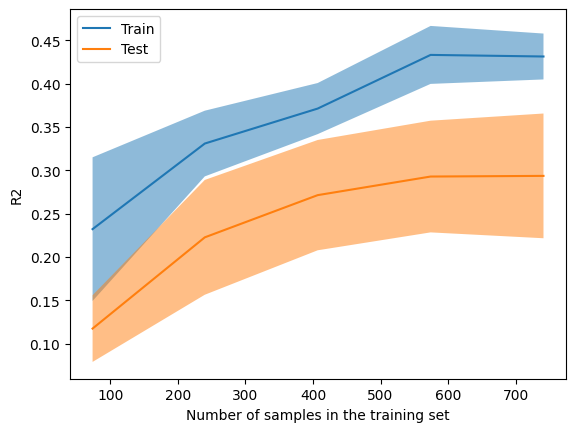

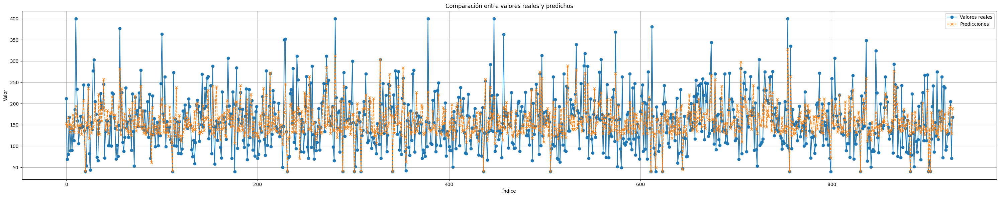

Evaluation metrics for AutoTabPFN performance in training
MSE: 2445.767822265625
RMSE: 49.45470475359877
R2: 0.44364404678344727
MAE: 38.45967102050781
MAPE: 0.2905582785606384


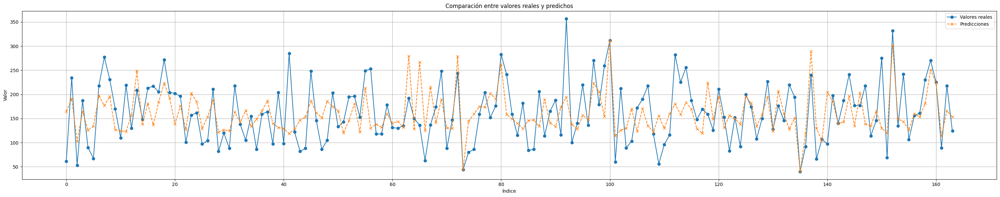

Evaluation metrics for AutoTabPFN performance in eval
MSE: 2852.735595703125
RMSE: 53.41100631614354
R2: 0.29616546630859375
MAE: 42.499481201171875
MAPE: 0.3086627125740051


In [ ]:
tabpfn_exp1 = TabPFNRegressor()

LearningCurveDisplay.from_estimator(tabpfn_exp1, x_train_exp1, y_train_exp1, cv=cv, scoring='r2')
tabpfn_exp1.fit(x_train_exp1, y_train_exp1)
# Predict on train test
train_predictions = tabpfn_exp1.predict(x_train_exp1)
# Predict on the test set
predictions = tabpfn_exp1.predict(x_eval_exp1)

# evaluate
train_scores = evaluate_regression(y_train_exp1, train_predictions, 'tabpfn performance in training')
eval_scores = evaluate_regression(y_eval_exp1, predictions, 'tabpfn performance in eval')

all_scores['tabpfn_exp1'] = [train_scores, eval_scores]

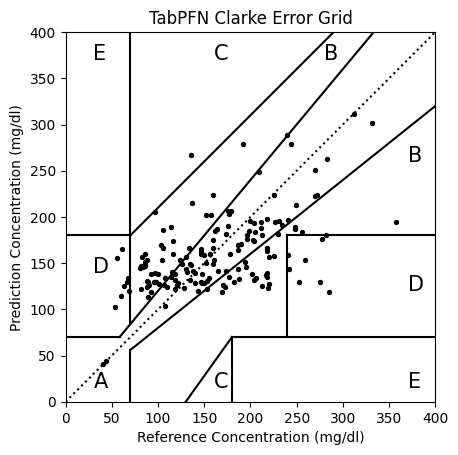

{'A': '46.95 %', 'B': '43.29 %', 'C': '0.61 %', 'D': '9.15 %', 'E': '0.00 %'}


In [ ]:
predictions = predictions.flatten()
y_eval_exp1 = y_eval_exp1.flatten()

# CLARKE ERROR GRID
plot, zone = clarke_error_grid(y_eval_exp1, predictions, 'TabPFN')
plot.show()
total = sum(zone)
print({ key: f'{(count*100.0/total):.2f} %' for key, count in zip('ABCDE', zone)  })

#### TabNet


Early stopping occurred at epoch 55 with best_epoch = 35 and best_val_0_mse = 2946.42578
Best parameters: {'momentum': 0.02, 'n_a': 32, 'n_d': 8}

Early stopping occurred at epoch 67 with best_epoch = 47 and best_val_1_mse = 3025.70947


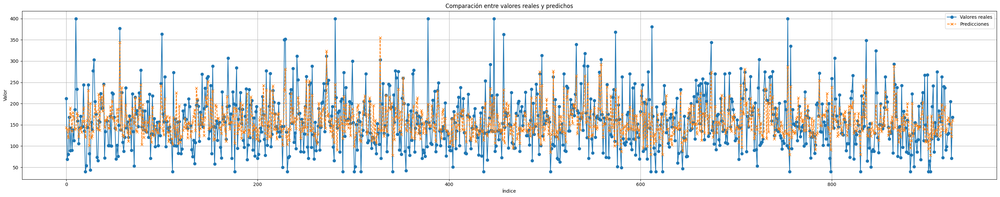

Evaluation metrics for TabNet performance in training
MSE: 2442.0380859375
RMSE: 49.41698175665426
R2: 0.44449251890182495
MAE: 38.54058837890625
MAPE: 0.30851542949676514


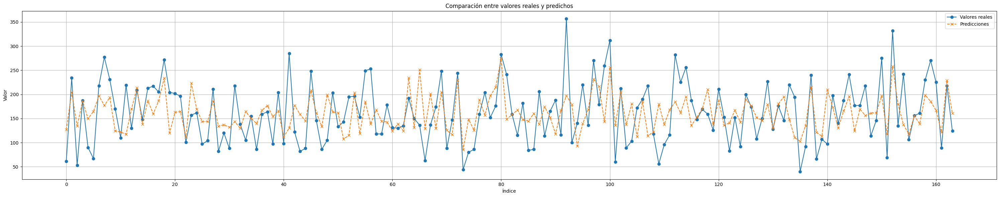

Evaluation metrics for TabNet performance in eval
MSE: 3025.70947265625
RMSE: 55.0064493732894
R2: 0.2534888982772827
MAE: 45.11498260498047
MAPE: 0.34541743993759155


In [ ]:
parameters = {'n_d': (8, 16, 32), 'n_a': (8, 16, 32), 'momentum': (0.01, 0.02, 0.15)}

tabNet_exp1 = TabNetRegressor(verbose=0)

grid = GridSearchCV(tabNet_exp1, parameters, n_jobs=2, cv=cv, scoring='neg_mean_squared_error')
grid.fit(
  x_train_exp1, y_train_exp1,
  eval_set=[(x_eval_exp1, y_eval_exp1)],
  batch_size=64,
  virtual_batch_size=32,
  patience=20
)

best_tabNet_exp1 = grid.best_estimator_
print('Best parameters:', grid.best_params_)
best_tabNet_exp1.fit(
  x_train_exp1, y_train_exp1,
  eval_set=[(x_train_exp1, y_train_exp1), (x_eval_exp1, y_eval_exp1)],
  batch_size=128,
  virtual_batch_size=64,
  patience=20
)

# Predict on train test
train_predictions = best_tabNet_exp1.predict(x_train_exp1)
# Predict on the test set
predictions = best_tabNet_exp1.predict(x_eval_exp1)

# evaluate
train_scores = evaluate_regression(y_train_exp1, train_predictions, 'TabNet performance in training')
eval_scores = evaluate_regression(y_eval_exp1, predictions, 'TabNet performance in eval')

all_scores['TabNet_exp1'] = [train_scores, eval_scores]

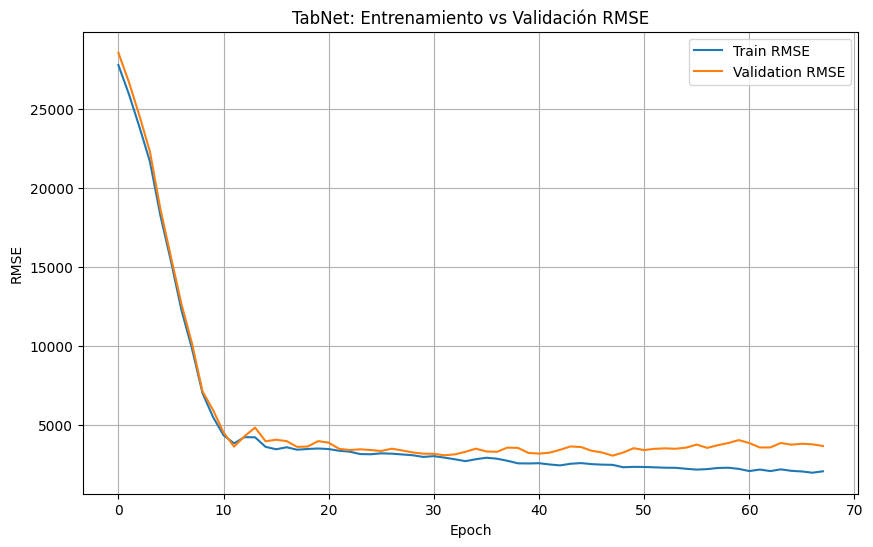

In [ ]:
# 4. Obtener los logs de entrenamiento
train_rmse = best_tabNet_exp1.history['val_0_mse']
val_rmse = best_tabNet_exp1.history['val_1_mse']

# 5. Graficar
plt.figure(figsize=(10, 6))
plt.plot(train_rmse, label='Train RMSE')
plt.plot(val_rmse, label='Validation RMSE')
plt.xlabel("Epoch")
plt.ylabel("RMSE")
plt.title("TabNet: Entrenamiento vs Validación RMSE")
plt.legend()
plt.grid(True)
plt.show()

#### SVM

Best parameters: {'C': 16, 'epsilon': 1, 'gamma': 'auto', 'kernel': 'rbf'}


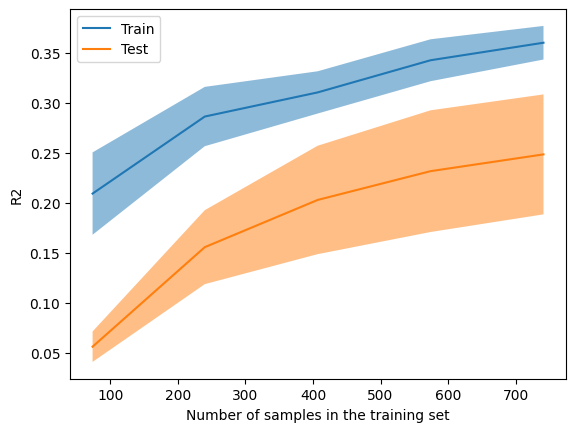

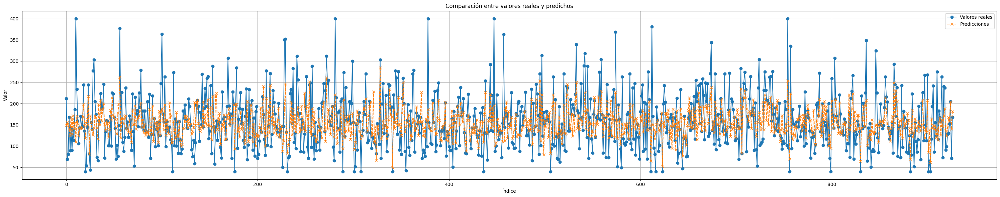

Evaluation metrics for SVM performance in training
MSE: 2796.031809049408
RMSE: 52.877517046939786
R2: 0.3639670718090009
MAE: 39.38037518751597
MAPE: 0.30199964274020596


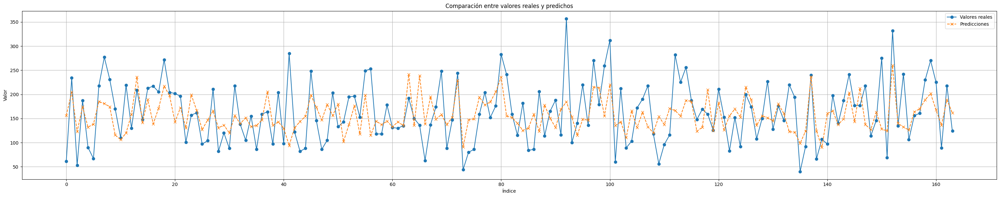

Evaluation metrics for SVM performance in eval
MSE: 3136.361464477631
RMSE: 56.003227268414015
R2: 0.22618852932053102
MAE: 45.571831004780044
MAPE: 0.33500210173746636


In [ ]:
parameters = {'kernel':('rbf', 'poly'), 'C':(0.1, 0.25, 0.5, 1, 2, 4, 8, 16), 'gamma':('scale', 'auto'), 'epsilon': (0.025, 0.05, 0.1, 0.2, 0.4, 0.8, 1)}

svm_exp1 = svm.SVR()

grid = GridSearchCV(svm_exp1, parameters, n_jobs=2, cv=cv)
grid.fit(x_train_exp1, y_train_exp1)

best_svm_exp1 = grid.best_estimator_
print('Best parameters:', grid.best_params_)
LearningCurveDisplay.from_estimator(best_svm_exp1, x_train_exp1, y_train_exp1, cv=cv, scoring='r2')
best_svm_exp1.fit(x_train_exp1, y_train_exp1)

# Predict on train test
train_predictions = best_svm_exp1.predict(x_train_exp1)
# Predict on the test set
predictions = best_svm_exp1.predict(x_eval_exp1)

# evaluate
train_scores = evaluate_regression(y_train_exp1, train_predictions, 'SVM performance in training')
eval_scores = evaluate_regression(y_eval_exp1, predictions, 'SVM performance in eval')

all_scores['SVM_exp1'] = [train_scores, eval_scores]

#### XGBoost

[0]	validation_0-rmse:63.15315
[1]	validation_0-rmse:62.61125
[2]	validation_0-rmse:62.12389
[3]	validation_0-rmse:61.68387
[4]	validation_0-rmse:61.29065
[5]	validation_0-rmse:60.91231
[6]	validation_0-rmse:60.59319
[7]	validation_0-rmse:60.28601
[8]	validation_0-rmse:60.01151
[9]	validation_0-rmse:59.70896
[10]	validation_0-rmse:59.47948
[11]	validation_0-rmse:59.29387
[12]	validation_0-rmse:59.12285
[13]	validation_0-rmse:58.95306
[14]	validation_0-rmse:58.78801
[15]	validation_0-rmse:58.61060
[16]	validation_0-rmse:58.51823
[17]	validation_0-rmse:58.47782
[18]	validation_0-rmse:58.37331
[19]	validation_0-rmse:58.22794
[20]	validation_0-rmse:58.18097
[21]	validation_0-rmse:58.11012
[22]	validation_0-rmse:57.97423
[23]	validation_0-rmse:57.80167
[24]	validation_0-rmse:57.72623
[25]	validation_0-rmse:57.68579
[26]	validation_0-rmse:57.54418
[27]	validation_0-rmse:57.45270
[28]	validation_0-rmse:57.29767
[29]	validation_0-rmse:57.18890
[30]	validation_0-rmse:57.08703
[31]	validation_0-

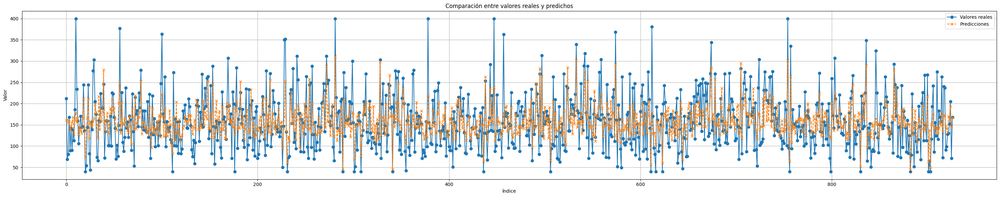

Evaluation metrics for XBG performance in training
MSE: 2322.02734375
RMSE: 48.18741893637799
R2: 0.47179222106933594
MAE: 37.80421829223633
MAPE: 0.2949156165122986


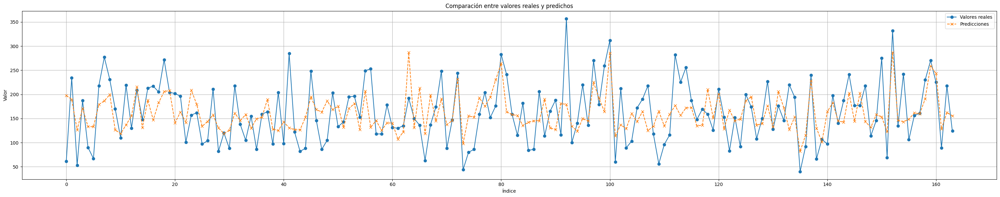

Evaluation metrics for XGB performance in eval
MSE: 2820.275634765625
RMSE: 53.106267377453904
R2: 0.3041740655899048
MAE: 43.23082733154297
MAPE: 0.3287731409072876


In [ ]:
parameters = { 'max_depth':(2, 3, 6, 12), 'learning_rate':(0.05, 0.1, 0.3, 0.9), 'n_estimators':(25, 50, 75, 150, 300)  }

XGB_exp1 = xgb.XGBRegressor(tree_method="hist", early_stopping_rounds=10, verbosity=0) #hist porque es más rápido
grid = GridSearchCV(XGB_exp1, parameters, n_jobs=2, cv=cv)
grid.fit(x_train_exp1, y_train_exp1, eval_set=[(x_eval_exp1, y_eval_exp1)])

best_XGB_exp1 = grid.best_estimator_
print('Best parameters:', grid.best_params_)
best_XGB_exp1.fit(x_train_exp1, y_train_exp1, eval_set=[(x_train_exp1, y_train_exp1),(x_eval_exp1, y_eval_exp1)])

# Predict on train test
train_predictions = best_XGB_exp1.predict(x_train_exp1)
# Predict on the test set
predictions = best_XGB_exp1.predict(x_eval_exp1)

# evaluate
train_scores = evaluate_regression(y_train_exp1, train_predictions, 'XBG performance in training')
eval_scores = evaluate_regression(y_eval_exp1, predictions, 'XGB performance in eval')

all_scores['XGB_exp1'] = [train_scores, eval_scores]

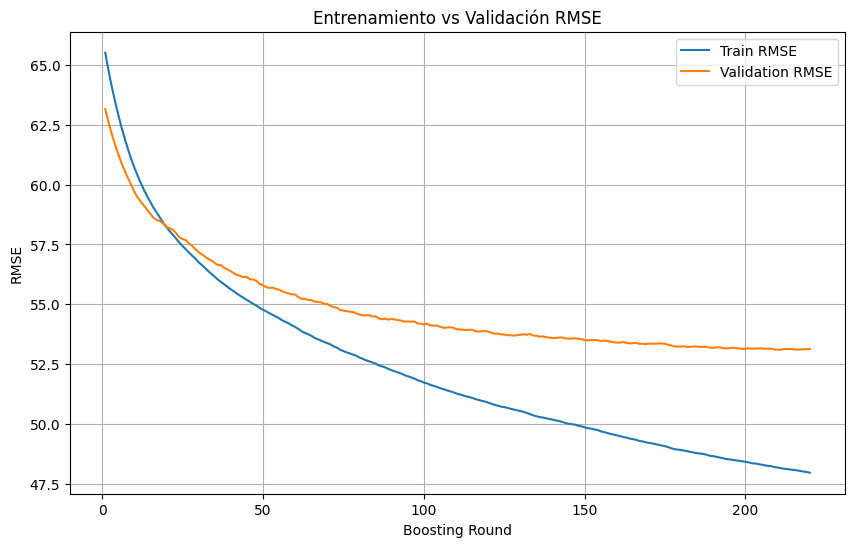

In [ ]:
# 4. Obtener resultados
results = best_XGB_exp1.evals_result()

# 5. Graficar
epochs = range(1, len(results['validation_0']['rmse']) + 1)
train_rmse = results['validation_0']['rmse']
val_rmse = results['validation_1']['rmse']

plt.figure(figsize=(10, 6))
plt.plot(epochs, train_rmse, label='Train RMSE')
plt.plot(epochs, val_rmse, label='Validation RMSE')
plt.xlabel("Boosting Round")
plt.ylabel("RMSE")
plt.title("Entrenamiento vs Validación RMSE")
plt.legend()
plt.grid(True)
plt.show()

#### Random forest

Best parameters: {'max_depth': 20, 'max_features': 'sqrt', 'min_samples_leaf': 2, 'min_samples_split': 5, 'n_estimators': 200}


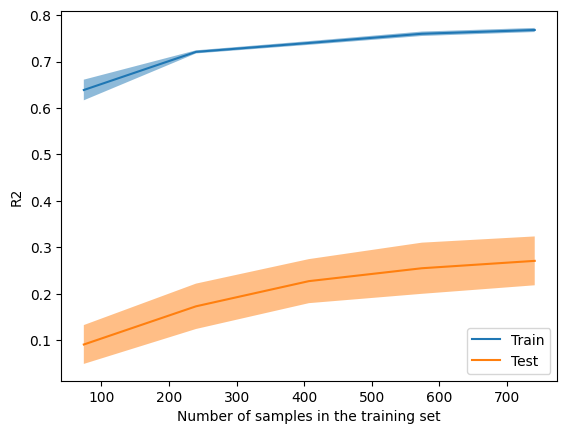

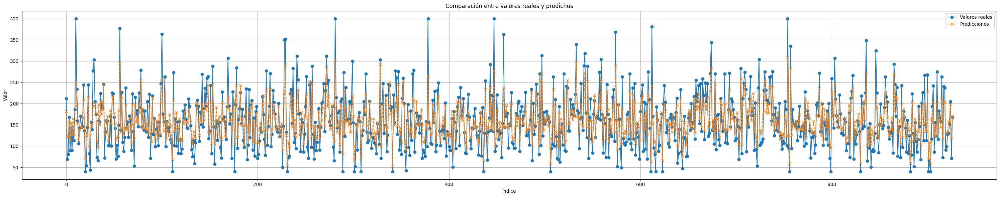

Evaluation metrics for RF performance in training
MSE: 1014.1538899694092
RMSE: 31.845782922851956
R2: 0.7693033154394499
MAE: 24.40390273927604
MAPE: 0.19462823393039938


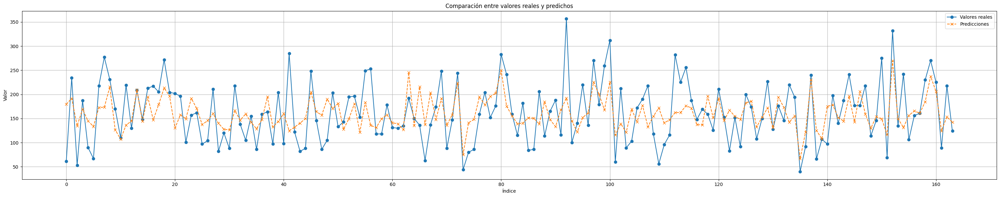

Evaluation metrics for SVM performance in eval
MSE: 2789.3718452347116
RMSE: 52.81450411804234
R2: 0.31179873420856763
MAE: 42.88735800289936
MAPE: 0.3228726639638966


In [ ]:
parameters = {
    'n_estimators': [25, 50, 100, 200],
    'max_depth': [None, 10, 15, 20],
    'min_samples_split': [2, 5, 10],
    'min_samples_leaf': [1, 2, 4],
    'max_features': ['sqrt', 'log2']
}

rf_exp1 = RandomForestRegressor(random_state=42)
grid = GridSearchCV(rf_exp1, parameters, n_jobs=2, cv=cv)
grid.fit(x_train_exp1, y_train_exp1)

best_rf_exp1 = grid.best_estimator_
print('Best parameters:', grid.best_params_)
LearningCurveDisplay.from_estimator(best_rf_exp1, x_train_exp1, y_train_exp1, cv=cv, scoring='r2')
best_rf_exp1.fit(x_train_exp1, y_train_exp1)

# Predict on train test
train_predictions = best_rf_exp1.predict(x_train_exp1)
# Predict on the test set
predictions = best_rf_exp1.predict(x_eval_exp1)

# evaluate
train_scores = evaluate_regression(y_train_exp1, train_predictions, 'RF performance in training')
eval_scores = evaluate_regression(y_eval_exp1, predictions, 'SVM performance in eval')

all_scores['RF_exp1'] = [train_scores, eval_scores]

### Experimento 2: todos los datos

In [ ]:
# volver a generar los conjuntos de entrenamiento con todas las variables
unwanted_features = ['illness', 'id']

# pasar la pipeline
all_ids_features_prepared = full_pipeline.fit_transform(df_raw)

# separación de datos
x_train_exp2, x_eval_exp2, y_train_exp2, y_eval_exp2 = split_regression(all_ids_features_prepared, df_label_raw)
y_train_exp2 = y_train_exp2.values.reshape(-1, 1)
y_eval_exp2 = y_eval_exp2.values.reshape(-1, 1)


# 4. nombres de las variables usadas
feature_names_exp2 = full_pipeline[1:].get_feature_names_out()

# 5. mezclador de ejemplos para CV
cv = StratifiedKFold(n_splits=5, shuffle=True, random_state=42)

#### tabpfn

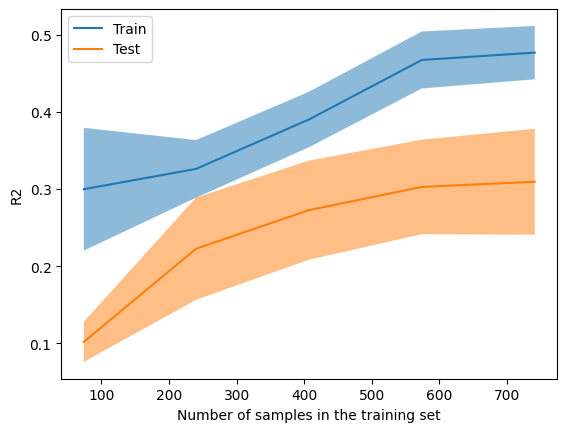

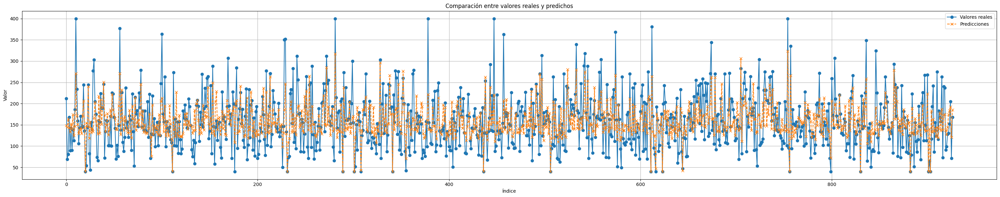

Evaluation metrics for AutoTabPFN performance in training
MSE: 2215.301025390625
RMSE: 47.066984451849315
R2: 0.4960699677467346
MAE: 36.73017501831055
MAPE: 0.2782108187675476


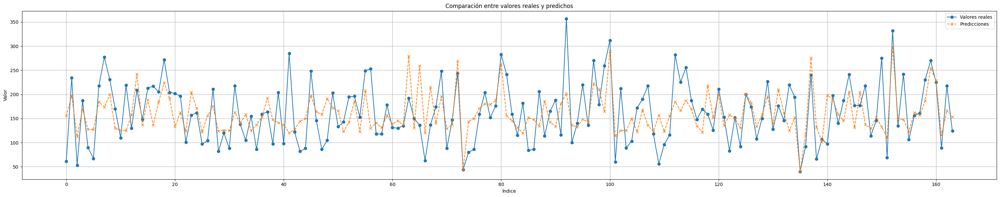

Evaluation metrics for AutoTabPFN performance in eval
MSE: 2714.41845703125
RMSE: 52.10008116146509
R2: 0.3302914500236511
MAE: 41.36846160888672
MAPE: 0.2997806668281555


In [ ]:
tabpfn_exp2 = TabPFNRegressor() # TABPFN INSTEAD OF AUTOTAB SO THAT WE CAN PLOT LEARNING CURVES

LearningCurveDisplay.from_estimator(tabpfn_exp2, x_train_exp2, y_train_exp2, cv=cv, scoring='r2')
tabpfn_exp2.fit(x_train_exp2, y_train_exp2)

# Predict on train test
train_predictions = tabpfn_exp2.predict(x_train_exp2)
# Predict on the test set
predictions = tabpfn_exp2.predict(x_eval_exp2)

# evaluate
train_scores = evaluate_regression(y_train_exp2, train_predictions, 'tabpfn performance in training')
eval_scores = evaluate_regression(y_eval_exp2, predictions, 'tabpfn performance in eval')

all_scores['tabpfn_exp2'] = [train_scores, eval_scores]

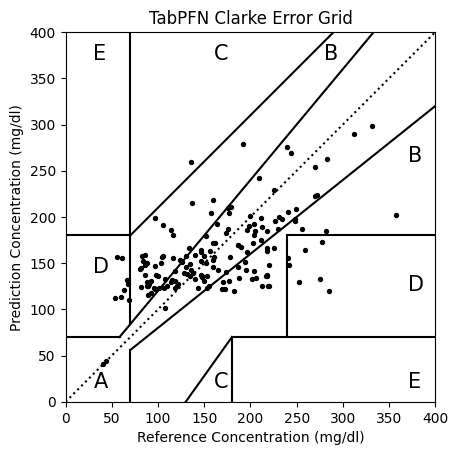

164 [81, 67, 1, 15, 0]
{'A': '49.39 %', 'B': '40.85 %', 'C': '0.61 %', 'D': '9.15 %', 'E': '0.00 %'}


In [ ]:
predictions = predictions.flatten()
y_eval_exp2 = y_eval_exp2.flatten()

# CLARKE ERROR GRID
plot, zone = clarke_error_grid(y_eval_exp2, predictions, 'TabPFN')
plot.show()
total = sum(zone)
print(total, zone)
print({ key: f'{(count*100.0/total):.2f} %' for key, count in zip('ABCDE', zone)  })

#### TabNet


Early stopping occurred at epoch 48 with best_epoch = 28 and best_val_0_mse = 3148.77905
Best parameters: {'momentum': 0.15, 'n_a': 16, 'n_d': 16}

Early stopping occurred at epoch 58 with best_epoch = 38 and best_val_1_mse = 3038.10693


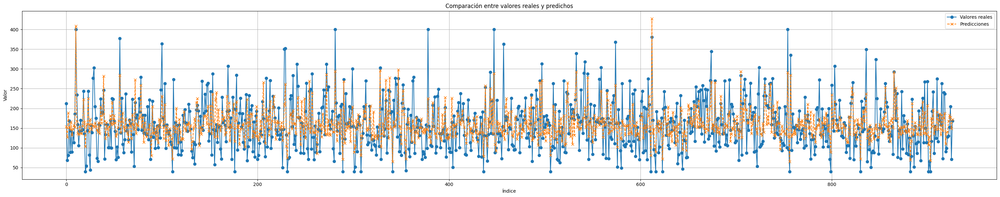

Evaluation metrics for TabNet performance in training
MSE: 2395.8125
RMSE: 48.94703770403272
R2: 0.45500773191452026
MAE: 38.77366638183594
MAPE: 0.30819934606552124


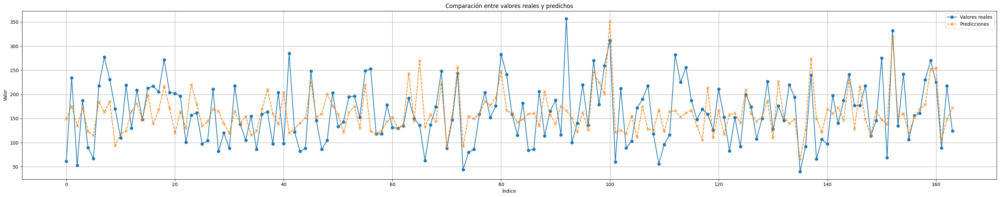

Evaluation metrics for AutoTabPFN performance in eval
MSE: 3038.10693359375
RMSE: 55.119025150974416
R2: 0.250430166721344
MAE: 43.82765579223633
MAPE: 0.3302338421344757


In [ ]:
parameters = {'n_d': (8, 16, 32), 'n_a': (8, 16, 32), 'momentum': (0.01, 0.02, 0.15)}

tabNet_exp2 = TabNetRegressor(verbose=0)

grid = GridSearchCV(tabNet_exp2, parameters, n_jobs=2, cv=cv, scoring='neg_mean_squared_error')
grid.fit(
  x_train_exp2, y_train_exp2,
  eval_set=[(x_eval_exp2, y_eval_exp2)],
  batch_size=64,
  virtual_batch_size=32,
  patience=20
)

best_tabNet_exp2 = grid.best_estimator_
print('Best parameters:', grid.best_params_)
best_tabNet_exp2.fit(
  x_train_exp2, y_train_exp2,
  eval_set=[(x_train_exp2, y_train_exp2), (x_eval_exp2, y_eval_exp2)],
  batch_size=64,
  virtual_batch_size=32,
  patience=20
)

# Predict on train test
train_predictions = best_tabNet_exp2.predict(x_train_exp2)
# Predict on the test set
predictions = best_tabNet_exp2.predict(x_eval_exp2)

# evaluate
train_scores = evaluate_regression(y_train_exp2, train_predictions, 'TabNet performance in training')
eval_scores = evaluate_regression(y_eval_exp2, predictions, 'TabNet performance in eval')

all_scores['TabNet_exp2'] = [train_scores, eval_scores]

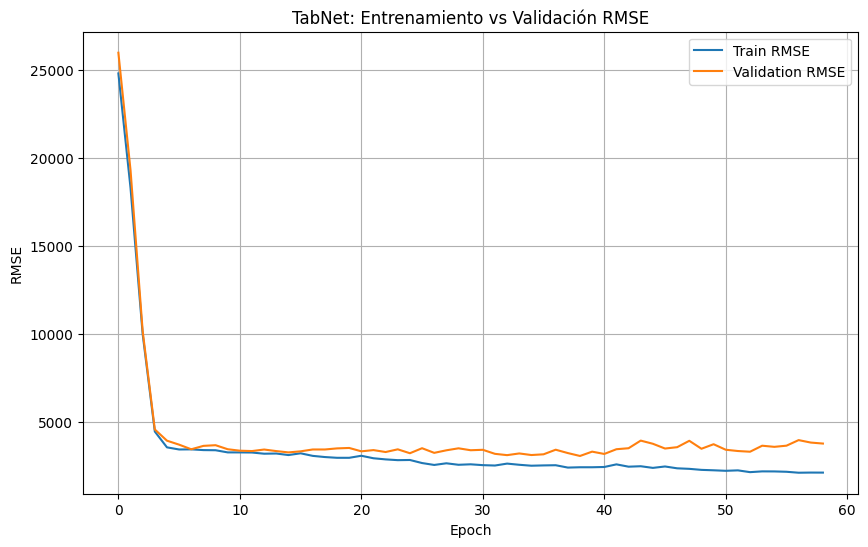

In [ ]:
# 4. Obtener los logs de entrenamiento
train_rmse = best_tabNet_exp2.history['val_0_mse']
val_rmse = best_tabNet_exp2.history['val_1_mse']

# 5. Graficar
plt.figure(figsize=(10, 6))
plt.plot(train_rmse, label='Train RMSE')
plt.plot(val_rmse, label='Validation RMSE')
plt.xlabel("Epoch")
plt.ylabel("RMSE")
plt.title("TabNet: Entrenamiento vs Validación RMSE")
plt.legend()
plt.grid(True)
plt.show()

#### SVM

Best parameters: {'C': 16, 'epsilon': 1, 'gamma': 'scale', 'kernel': 'rbf'}


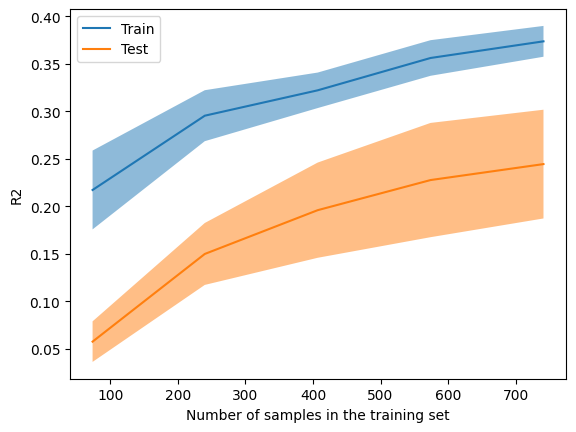

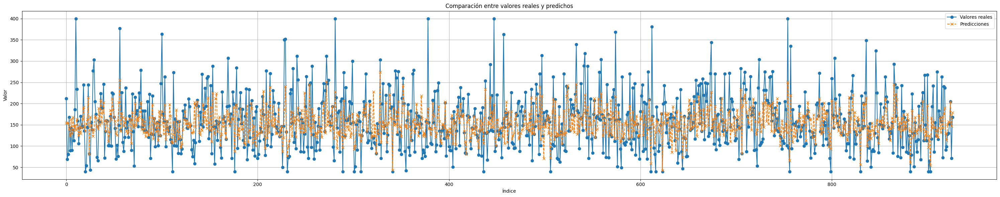

Evaluation metrics for SVM performance in training
MSE: 2741.4671791522223
RMSE: 52.35902194610039
R2: 0.37637927013122374
MAE: 38.80001422085045
MAPE: 0.2939706617780225


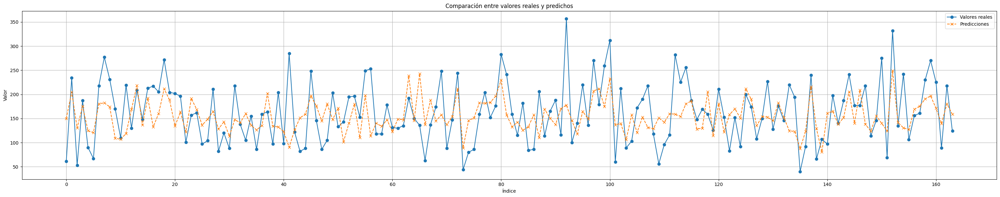

Evaluation metrics for SVM performance in eval
MSE: 3168.293422740321
RMSE: 56.28759563829602
R2: 0.21831019135955776
MAE: 46.13328983628469
MAPE: 0.3348805283946684


In [ ]:
parameters = {'kernel':('rbf', 'poly'), 'C':(1, 2, 4, 8, 16), 'gamma':('scale', 'auto'), 'epsilon': (0.025, 0.05, 0.1, 0.2, 0.4, 0.8, 1)}

svm_exp2 = svm.SVR()
grid = GridSearchCV(svm_exp2, parameters, n_jobs=2, cv=cv)
grid.fit(x_train_exp2, y_train_exp2)

best_svm_exp2 = grid.best_estimator_
print('Best parameters:', grid.best_params_)
LearningCurveDisplay.from_estimator(best_svm_exp2, x_train_exp2, y_train_exp2, cv=cv, scoring='r2')
best_svm_exp2.fit(x_train_exp2, y_train_exp2)

# Predict on train test
train_predictions = best_svm_exp2.predict(x_train_exp2)
# Predict on the test set
predictions = best_svm_exp2.predict(x_eval_exp2)

# evaluate
train_scores = evaluate_regression(y_train_exp2, train_predictions, 'SVM performance in training')
eval_scores = evaluate_regression(y_eval_exp2, predictions, 'SVM performance in eval')

all_scores['SVM_exp2'] = [train_scores, eval_scores]

#### XGBoost

[0]	validation_0-rmse:63.15315
[1]	validation_0-rmse:62.61125
[2]	validation_0-rmse:62.12389
[3]	validation_0-rmse:61.68387
[4]	validation_0-rmse:61.29065
[5]	validation_0-rmse:60.91231
[6]	validation_0-rmse:60.59319
[7]	validation_0-rmse:60.28601
[8]	validation_0-rmse:60.01151
[9]	validation_0-rmse:59.70896
[10]	validation_0-rmse:59.47948
[11]	validation_0-rmse:59.29387
[12]	validation_0-rmse:59.12285
[13]	validation_0-rmse:58.95306
[14]	validation_0-rmse:58.83554
[15]	validation_0-rmse:58.65669
[16]	validation_0-rmse:58.52509
[17]	validation_0-rmse:58.41458
[18]	validation_0-rmse:58.29880
[19]	validation_0-rmse:58.24232
[20]	validation_0-rmse:58.11036
[21]	validation_0-rmse:58.04003
[22]	validation_0-rmse:57.79388
[23]	validation_0-rmse:57.75790
[24]	validation_0-rmse:57.53982
[25]	validation_0-rmse:57.44904
[26]	validation_0-rmse:57.28928
[27]	validation_0-rmse:57.18864
[28]	validation_0-rmse:57.01197
[29]	validation_0-rmse:56.92104
[30]	validation_0-rmse:56.77875
[31]	validation_0-

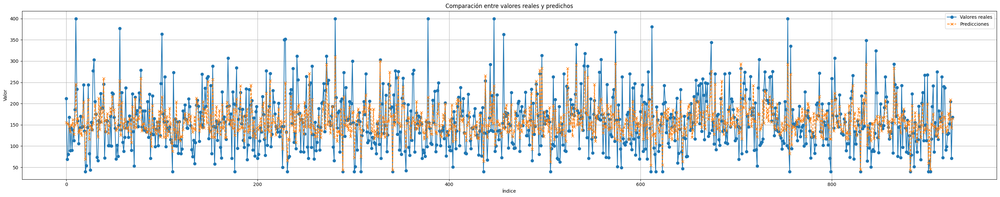

Evaluation metrics for XGB performance in training
MSE: 2261.038818359375
RMSE: 47.55038189498981
R2: 0.4856656789779663
MAE: 37.292686462402344
MAPE: 0.29044196009635925


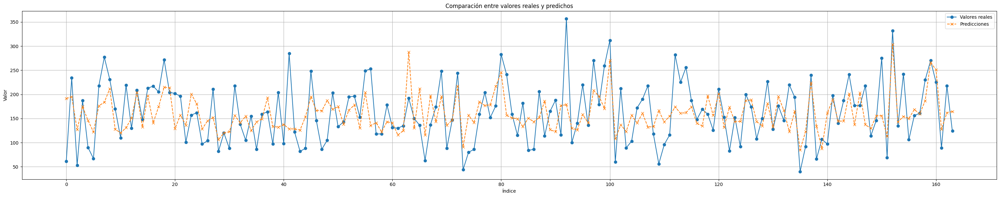

Evaluation metrics for XGB performance in eval
MSE: 2763.758544921875
RMSE: 52.57146131621105
R2: 0.3181180953979492
MAE: 42.58494186401367
MAPE: 0.32124704122543335


In [ ]:
parameters = { 'max_depth':(2, 3, 6, 12), 'learning_rate':(0.05, 0.1, 0.3, 0.9), 'n_estimators':(25, 50, 75, 150, 300)  }

XGB_exp2 = xgb.XGBRegressor(tree_method="hist", early_stopping_rounds=10, verbosity=0) #hist porque es más rápido
grid = GridSearchCV(XGB_exp2, parameters, n_jobs=2, cv=cv)
grid.fit(x_train_exp2, y_train_exp2, eval_set=[(x_eval_exp2, y_eval_exp2)])

best_XGB_exp2 = grid.best_estimator_
print('Best parameters:', grid.best_params_)
best_XGB_exp2.fit(x_train_exp2, y_train_exp2, eval_set=[(x_train_exp2, y_train_exp2), (x_eval_exp2, y_eval_exp2)]) # dos conjuntos de eval, entrenamiento y eval para graficar el entrenamiento

# Predict on train test
train_predictions = best_XGB_exp2.predict(x_train_exp2)
# Predict on the test set
predictions = best_XGB_exp2.predict(x_eval_exp2)

# evaluate
train_scores = evaluate_regression(y_train_exp2, train_predictions, 'XGB performance in training')
eval_scores = evaluate_regression(y_eval_exp2, predictions, 'XGB performance in eval')

all_scores['XGB_exp2'] = [train_scores, eval_scores]

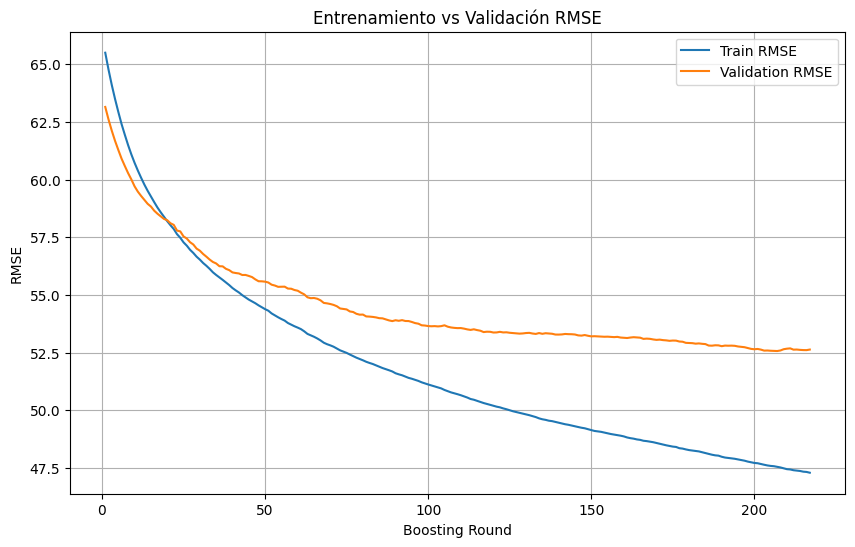

In [ ]:
# 4. Obtener resultados
results = best_XGB_exp2.evals_result()

# 5. Graficar
epochs = range(1, len(results['validation_0']['rmse']) + 1)
train_rmse = results['validation_0']['rmse']
val_rmse = results['validation_1']['rmse']

plt.figure(figsize=(10, 6))
plt.plot(epochs, train_rmse, label='Train RMSE')
plt.plot(epochs, val_rmse, label='Validation RMSE')
plt.xlabel("Boosting Round")
plt.ylabel("RMSE")
plt.title("Entrenamiento vs Validación RMSE")
plt.legend()
plt.grid(True)
plt.show()

#### RandomForest

Best parameters: {'max_depth': 20, 'max_features': 'sqrt', 'min_samples_leaf': 2, 'min_samples_split': 5, 'n_estimators': 200}


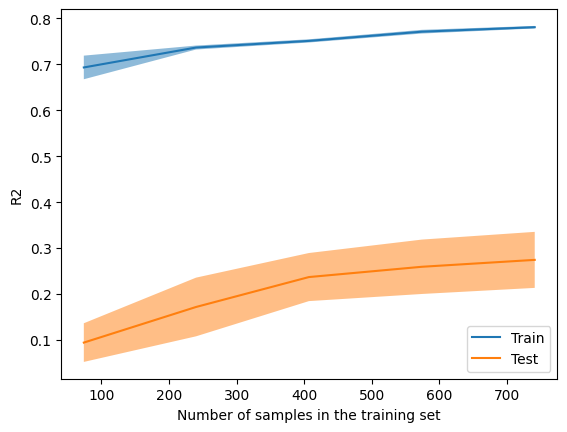

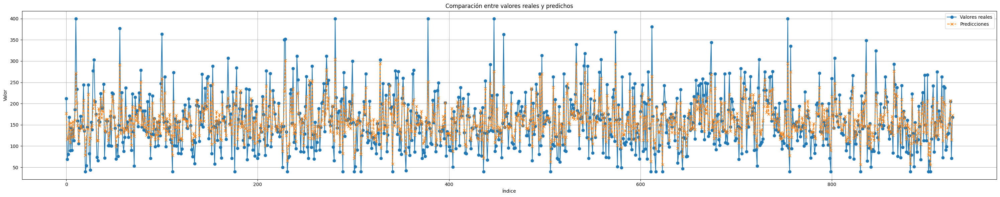

Evaluation metrics for RF performance in training
MSE: 955.3041093124435
RMSE: 30.90799426220413
R2: 0.7826902870016129
MAE: 23.687899112097835
MAPE: 0.1894434561198954


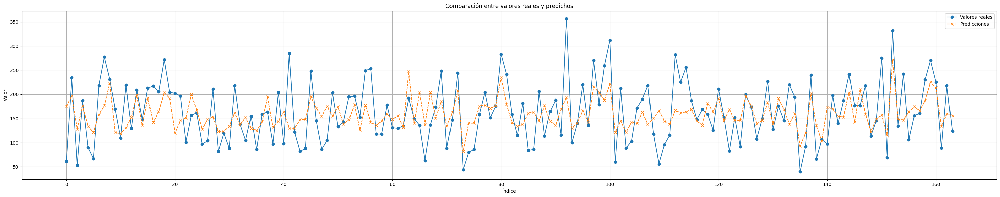

Evaluation metrics for RF performance in eval
MSE: 2728.815985199936
RMSE: 52.238070266807675
R2: 0.3267392376047774
MAE: 42.82050809959701
MAPE: 0.32348773258921054


In [ ]:
parameters = {
    'n_estimators': [25, 50, 100, 200],
    'max_depth': [None, 10, 15, 20],
    'min_samples_split': [2, 5, 10],
    'min_samples_leaf': [1, 2, 4],
    'max_features': ['sqrt', 'log2']
}

rf_exp2 = RandomForestRegressor(n_estimators=100, random_state=42)
grid = GridSearchCV(rf_exp2, parameters, n_jobs=2, cv=cv)
grid.fit(x_train_exp2, y_train_exp2)

best_rf_exp2 = grid.best_estimator_
print('Best parameters:', grid.best_params_)
LearningCurveDisplay.from_estimator(best_rf_exp2, x_train_exp2, y_train_exp2, cv=cv, scoring='r2')
best_rf_exp2.fit(x_train_exp2, y_train_exp2)

# Predict on train test
train_predictions = best_rf_exp2.predict(x_train_exp2)
# Predict on the test set
predictions = best_rf_exp2.predict(x_eval_exp2)

# evaluate
train_scores = evaluate_regression(y_train_exp2, train_predictions, 'RF performance in training')
eval_scores = evaluate_regression(y_eval_exp2, predictions, 'RF performance in eval')

all_scores['RF_exp2'] = [train_scores, eval_scores]

### Conclusiones tras los dos primeros experimentos

Comparison of Model Performance Across Experiments


,Eval Score_AutoTabPFN_exp2,Eval Score_RF_exp2,Eval Score_SVM_exp2,Eval Score_TabNet_exp2,Eval Score_XGB_exp2,Train Score_AutoTabPFN_exp2,Train Score_RF_exp2,Train Score_SVM_exp2,Train Score_TabNet_exp2,Train Score_XGB_exp2
Metric,,,,,,,,,,
MAE,41.242851,42.820508,46.133290,43.827656,42.584942,36.736347,23.687899,38.800014,38.773666,37.292686
MAPE,0.299023,0.323488,0.334881,0.330234,0.321247,0.278496,0.189443,0.293971,0.308199,0.290442
MSE,2699.573486,2728.815985,3168.293423,3038.106934,2763.758545,2215.722900,955.304109,2741.467179,2395.812500,2261.038818
R2,0.333954,0.326739,0.218310,0.250430,0.318118,0.495974,0.782690,0.376379,0.455008,0.485666
RMSE,51.957420,52.238070,56.287596,55.119025,52.571461,47.071466,30.907994,52.359022,48.947038,47.550382


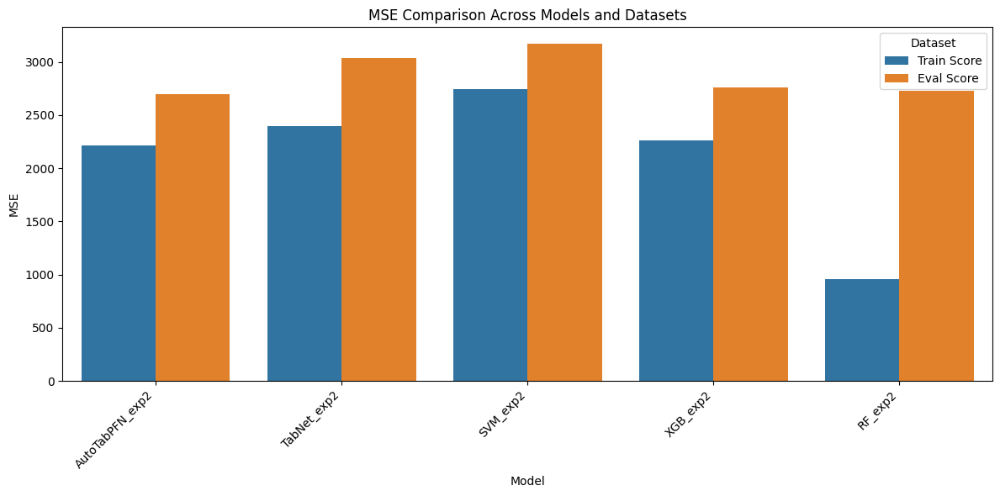

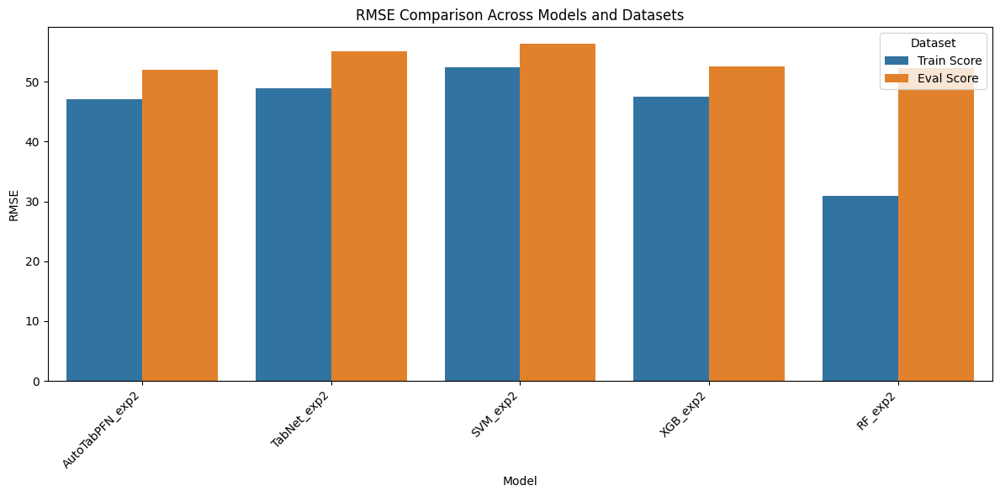

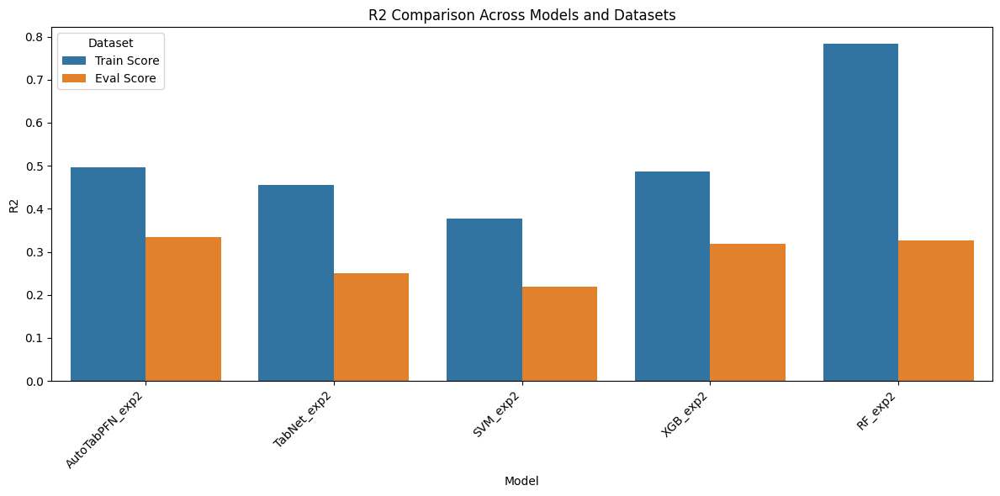

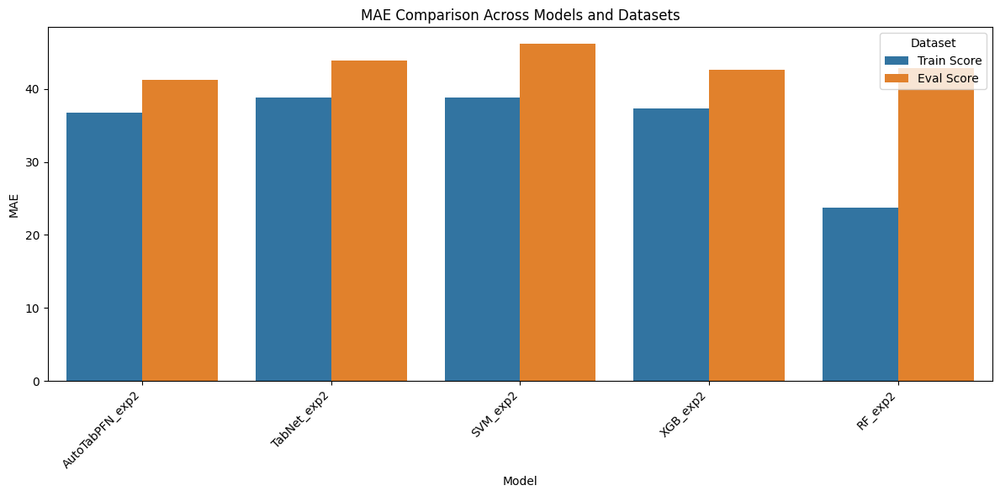

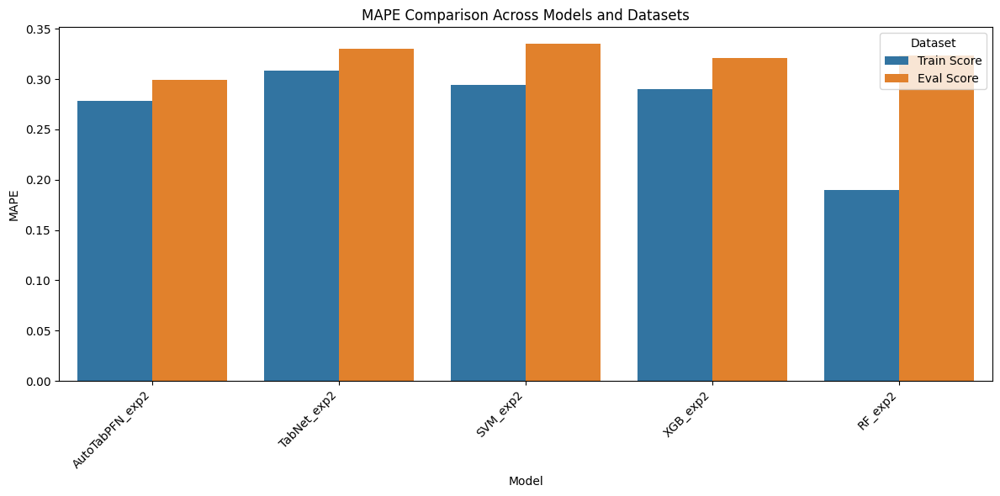

In [ ]:
# Convert all_scores to a pandas DataFrame for easier visualization
metrics = ['MSE', 'RMSE', 'R2', 'MAE', 'MAPE']
data_for_df = []

for model_name, scores in all_scores.items():
    train_scores, eval_scores = scores
    for metric_name, train_score, eval_score in zip(metrics, train_scores, eval_scores):
        data_for_df.append({
            'Model': model_name,
            'Metric': metric_name,
            'Train Score': train_score,
            'Eval Score': eval_score
        })

scores_df = pd.DataFrame(data_for_df)

# Pivot the DataFrame to have metrics as rows and models as columns
pivot_df = scores_df.pivot_table(index='Metric', columns='Model', values=['Train Score', 'Eval Score'])

# Flatten the columns
pivot_df.columns = [f'{col[0]}_{col[1]}' for col in pivot_df.columns]

# Display the table
print("Comparison of Model Performance Across Experiments")
display(pivot_df)

# Optional: Use seaborn to visualize the scores
# Melt the DataFrame back to long format for plotting
scores_melted = scores_df.melt(id_vars=['Model', 'Metric'], var_name='Dataset', value_name='Score')

# Create bar plots for each metric
for metric in metrics:
    plt.figure(figsize=(12, 6))
    sns.barplot(data=scores_melted[scores_melted['Metric'] == metric], x='Model', y='Score', hue='Dataset')
    plt.title(f'{metric} Comparison Across Models and Datasets')
    plt.ylabel(metric)
    plt.xticks(rotation=45, ha='right')
    plt.tight_layout()
    plt.show()


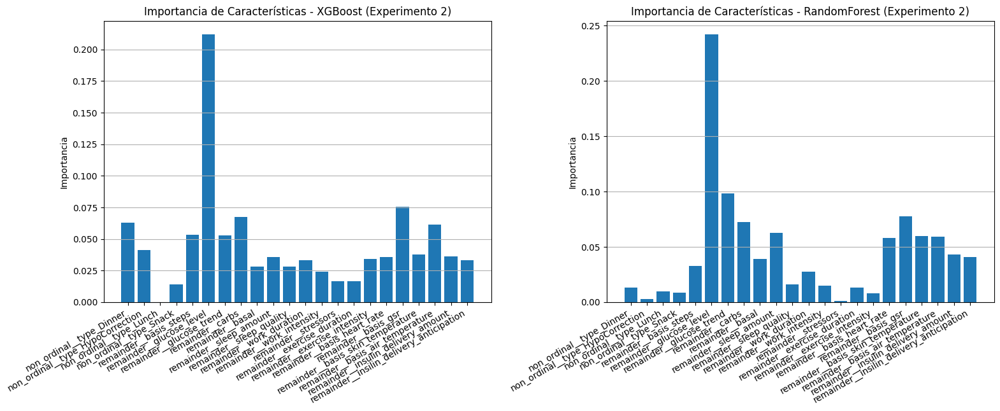

In [ ]:
# Importar matplotlib si no está ya importado
import matplotlib.pyplot as plt
import numpy as np

# Obtener importancias de características de XGBoost y RandomForest
# Para XGBoost, se accede directamente a feature_importances_
xgb_importances = best_XGB_exp2.feature_importances_

# Para RandomForest, se accede directamente a feature_importances_
rf_importances = best_rf_exp2.feature_importances_

# Asegurarse de que las importancias tienen el mismo tamaño que los nombres de las características
if len(feature_names_exp2) != len(xgb_importances) or len(feature_names_exp2) != len(rf_importances):
    print("¡Advertencia: El número de nombres de características no coincide con el número de importancias!")
else:
    # Crear subplots para los dos gráficos
    fig, axes = plt.subplots(nrows=1, ncols=2, figsize=(16, 6))

    # Gráfico de barras para XGBoost
    axes[0].bar(feature_names_exp2, xgb_importances)
    axes[0].set_title('Importancia de Características - XGBoost (Experimento 2)')
    axes[0].set_ylabel('Importancia')
    axes[0].grid(axis='y')

    # Gráfico de barras para RandomForest
    axes[1].bar(feature_names_exp2, rf_importances)
    axes[1].set_title('Importancia de Características - RandomForest (Experimento 2)')
    axes[1].set_ylabel('Importancia')
    axes[1].grid(axis='y')

    # Ajustar el diseño para evitar la superposición
    plt.tight_layout()
    fig.autofmt_xdate()

    # Mostrar los gráficos
    plt.show()


In [ ]:
from sklearn.feature_selection import SequentialFeatureSelector

sfs_forward = SequentialFeatureSelector(
    best_rf_exp2, n_features_to_select=15, direction="forward"
).fit(x_train_exp2, y_train_exp2)

sfs_backward = SequentialFeatureSelector(
    best_rf_exp2, n_features_to_select=15, direction="backward"
).fit(x_train_exp2, y_train_exp2)

print('RANDOM FOREST RESULTS')
print(
    "Features selected by forward sequential selection: "
    f"{feature_names_exp2[sfs_forward.get_support()]}"
)
print(
    "Features selected by backward sequential selection: "
    f"{feature_names_exp2[sfs_backward.get_support()]}"
)

In [ ]:
sfs_forward = SequentialFeatureSelector(
    tabpfn_exp2, n_features_to_select=15, direction="forward"
).fit(x_train_exp2, y_train_exp2)

sfs_backward = SequentialFeatureSelector(
    tabpfn_exp2, n_features_to_select=15, direction="backward"
).fit(x_train_exp2, y_train_exp2)

print('----------------------------------------------------')
print('tabpfn RESULTS')
print(
    "Features selected by forward sequential selection: "
    f"{feature_names_exp2[sfs_forward.get_support()]}"
)
print(
    "Features selected by backward sequential selection: "
    f"{feature_names_exp2[sfs_backward.get_support()]}"
)

Los resultados con más características no son mejores en ningún modelo. La obtenición de importancia de características es bastante reveladora: el nivel de glucosa es indiscutiblemente la característica más importante, lo cual tiene sentido. El resto de características, son bastante similares en importancia. O quizá debamos decir: bastante similares en insignificancia. Un modelo con acceso a más características debería tener más información a su disposición para mejorar su rendimiento a menos que el aumento en el nº de caracterísitcas aumente demasiado la dimensionalidad del problema. Sin embargo, nada de esto es lo que se observa en este experimento: los modelos son peores cuando hay más características. La conclusión es una: estas nuevas características no aportan más información. Si no aportan más información y sólo aumentan la dimensionalidad del problema, es razonable pensar que los modelos van a empeorar. Y si según eel gráfico de importancia de las características estas nuevas características son igual de importantes que casi todas las demás, una inquietante hipótesis emerge con fuerza: el dataset, en general, no contiene información de suficiente calidad.

Esta hipótesis se refuerza gracias a otras observaciones obtenidas de los resultados:
1. Todos los modelos ven sus curvas de entrenamiento aplanadas muy rápido. A pesar de tener un dataset muy pequeño, todos los modelos parecen dejar de aprender significativamente cuando ya han visto aproximadamente la mitad del dataset. Normalmente, los modelos necesitan de decenas a cientos de miles ejemplos de entrenamiento para entrenar correctamente. Los modelos de este experimento, sin embargo, dejan de sacar provecho a los datos a partir de 400. Este inesperado comportamiento es razonable si asumimos que no hay mucho que aprender del dataset porque es, en general, de poca calidad.
2. Todos los modelos sobreentrenan mucho. En estos experimentos, se han puesto a prueba diferentes modelos, cada uno con una forma de trabajar distinta del resto. Además, siempre que ha sido posible, se han realizado técnicas de optimización del entrenamiento, en concreto GridSearch. Y, sin embargo, sus resultados son muy parecidos entre ellos: todos son mediocres y todos discrepan mucho entre entrenamiento y validación. Estos modelos han demostrado ser magníficas opciones en una gran variedad de problemas de aprendizaje automático. Si en este problema todos estos distintos modelos fallan, no parece tener sentido apuntar a los modelos, sino a aquello que tienen en común: los datos

### Experimento 3: entrenar con pacientes individuales

Quizá la hipótesis de que los datos son de mala calidad sea demasiado simple. En estos experimentos, estamos mezclando datos de 6 pacientes distintos. Uno de los mayores retos para los diabéticos consiste en adaptar las directrices generales del tratamiento de diabetes a sus propios metabolismos y estilos de vida, el cual marca una diferencia notable en cómo evolucionan los niveles de glucosa en sus cuerpos. Por tanto, es posible que el problema esté en que 6 pacientes sea una muestra demasiado pequeña como para que los modelos puedan hacerse una idea de cómo funciona la diabetes de forma general.

Para tratar de arrojar luz sobre esta nueva cuestión, el siguiente experimento consistirá en el entrenamiento de los modelos sobre datos de cada paciente individual, realizando un entrenamiento separado para cada uno de ellos.

In [ ]:
# volver a generar los conjuntos de entrenamiento con todas las variables
unwanted_features = ['illness', 'id']

# pasar la pipeline
all_ids_features_prepared = full_pipeline.fit_transform(df_raw)


# separación de datos
x_train_exp3, x_eval_exp3, y_train_exp3, y_eval_exp3 = ([], [], [], [])
for id in separated_ids_features_prepared.keys():
  x_train, x_eval, y_train, y_eval = split_regression(separated_ids_features_prepared[id], separated_ids_labels_raw[id])
  y_train = y_train.reshape(-1, 1)
  y_eval = y_eval.reshape(-1, 1)
  x_train_exp3.append(x_train)
  x_eval_exp3.append(x_eval)
  y_train_exp3.append(y_train)
  y_eval_exp3.append(y_eval)


all_scores_exp3 = {}

# 4. nombres de las variables usadas
feature_names_exp3 = full_pipeline[1:].get_feature_names_out()

# 5. mezclador de ejemplos para CV
cv = KFold(n_splits=5, shuffle=True, random_state=42)

#### tabpfn

tabpfn-v2-regressor.ckpt:   0%|          | 0.00/44.4M [00:00<?, ?B/s]

config.json:   0%|          | 0.00/37.0 [00:00<?, ?B/s]

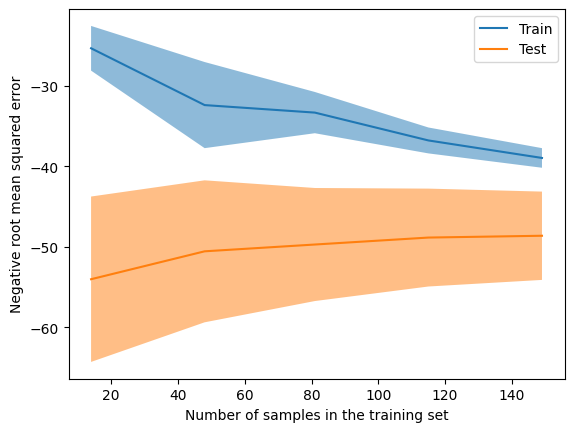

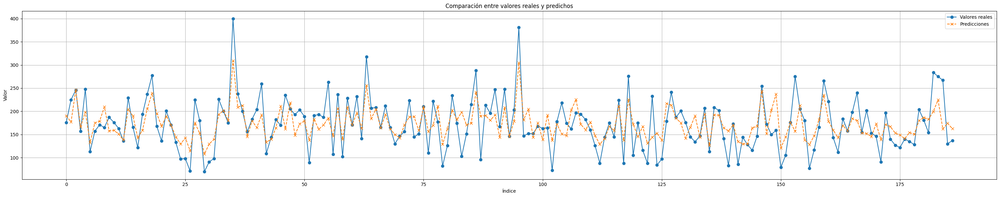

Evaluation metrics for AutoTabPFN performance in training
MSE: 1445.973876953125
RMSE: 38.02596319559999
R2: 0.5393641591072083
MAE: 30.52281379699707
MAPE: 0.20346228778362274


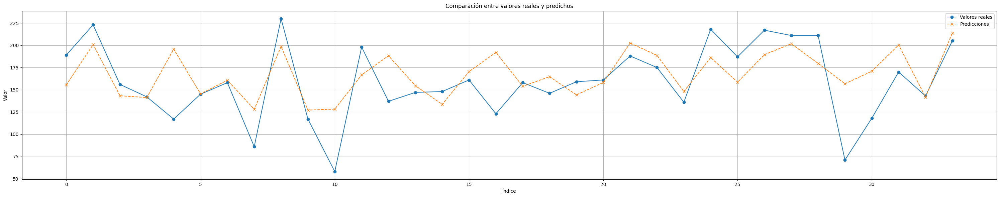

Evaluation metrics for AutoTabPFN performance in eval
MSE: 1188.7840576171875
RMSE: 34.47874791255024
R2: 0.3253970742225647
MAE: 25.760990142822266
MAPE: 0.2144690752029419


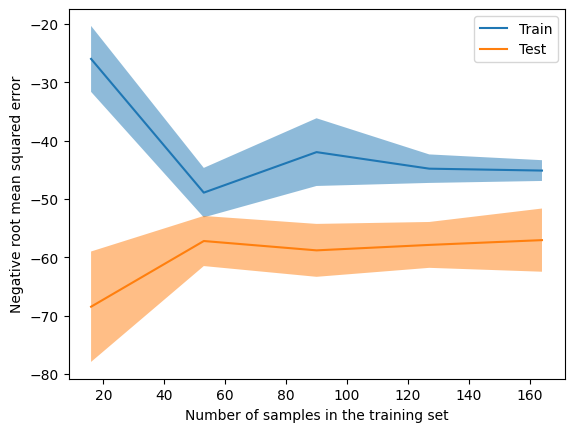

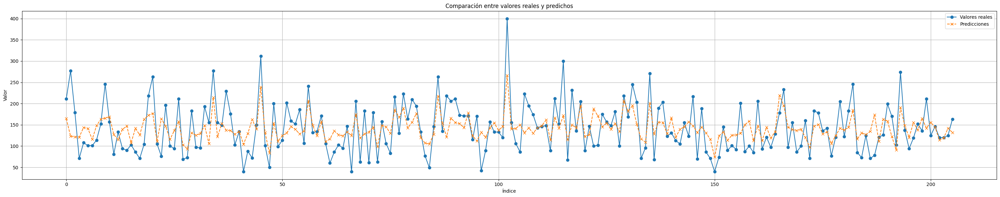

Evaluation metrics for AutoTabPFN performance in training
MSE: 2094.20361328125
RMSE: 45.76246948407887
R2: 0.41095632314682007
MAE: 37.633399963378906
MAPE: 0.3259085416793823


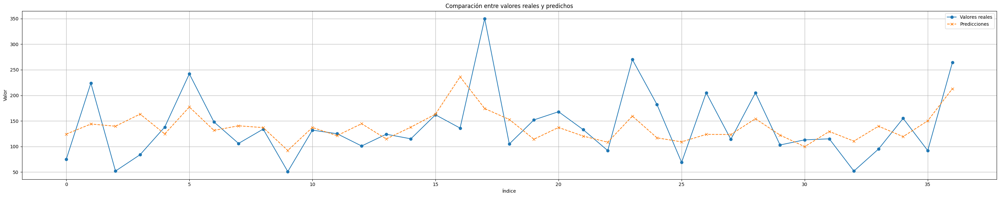

Evaluation metrics for AutoTabPFN performance in eval
MSE: 3235.455810546875
RMSE: 56.88106724163036
R2: 0.23638904094696045
MAE: 44.03241729736328
MAPE: 0.36795228719711304


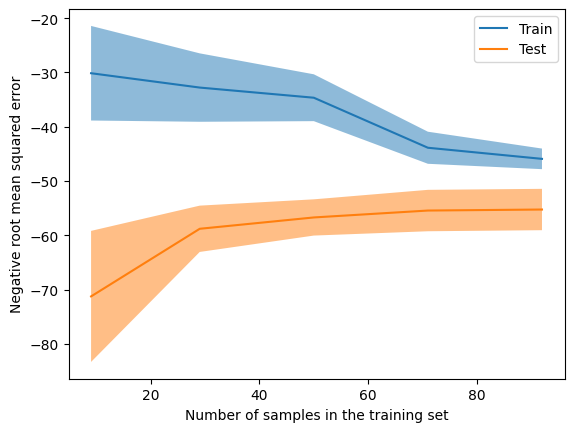

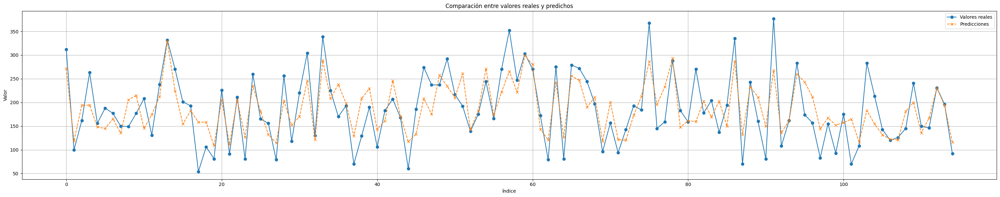

Evaluation metrics for AutoTabPFN performance in training
MSE: 2019.875
RMSE: 44.94301948022629
R2: 0.6344007849693298
MAE: 36.81010818481445
MAPE: 0.24982719123363495


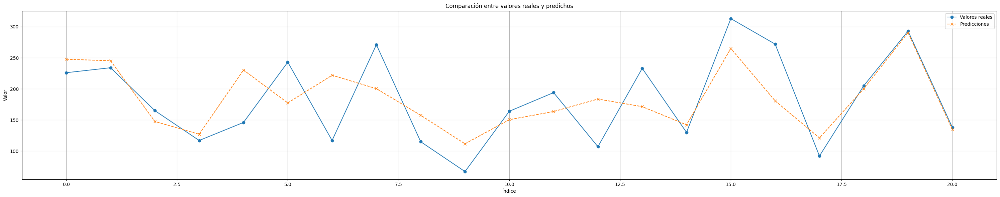

Evaluation metrics for AutoTabPFN performance in eval
MSE: 2603.35009765625
RMSE: 51.02303497104273
R2: 0.4720745086669922
MAE: 40.31647491455078
MAPE: 0.26444000005722046


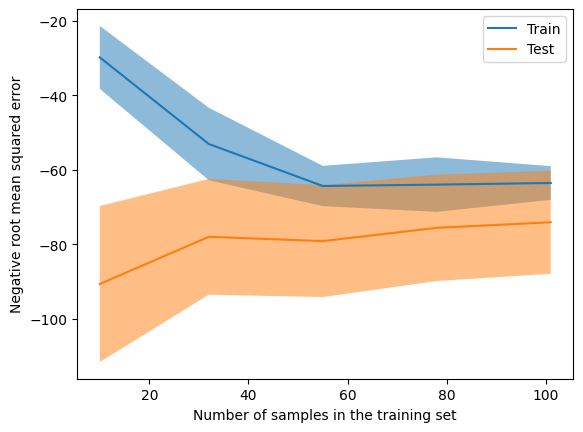

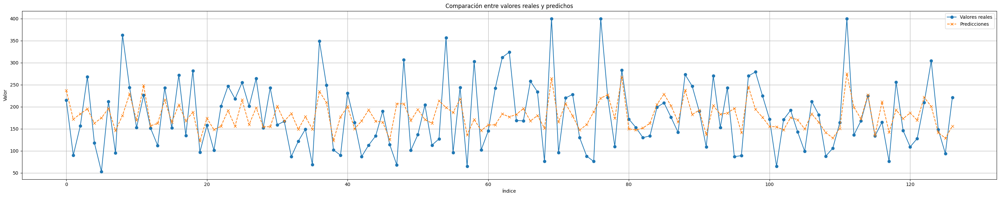

Evaluation metrics for AutoTabPFN performance in training
MSE: 4223.44775390625
RMSE: 64.98805854852297
R2: 0.33132946491241455
MAE: 51.57082748413086
MAPE: 0.3592546582221985


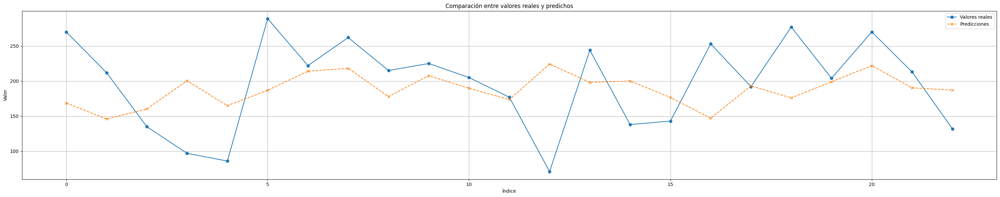

Evaluation metrics for AutoTabPFN performance in eval
MSE: 4542.4296875
RMSE: 67.39754956598942
R2: -0.15434086322784424
MAE: 53.735374450683594
MAPE: 0.3611399531364441


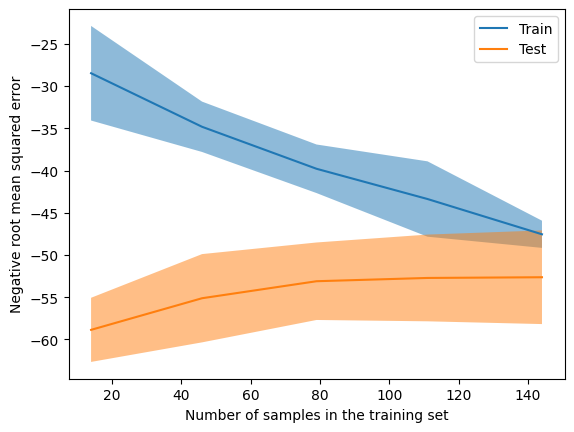

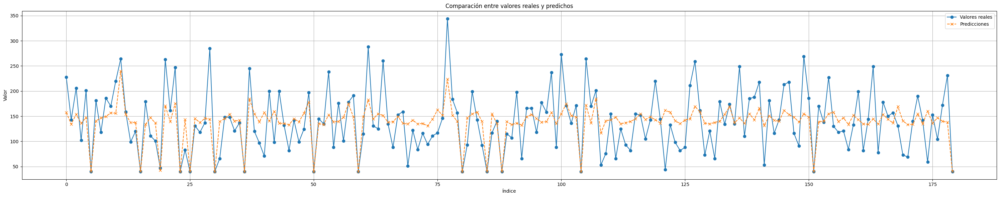

Evaluation metrics for AutoTabPFN performance in training
MSE: 2332.0234375
RMSE: 48.29102854050636
R2: 0.4000391960144043
MAE: 37.291996002197266
MAPE: 0.30850452184677124


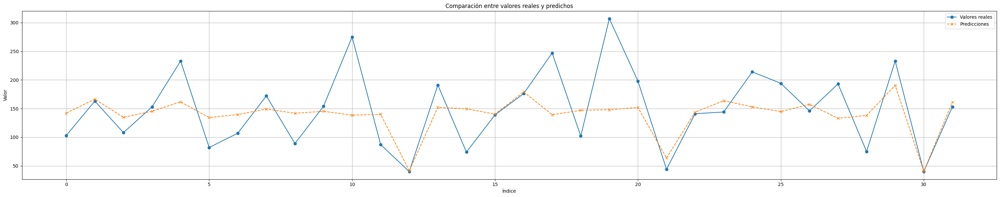

Evaluation metrics for AutoTabPFN performance in eval
MSE: 3150.53076171875
RMSE: 56.129589003650736
R2: 0.3008747696876526
MAE: 41.33438491821289
MAPE: 0.29247039556503296


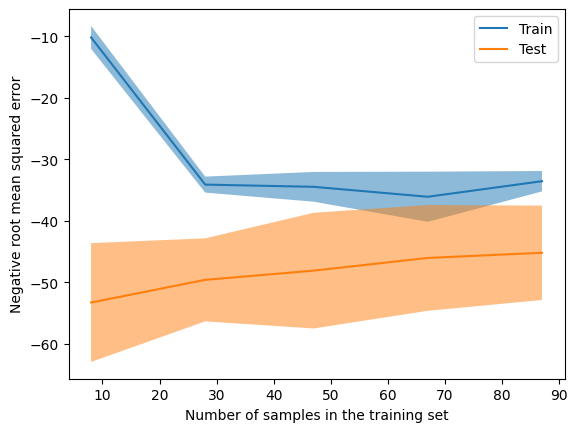

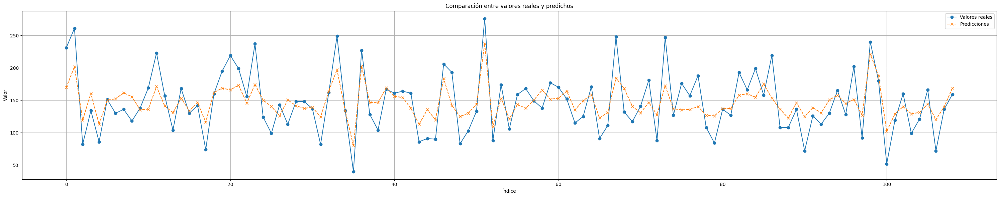

Evaluation metrics for AutoTabPFN performance in training
MSE: 954.2844848632812
RMSE: 30.891495348449567
R2: 0.5797350406646729
MAE: 25.73097801208496
MAPE: 0.20387017726898193


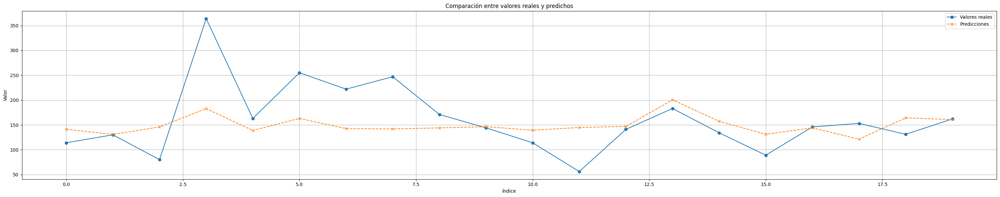

Evaluation metrics for AutoTabPFN performance in eval
MSE: 3917.447998046875
RMSE: 62.589519873912394
R2: 0.1528463363647461
MAE: 43.820716857910156
MAPE: 0.3053966164588928


In [ ]:
tabpfn_exp3 = TabPFNRegressor()
i=0
for x_train, y_train, x_eval, y_eval in zip(x_train_exp3, y_train_exp3, x_eval_exp3, y_eval_exp3):
  i+=1
  LearningCurveDisplay.from_estimator(tabpfn_exp3, x_train, y_train, cv=cv, scoring='neg_root_mean_squared_error')
  tabpfn_exp3.fit(x_train, y_train)

  # Predict on train test
  train_predictions = tabpfn_exp3.predict(x_train)
  # Predict on the test set
  predictions = tabpfn_exp3.predict(x_eval)

  # evaluate
  train_scores = evaluate_regression(y_train, train_predictions, 'tabpfn performance in training')
  eval_scores = evaluate_regression(y_eval, predictions, 'tabpfn performance in eval')

  all_scores_exp3['tabpfn_exp3_'+str(i)] = [train_scores, eval_scores]

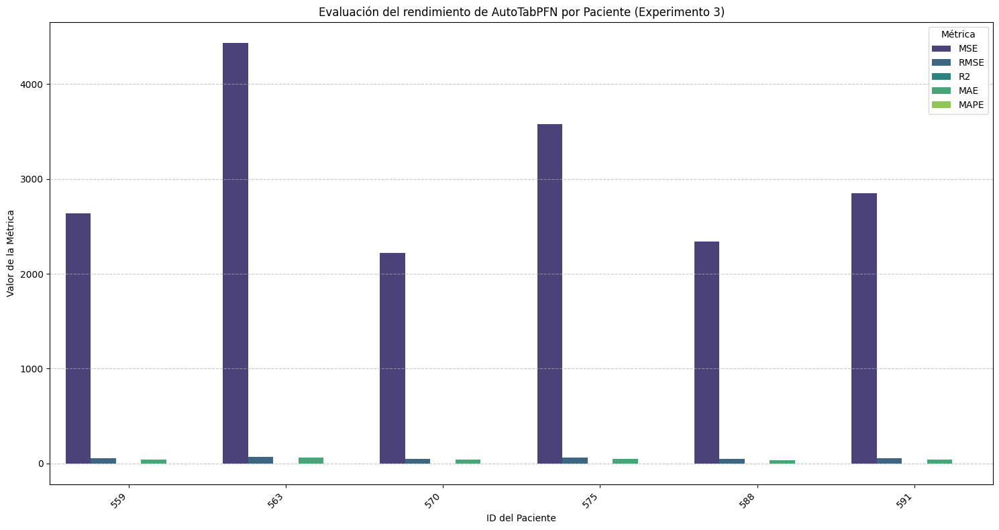

In [ ]:
# Prepare data for plotting
patient_ids = list(separated_ids_features_prepared.keys())
metrics = ['MSE', 'RMSE', 'R2', 'MAE', 'MAPE']
eval_scores_exp3 = {model_name: scores[1] for model_name, scores in all_scores_exp3.items() if 'exp3' in model_name}

data_for_plot = []
for i, patient_id in enumerate(patient_ids):
    model_name_prefix = 'tabpfn_exp3_' + str(i + 1)
    if model_name_prefix in eval_scores_exp3:
        scores = eval_scores_exp3[model_name_prefix]
        for metric_name, score_value in zip(metrics, scores):
            data_for_plot.append({
                'Patient ID': patient_id,
                'Metric': metric_name,
                'Score': score_value
            })

df_plot_exp3 = pd.DataFrame(data_for_plot)

# Create grouped bar plot
plt.figure(figsize=(15, 8))
barplot = sns.barplot(data=df_plot_exp3, x='Patient ID', y='Score', hue='Metric', palette='viridis')

plt.title('Evaluación del rendimiento de tabpfn por Paciente (Experimento 3)')
plt.xlabel('ID del Paciente')
plt.ylabel('Valor de la Métrica')
plt.xticks(rotation=45, ha='right')
plt.legend(title='Métrica')
plt.grid(axis='y', linestyle='--', alpha=0.7)
plt.tight_layout()
plt.show()


#### TabNet

Stop training because you reached max_epochs = 100 with best_epoch = 90 and best_val_0_mse = 2629.22437
Best parameters: {'momentum': 0.15, 'n_a': 32, 'n_d': 8}

Early stopping occurred at epoch 79 with best_epoch = 59 and best_val_1_mse = 2479.16064


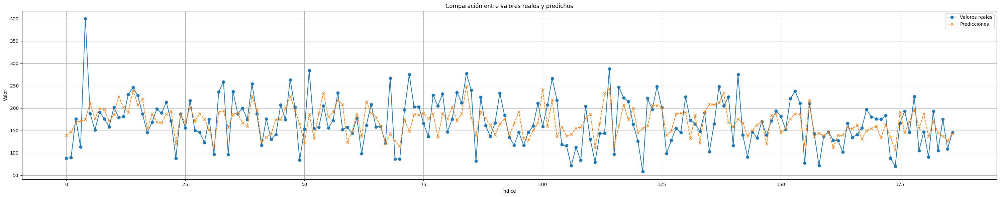

Evaluation metrics for TabNet performance in training
MSE: 1928.323486328125
RMSE: 43.912680245324644
R2: 0.31824934482574463
MAE: 34.308353424072266
MAPE: 0.23027817904949188


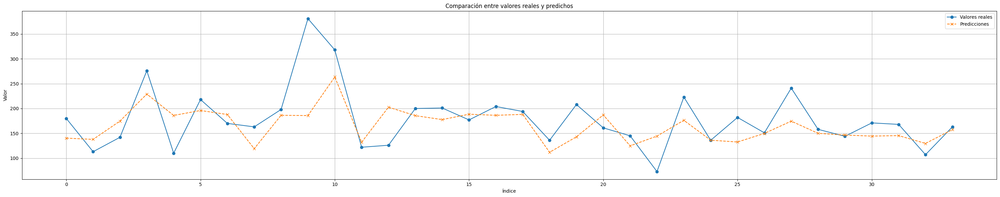

Evaluation metrics for TabNet performance in eval
MSE: 2479.16064453125
RMSE: 49.791170347073084
R2: 0.30438894033432007
MAE: 34.811370849609375
MAPE: 0.204432874917984


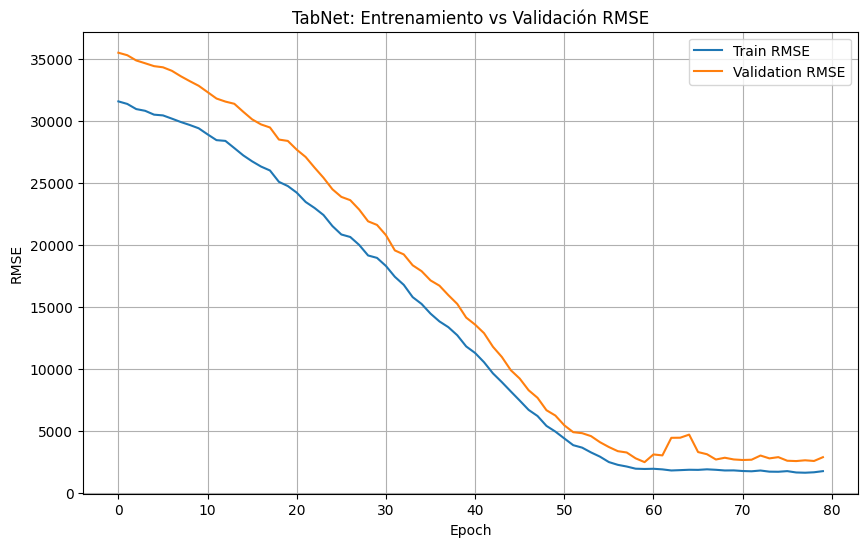


Early stopping occurred at epoch 85 with best_epoch = 65 and best_val_0_mse = 2621.35571
Best parameters: {'momentum': 0.15, 'n_a': 8, 'n_d': 32}

Early stopping occurred at epoch 58 with best_epoch = 38 and best_val_1_mse = 2203.00708


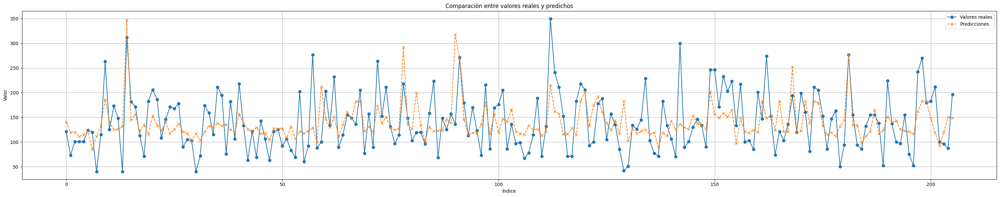

Evaluation metrics for TabNet performance in training
MSE: 2617.31787109375
RMSE: 51.15972899746196
R2: 0.26197659969329834
MAE: 40.31130599975586
MAPE: 0.35080984234809875


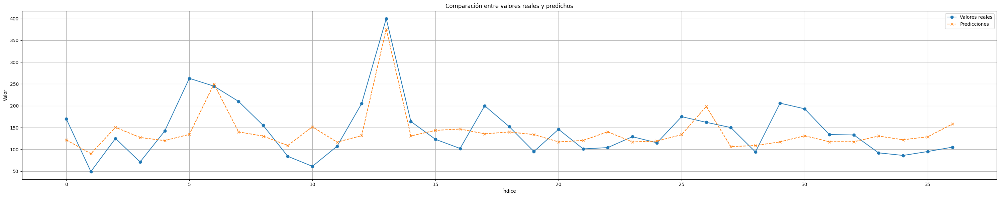

Evaluation metrics for TabNet performance in eval
MSE: 2203.007080078125
RMSE: 46.93620223322425
R2: 0.48522961139678955
MAE: 38.884849548339844
MAPE: 0.31483468413352966


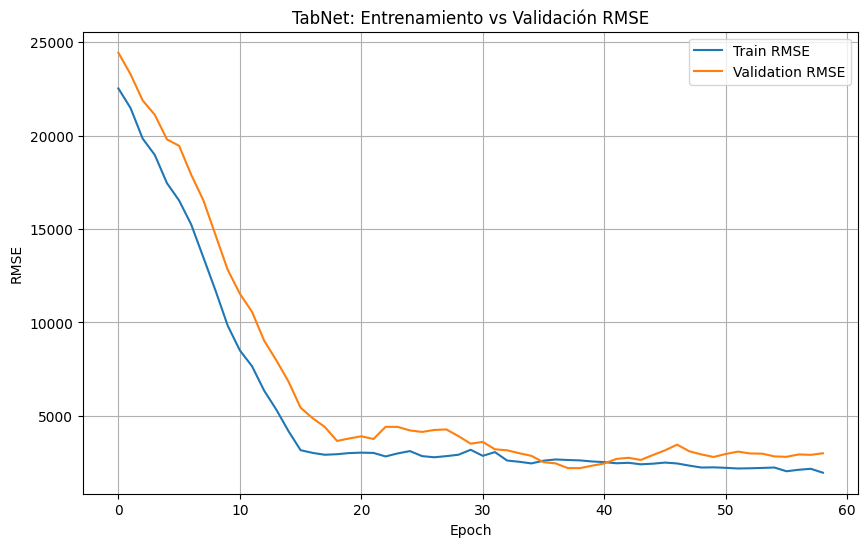


Early stopping occurred at epoch 76 with best_epoch = 56 and best_val_0_mse = 3626.1853
Best parameters: {'momentum': 0.15, 'n_a': 8, 'n_d': 32}
Stop training because you reached max_epochs = 100 with best_epoch = 99 and best_val_1_mse = 3679.07373


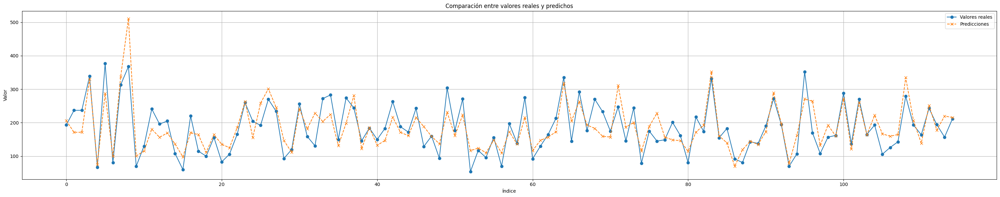

Evaluation metrics for TabNet performance in training
MSE: 1791.588134765625
RMSE: 42.32715599666041
R2: 0.6722152233123779
MAE: 33.40643310546875
MAPE: 0.20920367538928986


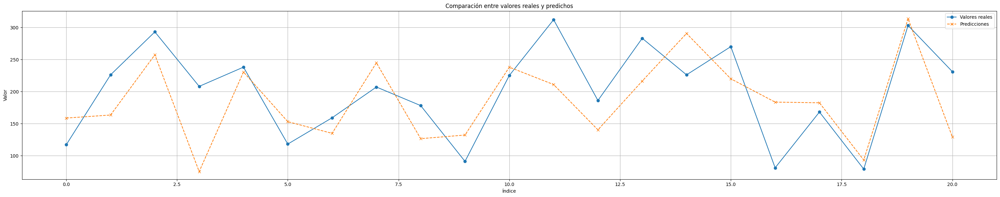

Evaluation metrics for TabNet performance in eval
MSE: 3679.07373046875
RMSE: 60.65536852141573
R2: 0.2695208787918091
MAE: 50.238094329833984
MAPE: 0.2923201024532318


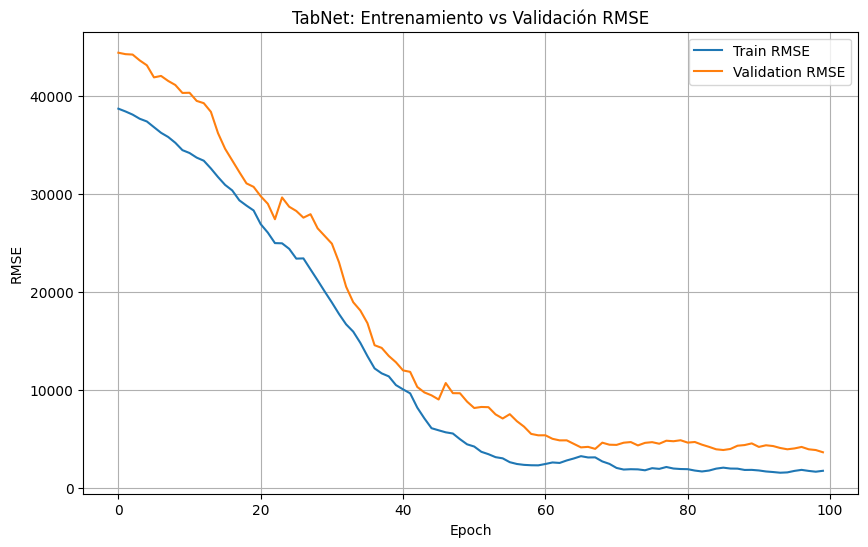


Early stopping occurred at epoch 91 with best_epoch = 71 and best_val_0_mse = 2951.5564
Best parameters: {'momentum': 0.15, 'n_a': 8, 'n_d': 32}

Early stopping occurred at epoch 95 with best_epoch = 75 and best_val_1_mse = 4489.95996


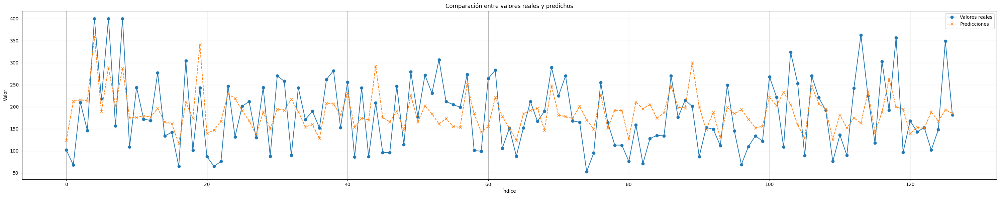

Evaluation metrics for TabNet performance in training
MSE: 4671.45947265625
RMSE: 68.34807585189395
R2: 0.2880921959877014
MAE: 56.29677963256836
MAPE: 0.3997661769390106


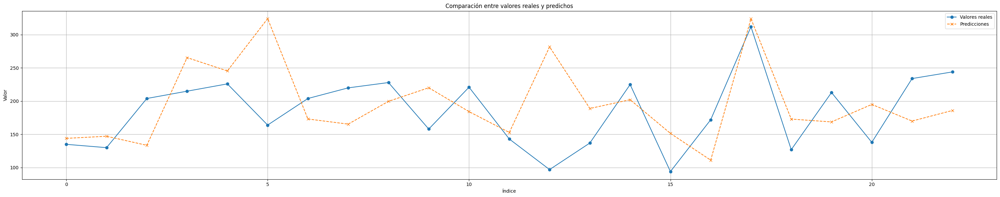

Evaluation metrics for TabNet performance in eval
MSE: 4489.9599609375
RMSE: 67.00716350463956
R2: -0.5988529920578003
MAE: 52.55018615722656
MAPE: 0.34253519773483276


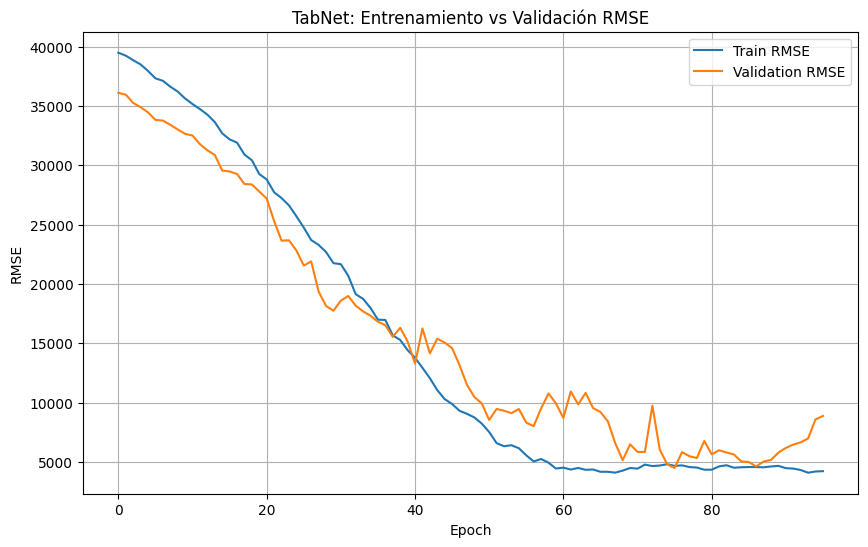


Early stopping occurred at epoch 82 with best_epoch = 62 and best_val_0_mse = 3775.98145
Best parameters: {'momentum': 0.15, 'n_a': 8, 'n_d': 16}

Early stopping occurred at epoch 63 with best_epoch = 43 and best_val_1_mse = 4355.13379


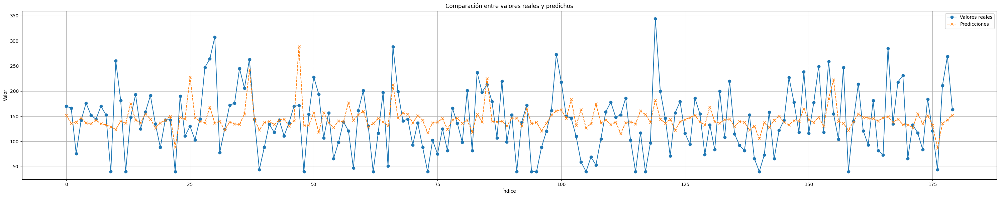

Evaluation metrics for TabNet performance in training
MSE: 3536.40966796875
RMSE: 59.46771954572287
R2: 0.11517155170440674
MAE: 48.23658752441406
MAPE: 0.505092203617096


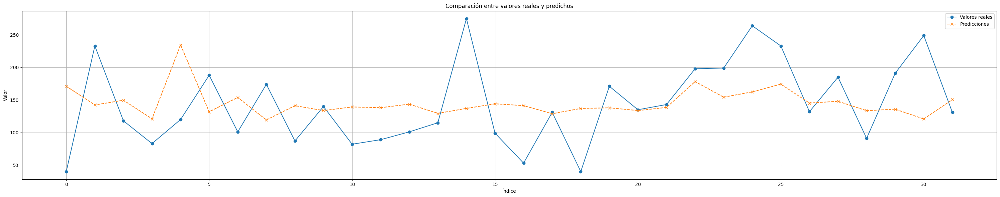

Evaluation metrics for TabNet performance in eval
MSE: 4355.1337890625
RMSE: 65.99343746966436
R2: -0.09933042526245117
MAE: 53.85552215576172
MAPE: 0.5290780067443848


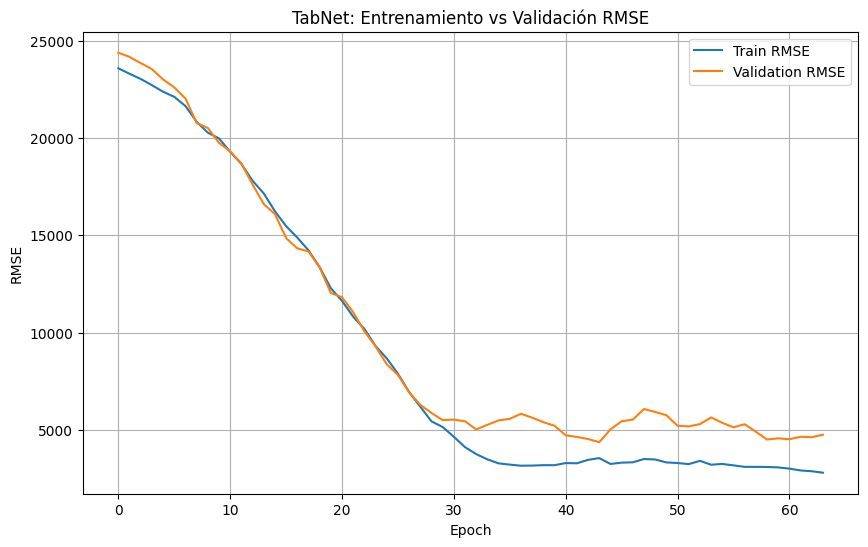


Early stopping occurred at epoch 75 with best_epoch = 55 and best_val_0_mse = 3882.854
Best parameters: {'momentum': 0.15, 'n_a': 32, 'n_d': 16}

Early stopping occurred at epoch 78 with best_epoch = 58 and best_val_1_mse = 3705.67822


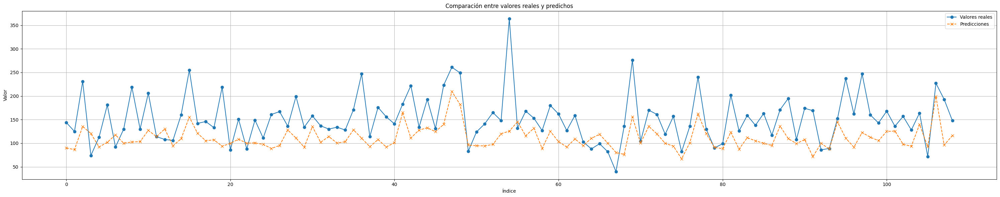

Evaluation metrics for TabNet performance in training
MSE: 3474.53564453125
RMSE: 58.945191869492206
R2: -0.3574639558792114
MAE: 46.074134826660156
MAPE: 0.2797524034976959


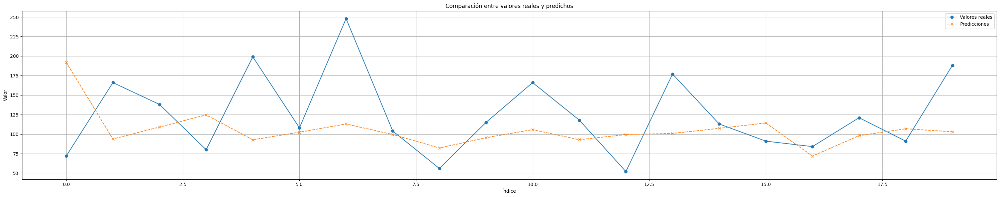

Evaluation metrics for TabNet performance in eval
MSE: 3705.67822265625
RMSE: 60.87428211204014
R2: -0.46017730236053467
MAE: 46.83880615234375
MAPE: 0.3932713270187378


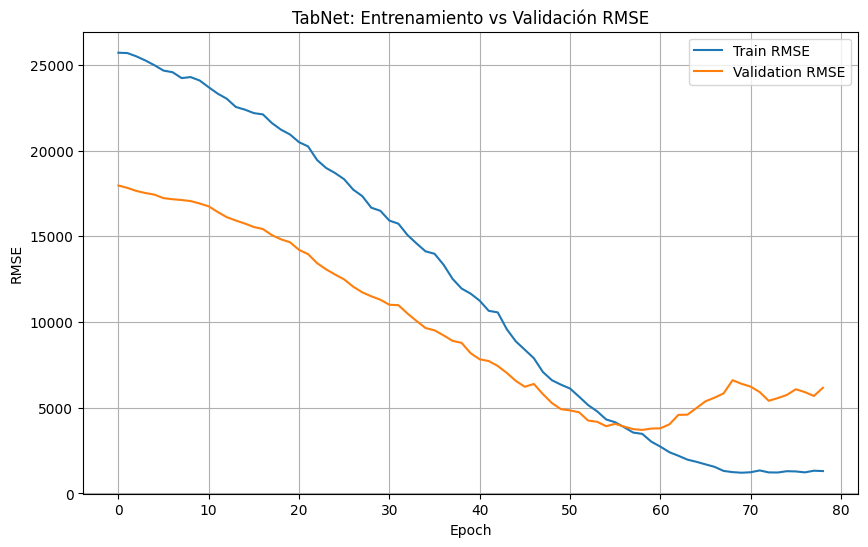

In [ ]:
parameters = {'n_d': (8, 16, 32), 'n_a': (8, 16, 32), 'momentum': (0.01, 0.02, 0.15)}

i=0
for x_train, y_train, x_eval, y_eval in zip(x_train_exp3, y_train_exp3, x_eval_exp3, y_eval_exp3):
  i+=1
  tabNet_exp3 = TabNetRegressor(verbose=0)

  grid = GridSearchCV(tabNet_exp3, parameters, n_jobs=2, cv=cv, scoring='neg_mean_squared_error')
  grid.fit(
    x_train, y_train,
    eval_set=[(x_eval, y_eval)],
    batch_size=64,
    virtual_batch_size=16,
    patience=20
  )

  best_tabNet_exp3 = grid.best_estimator_
  print('Best parameters:', grid.best_params_)
  best_tabNet_exp3.fit(
    x_train, y_train,
    eval_set=[(x_train, y_train), (x_eval, y_eval)],
    batch_size=64,
    virtual_batch_size=16,
    patience=20
  )

  # Predict on train test
  train_predictions = best_tabNet_exp3.predict(x_train)
  # Predict on the test set
  predictions = best_tabNet_exp3.predict(x_eval)

  # evaluate
  train_scores = evaluate_regression(y_train, train_predictions, 'TabNet performance in training')
  eval_scores = evaluate_regression(y_eval, predictions, 'TabNet performance in eval')

  all_scores_exp3['TabNet_exp3_'+str(i)] = [train_scores, eval_scores]

  # 4. Obtener los logs de entrenamiento
  train_rmse = best_tabNet_exp3.history['val_0_mse']
  val_rmse = best_tabNet_exp3.history['val_1_mse']

  # 5. Graficar
  plt.figure(figsize=(10, 6))
  plt.plot(train_rmse, label='Train RMSE')
  plt.plot(val_rmse, label='Validation RMSE')
  plt.xlabel("Epoch")
  plt.ylabel("RMSE")
  plt.title("TabNet: Entrenamiento vs Validación RMSE")
  plt.legend()
  plt.grid(True)
  plt.show()

#### SVM

Best parameters: {'C': 16, 'epsilon': 0.025, 'gamma': 'auto', 'kernel': 'rbf'}


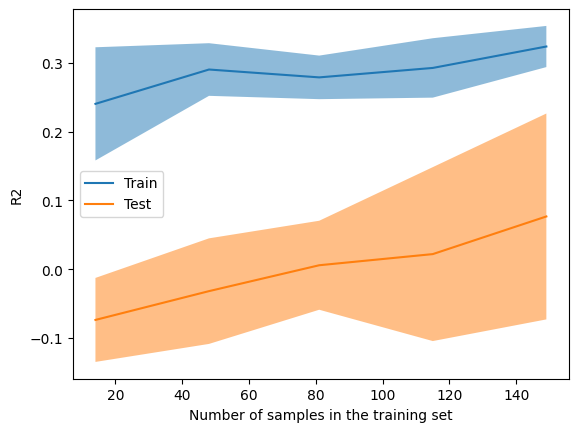

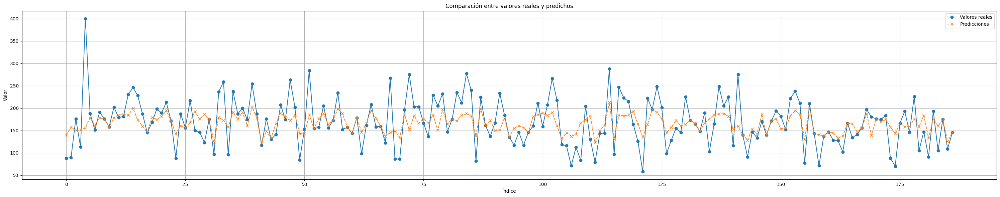

Evaluation metrics for svm_exp3 performance in training
MSE: 1903.7362097498963
RMSE: 43.63182565226782
R2: 0.3269421155244686
MAE: 30.927453200065088
MAPE: 0.2076729367560823


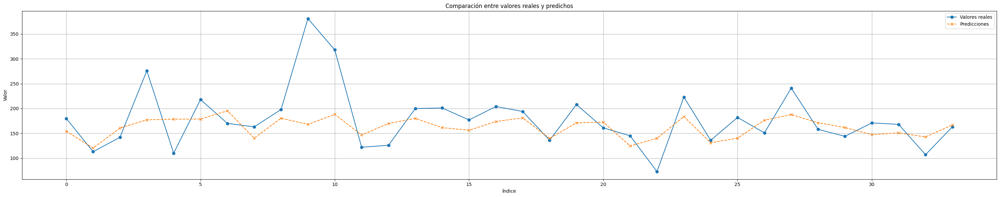

Evaluation metrics for svm_exp3 performance in eval
MSE: 3016.0644777238067
RMSE: 54.91870790289778
R2: 0.15374255064608922
MAE: 37.46872019464515
MAPE: 0.20567178966308908
Best parameters: {'C': 16, 'epsilon': 1, 'gamma': 'scale', 'kernel': 'rbf'}


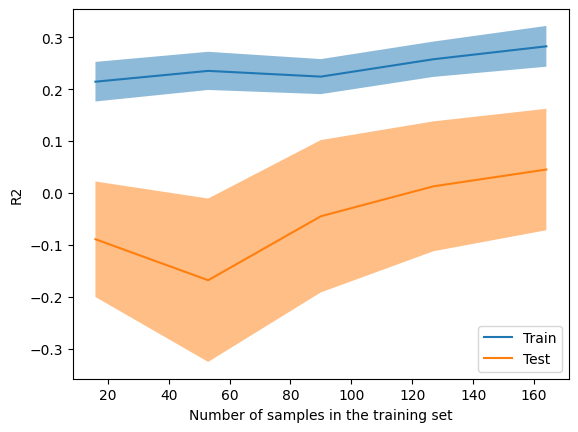

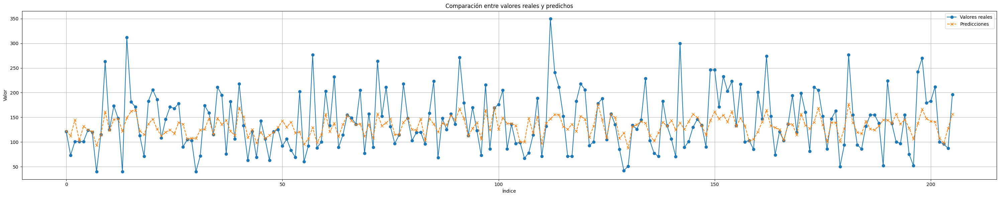

Evaluation metrics for svm_exp3 performance in training
MSE: 2516.517425131343
RMSE: 50.16490232355031
R2: 0.2904001033122061
MAE: 36.94256032223221
MAPE: 0.29813025365903745


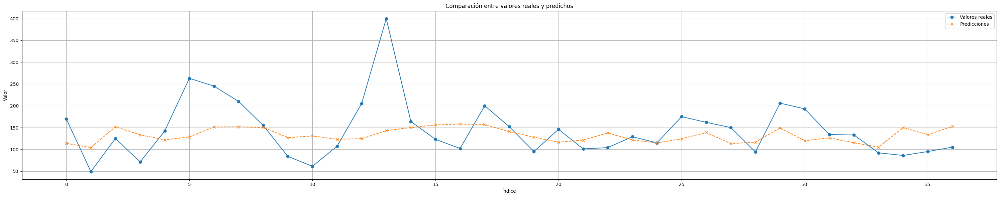

Evaluation metrics for svm_exp3 performance in eval
MSE: 4135.470324404676
RMSE: 64.3076225995385
R2: 0.033676590018505426
MAE: 46.26523837556415
MAPE: 0.33970993195949023
Best parameters: {'C': 16, 'epsilon': 1, 'gamma': 'auto', 'kernel': 'rbf'}


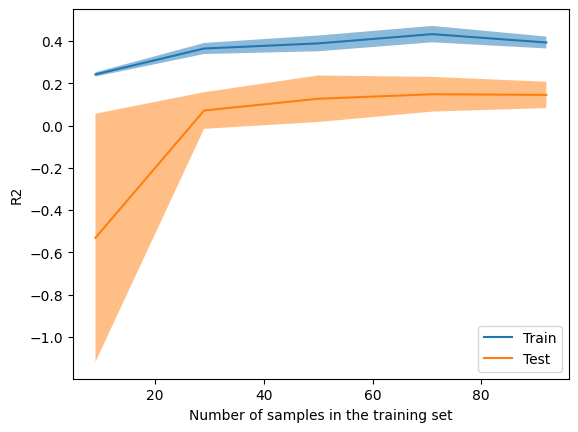

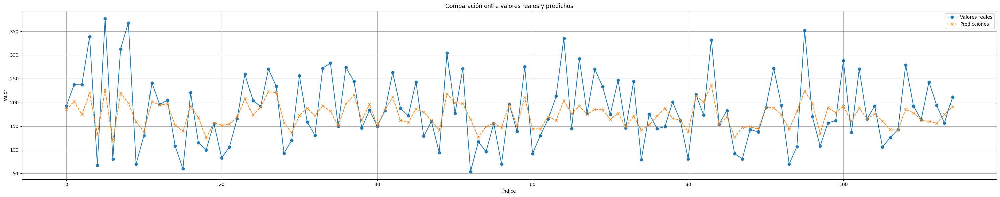

Evaluation metrics for svm_exp3 performance in training
MSE: 3161.8193054202634
RMSE: 56.23005695729165
R2: 0.4215209085797811
MAE: 42.65736885060534
MAPE: 0.27640192208903347


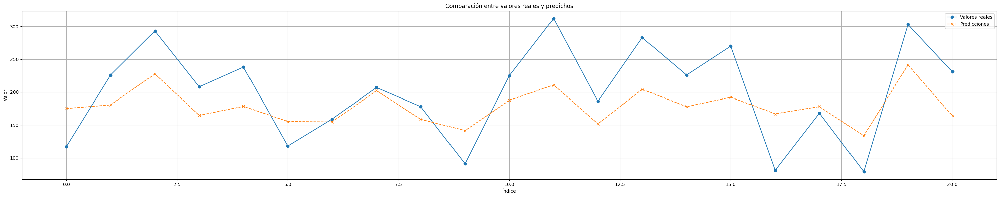

Evaluation metrics for svm_exp3 performance in eval
MSE: 3126.9598113849997
RMSE: 55.91922577597977
R2: 0.3791429689439475
MAE: 49.76988585800663
MAPE: 0.29399408049923964
Best parameters: {'C': 16, 'epsilon': 0.025, 'gamma': 'auto', 'kernel': 'rbf'}


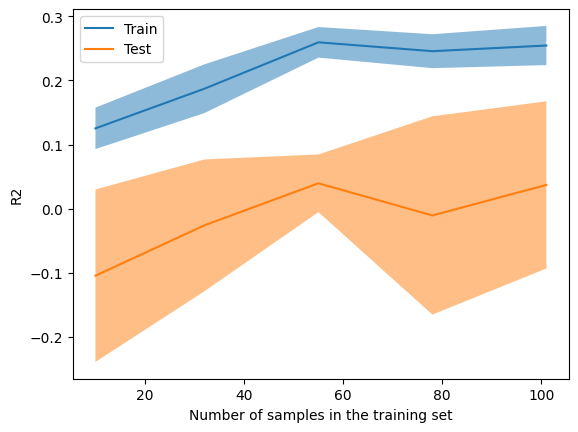

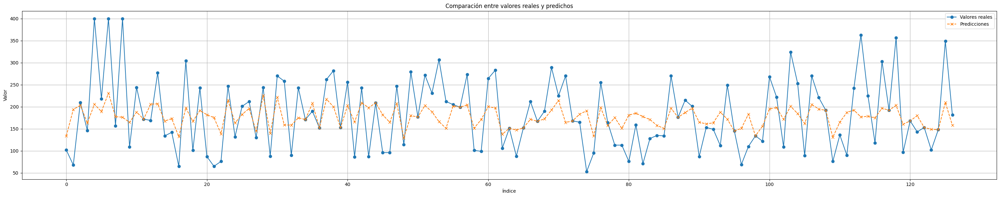

Evaluation metrics for svm_exp3 performance in training
MSE: 4820.783085382924
RMSE: 69.43185929660046
R2: 0.2653360143176312
MAE: 52.851135837047465
MAPE: 0.36663078093784723


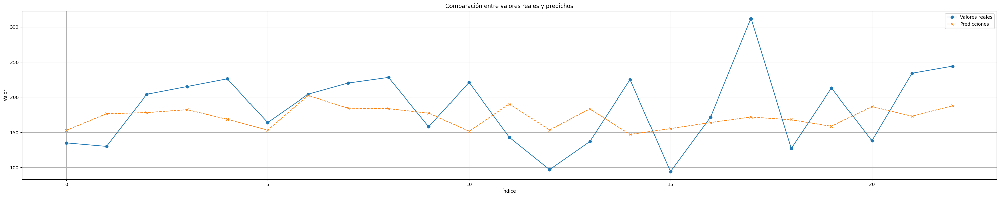

Evaluation metrics for svm_exp3 performance in eval
MSE: 2917.8884586845784
RMSE: 54.01748289845222
R2: -0.039045930649723504
MAE: 46.11581232664119
MAPE: 0.2636461954051832
Best parameters: {'C': 16, 'epsilon': 0.025, 'gamma': 'scale', 'kernel': 'poly'}


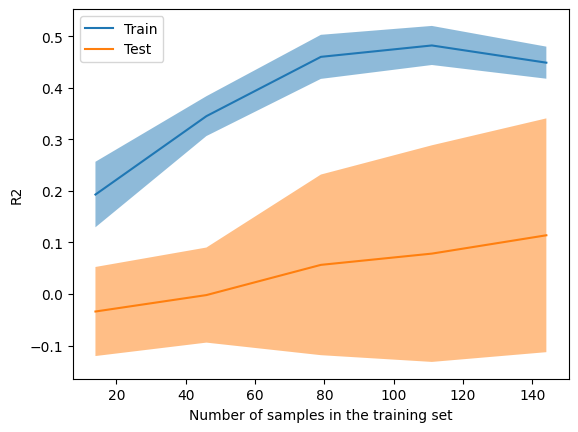

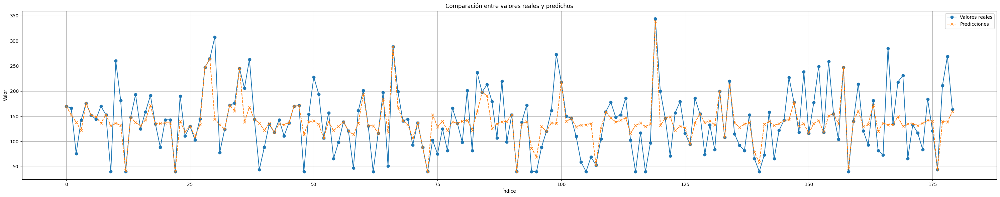

Evaluation metrics for svm_exp3 performance in training
MSE: 2194.055193799646
RMSE: 46.84074288266195
R2: 0.4510357797960791
MAE: 31.13546811823659
MAPE: 0.3114331906995298


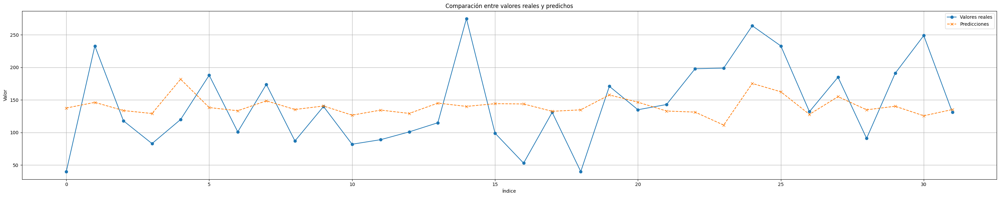

Evaluation metrics for svm_exp3 performance in eval
MSE: 3717.967875631729
RMSE: 60.97514145643066
R2: 0.061504106993563346
MAE: 49.529180090806776
MAPE: 0.47092015380658797
Best parameters: {'C': 16, 'epsilon': 1, 'gamma': 'auto', 'kernel': 'rbf'}


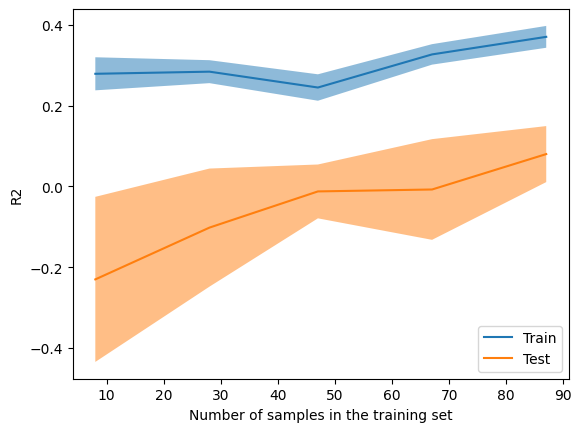

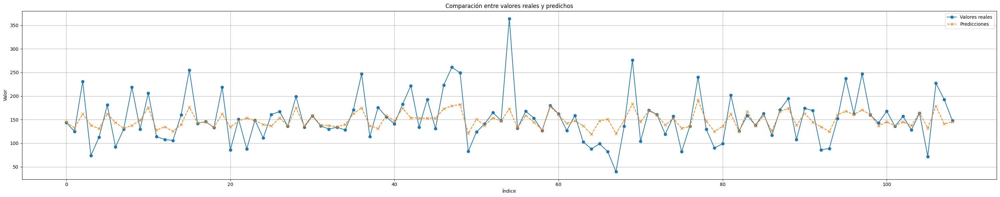

Evaluation metrics for svm_exp3 performance in training
MSE: 1559.6521900430484
RMSE: 39.49243206037137
R2: 0.3906604932234763
MAE: 26.422380695446023
MAPE: 0.1959528023653332


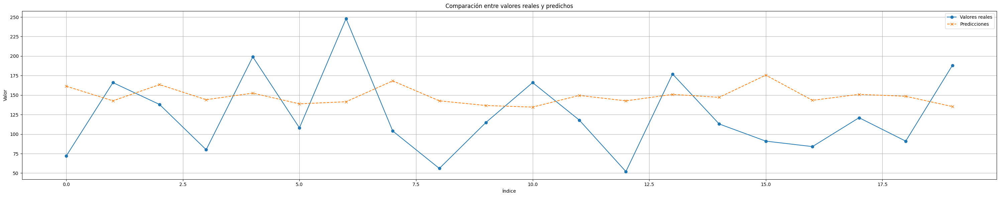

Evaluation metrics for svm_exp3 performance in eval
MSE: 3475.8726601228773
RMSE: 58.95653195467723
R2: -0.36962526417689023
MAE: 52.81302112587478
MAPE: 0.5555769763687725


In [ ]:
parameters = {'kernel':('rbf', 'poly'), 'C':(0.1, 0.25, 0.5, 1, 2, 4, 8, 16), 'gamma':('scale', 'auto'), 'epsilon': (0.025, 0.05, 0.1, 0.2, 0.4, 0.8, 1)}

i=0
for x_train, y_train, x_eval, y_eval in zip(x_train_exp3, y_train_exp3, x_eval_exp3, y_eval_exp3):
  i+=1
  svm_exp3 = svm.SVR()

  grid = GridSearchCV(svm_exp3, parameters, n_jobs=2, cv=cv)
  grid.fit(x_train, y_train)

  best_svm_exp3 = grid.best_estimator_
  print('Best parameters:', grid.best_params_)

  LearningCurveDisplay.from_estimator(best_svm_exp3, x_train, y_train, cv=cv, scoring='r2')
  best_svm_exp3.fit(x_train, y_train)

  # Predict on train test
  train_predictions = best_svm_exp3.predict(x_train)
  # Predict on the test set
  predictions = best_svm_exp3.predict(x_eval)

  # evaluate
  train_scores = evaluate_regression(y_train, train_predictions, 'svm_exp3 performance in training')
  eval_scores = evaluate_regression(y_eval, predictions, 'svm_exp3 performance in eval')

  all_scores_exp3['svm_exp3_'+str(i)] = [train_scores, eval_scores]

#### XGBoost

[0]	validation_0-rmse:59.96769
[1]	validation_0-rmse:59.62684
[2]	validation_0-rmse:59.25173
[3]	validation_0-rmse:59.01845
[4]	validation_0-rmse:58.81014
[5]	validation_0-rmse:58.62445
[6]	validation_0-rmse:58.45923
[7]	validation_0-rmse:58.44687
[8]	validation_0-rmse:58.31148
[9]	validation_0-rmse:58.15660
[10]	validation_0-rmse:58.03696
[11]	validation_0-rmse:58.05880
[12]	validation_0-rmse:57.98727
[13]	validation_0-rmse:58.05713
[14]	validation_0-rmse:57.89193
[15]	validation_0-rmse:57.67294
[16]	validation_0-rmse:57.75461
[17]	validation_0-rmse:57.56092
[18]	validation_0-rmse:57.57776
[19]	validation_0-rmse:57.55725
[20]	validation_0-rmse:57.74172
[21]	validation_0-rmse:57.42212
[22]	validation_0-rmse:57.45062
[23]	validation_0-rmse:57.20322
[24]	validation_0-rmse:57.39254
[25]	validation_0-rmse:57.59018
[26]	validation_0-rmse:57.54519
[27]	validation_0-rmse:57.75348
[28]	validation_0-rmse:57.67502
[29]	validation_0-rmse:57.70456
[30]	validation_0-rmse:57.69168
[31]	validation_0-

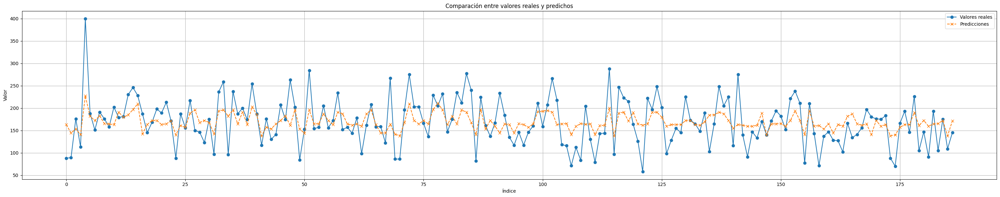

Evaluation metrics for XGB performance in training
MSE: 1888.1058349609375
RMSE: 43.45233980996809
R2: 0.3324681520462036
MAE: 34.316715240478516
MAPE: 0.24115577340126038


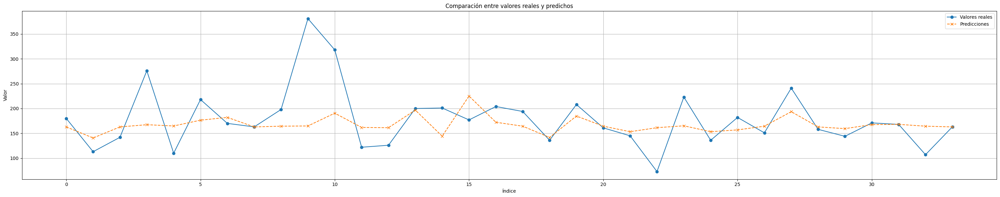

Evaluation metrics for XGB performance in eval
MSE: 3272.20849609375
RMSE: 57.20322102900981
R2: 0.08187294006347656
MAE: 37.52592849731445
MAPE: 0.2121148556470871


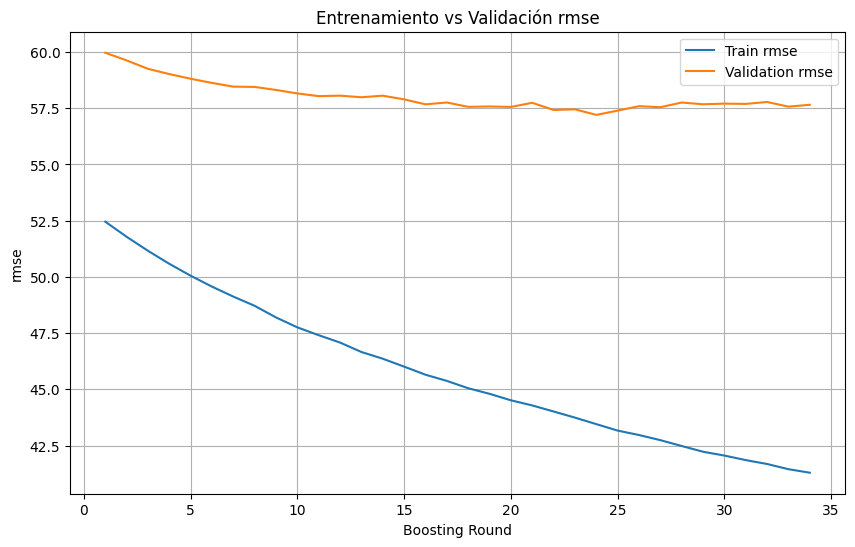

[0]	validation_0-rmse:63.86207
[1]	validation_0-rmse:64.24377
[2]	validation_0-rmse:63.78196
[3]	validation_0-rmse:62.70989
[4]	validation_0-rmse:61.64854
[5]	validation_0-rmse:61.77240
[6]	validation_0-rmse:62.40992
[7]	validation_0-rmse:61.56455
[8]	validation_0-rmse:60.82288
[9]	validation_0-rmse:60.22322
[10]	validation_0-rmse:60.12955
[11]	validation_0-rmse:61.01266
[12]	validation_0-rmse:62.27914
[13]	validation_0-rmse:61.31844
[14]	validation_0-rmse:61.32202
[15]	validation_0-rmse:60.83632
[16]	validation_0-rmse:61.55983
[17]	validation_0-rmse:61.65218
[18]	validation_0-rmse:62.42946
[19]	validation_0-rmse:62.53248
Best parameters: {'learning_rate': 0.3, 'max_depth': 2, 'n_estimators': 25}
[0]	validation_0-rmse:55.76591	validation_1-rmse:63.86207
[1]	validation_0-rmse:53.48638	validation_1-rmse:64.24377
[2]	validation_0-rmse:51.45376	validation_1-rmse:63.78196
[3]	validation_0-rmse:49.51553	validation_1-rmse:62.70989
[4]	validation_0-rmse:48.16837	validation_1-rmse:61.64854
[5]	

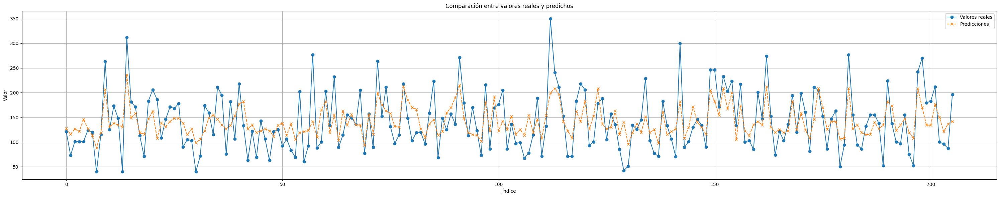

Evaluation metrics for XGB performance in training
MSE: 1864.0648193359375
RMSE: 43.174816957758345
R2: 0.4743766784667969
MAE: 35.69649887084961
MAPE: 0.3141110837459564


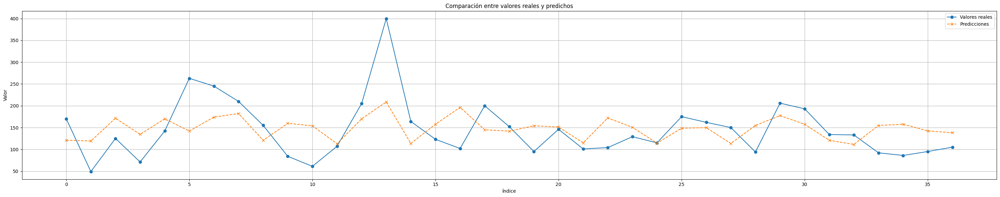

Evaluation metrics for XGB performance in eval
MSE: 3615.56298828125
RMSE: 60.12955170530751
R2: 0.15516167879104614
MAE: 47.98887252807617
MAPE: 0.40349245071411133


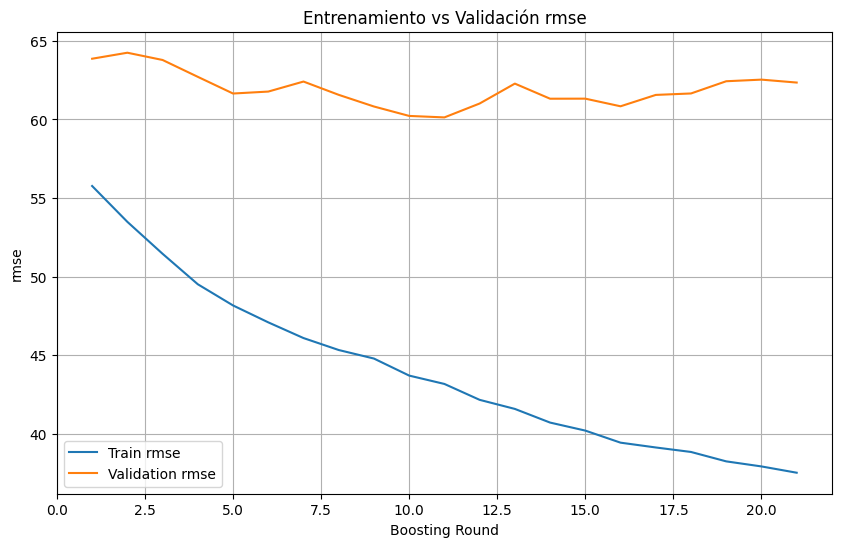

[0]	validation_0-rmse:69.71205
[1]	validation_0-rmse:66.82649
[2]	validation_0-rmse:63.41578
[3]	validation_0-rmse:60.45176
[4]	validation_0-rmse:59.37117
[5]	validation_0-rmse:58.02524
[6]	validation_0-rmse:56.95134
[7]	validation_0-rmse:56.41183
[8]	validation_0-rmse:56.04153
[9]	validation_0-rmse:55.63924
[10]	validation_0-rmse:55.83749
[11]	validation_0-rmse:55.27939
[12]	validation_0-rmse:55.10527
[13]	validation_0-rmse:55.05109
[14]	validation_0-rmse:54.77845
[15]	validation_0-rmse:54.92103
[16]	validation_0-rmse:54.71389
[17]	validation_0-rmse:54.90221
[18]	validation_0-rmse:55.12356
[19]	validation_0-rmse:55.38701
[20]	validation_0-rmse:55.11025
[21]	validation_0-rmse:55.40146
[22]	validation_0-rmse:55.56672
[23]	validation_0-rmse:55.51963
[24]	validation_0-rmse:55.32161
Best parameters: {'learning_rate': 0.1, 'max_depth': 2, 'n_estimators': 25}
[0]	validation_0-rmse:70.20048	validation_1-rmse:69.71205
[1]	validation_0-rmse:66.95425	validation_1-rmse:66.82649
[2]	validation_0-r

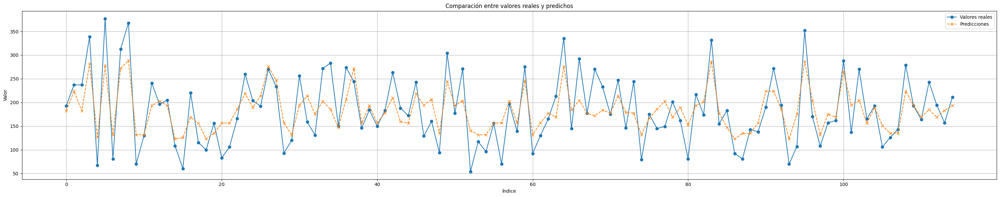

Evaluation metrics for XGB performance in training
MSE: 1952.1334228515625
RMSE: 44.182953985123746
R2: 0.642842173576355
MAE: 36.45909118652344
MAPE: 0.251102477312088


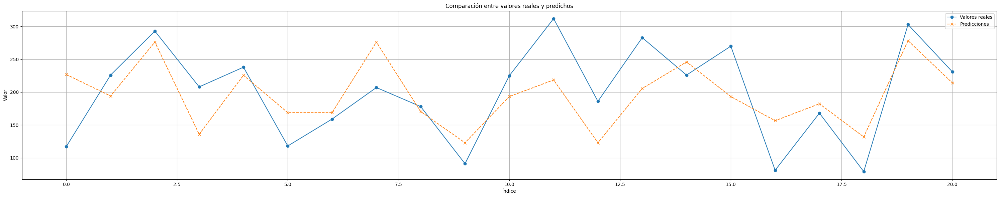

Evaluation metrics for XGB performance in eval
MSE: 2993.610107421875
RMSE: 54.71389318465535
R2: 0.4056195020675659
MAE: 45.65294647216797
MAPE: 0.286700576543808


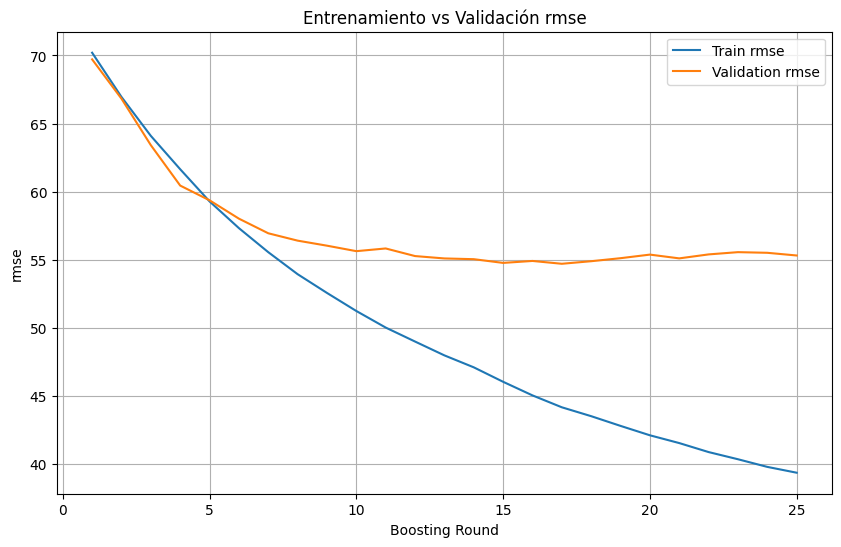

[0]	validation_0-rmse:52.72032
[1]	validation_0-rmse:70.65339
[2]	validation_0-rmse:74.76700
[3]	validation_0-rmse:75.41198
[4]	validation_0-rmse:71.35856
[5]	validation_0-rmse:71.51389
[6]	validation_0-rmse:72.80323
[7]	validation_0-rmse:71.52597
[8]	validation_0-rmse:71.65529
[9]	validation_0-rmse:71.52141
Best parameters: {'learning_rate': 0.9, 'max_depth': 2, 'n_estimators': 25}
[0]	validation_0-rmse:70.55314	validation_1-rmse:52.72032
[1]	validation_0-rmse:63.41277	validation_1-rmse:70.65339
[2]	validation_0-rmse:58.68819	validation_1-rmse:74.76700
[3]	validation_0-rmse:54.96295	validation_1-rmse:75.41198
[4]	validation_0-rmse:52.55942	validation_1-rmse:71.35856
[5]	validation_0-rmse:49.49037	validation_1-rmse:71.51389
[6]	validation_0-rmse:46.96102	validation_1-rmse:72.80323
[7]	validation_0-rmse:44.20889	validation_1-rmse:71.52597
[8]	validation_0-rmse:42.61587	validation_1-rmse:71.65529
[9]	validation_0-rmse:41.51617	validation_1-rmse:71.52141
[10]	validation_0-rmse:40.68930	va

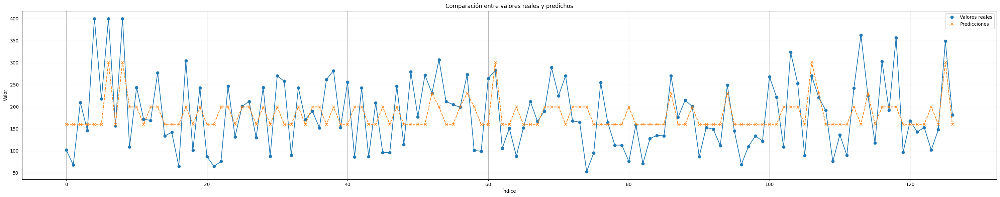

Evaluation metrics for XGB performance in training
MSE: 4977.74609375
RMSE: 70.55314375525728
R2: 0.24141567945480347
MAE: 56.13387680053711
MAPE: 0.4027750790119171


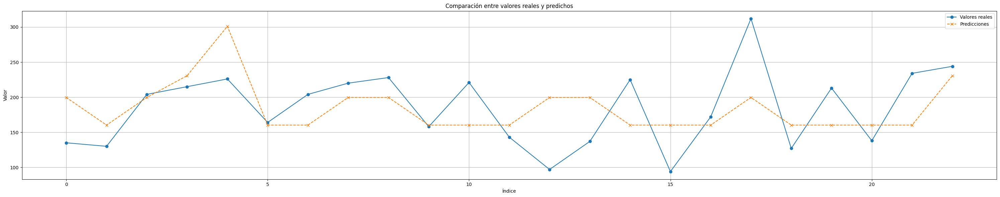

Evaluation metrics for XGB performance in eval
MSE: 2779.43212890625
RMSE: 52.7203198862284
R2: 0.01025766134262085
MAE: 42.700836181640625
MAPE: 0.2599273920059204


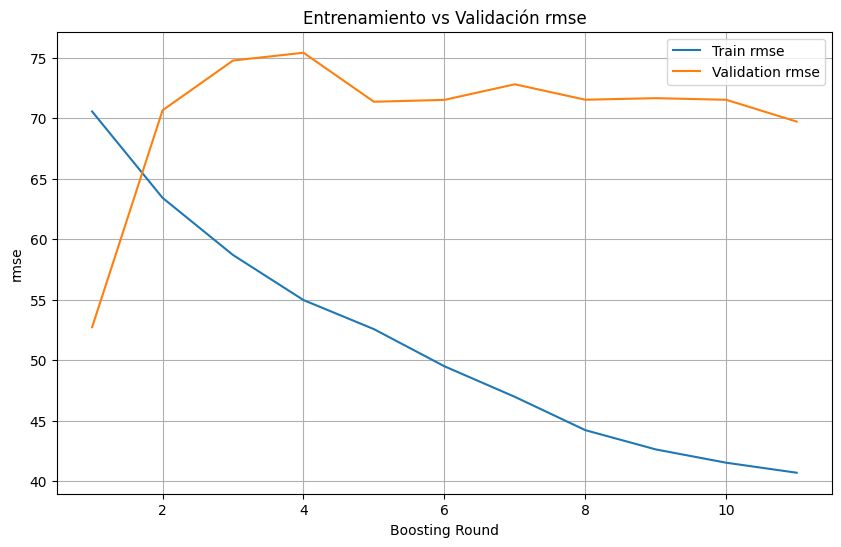

[0]	validation_0-rmse:59.25999
[1]	validation_0-rmse:57.24202
[2]	validation_0-rmse:56.52411
[3]	validation_0-rmse:55.83764
[4]	validation_0-rmse:53.60586
[5]	validation_0-rmse:53.80380
[6]	validation_0-rmse:53.82615
[7]	validation_0-rmse:53.67546
[8]	validation_0-rmse:53.64187
[9]	validation_0-rmse:53.66896
[10]	validation_0-rmse:52.57035
[11]	validation_0-rmse:52.56056
[12]	validation_0-rmse:53.15335
[13]	validation_0-rmse:53.44383
[14]	validation_0-rmse:53.51400
[15]	validation_0-rmse:53.59419
[16]	validation_0-rmse:53.89070
[17]	validation_0-rmse:53.96564
[18]	validation_0-rmse:53.31729
[19]	validation_0-rmse:53.95488
[20]	validation_0-rmse:53.76076
Best parameters: {'learning_rate': 0.3, 'max_depth': 2, 'n_estimators': 25}
[0]	validation_0-rmse:58.18713	validation_1-rmse:59.25999
[1]	validation_0-rmse:54.99683	validation_1-rmse:57.24202
[2]	validation_0-rmse:52.60505	validation_1-rmse:56.52411
[3]	validation_0-rmse:51.10781	validation_1-rmse:55.83764
[4]	validation_0-rmse:49.40682

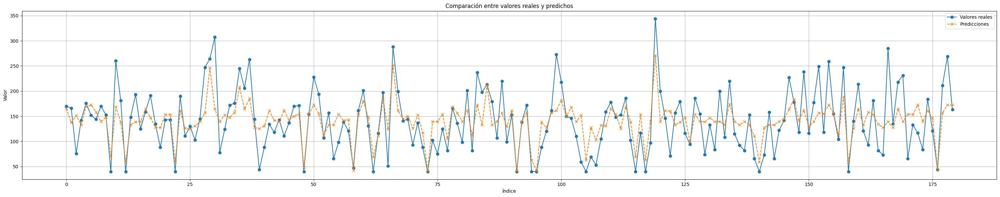

Evaluation metrics for XGB performance in training
MSE: 1895.4635009765625
RMSE: 43.5369211242201
R2: 0.5257450342178345
MAE: 33.78751754760742
MAPE: 0.2983497083187103


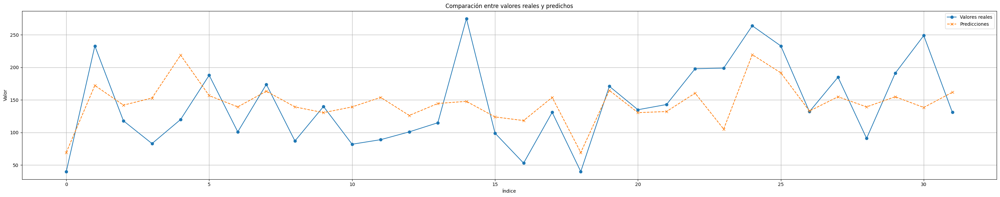

Evaluation metrics for XGB performance in eval
MSE: 2762.61279296875
RMSE: 52.56056309600145
R2: 0.30265647172927856
MAE: 42.721553802490234
MAPE: 0.3641749620437622


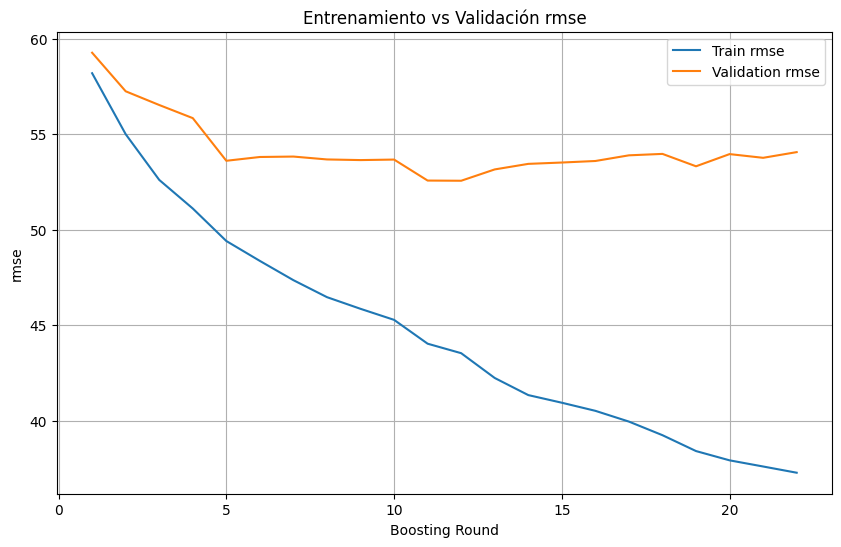

[0]	validation_0-rmse:59.11517
[1]	validation_0-rmse:61.19459
[2]	validation_0-rmse:63.02628
[3]	validation_0-rmse:63.38199
[4]	validation_0-rmse:64.47197
[5]	validation_0-rmse:66.53780
[6]	validation_0-rmse:67.75813
[7]	validation_0-rmse:68.24651
[8]	validation_0-rmse:68.21827
[9]	validation_0-rmse:68.28081
[10]	validation_0-rmse:67.90364
Best parameters: {'learning_rate': 0.3, 'max_depth': 6, 'n_estimators': 25}
[0]	validation_0-rmse:40.80573	validation_1-rmse:59.11517
[1]	validation_0-rmse:32.74462	validation_1-rmse:61.19459
[2]	validation_0-rmse:27.08457	validation_1-rmse:63.02628
[3]	validation_0-rmse:22.31611	validation_1-rmse:63.38199
[4]	validation_0-rmse:18.92754	validation_1-rmse:64.47197
[5]	validation_0-rmse:15.61760	validation_1-rmse:66.53780
[6]	validation_0-rmse:13.70705	validation_1-rmse:67.75813
[7]	validation_0-rmse:11.81272	validation_1-rmse:68.24651
[8]	validation_0-rmse:10.33553	validation_1-rmse:68.21827
[9]	validation_0-rmse:8.95225	validation_1-rmse:68.28081


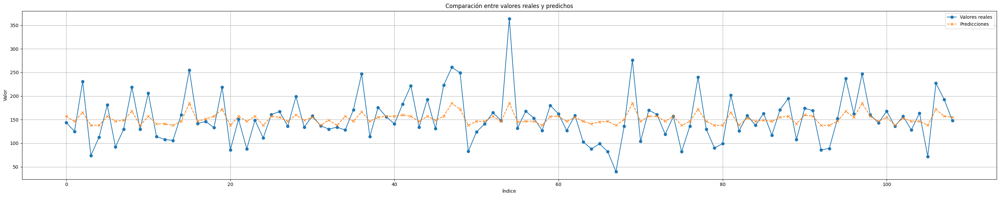

Evaluation metrics for XGB performance in training
MSE: 1665.1075439453125
RMSE: 40.805729302946084
R2: 0.34946030378341675
MAE: 30.146188735961914
MAPE: 0.23013609647750854


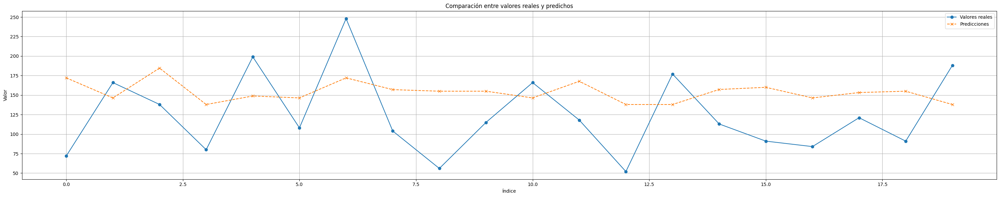

Evaluation metrics for XGB performance in eval
MSE: 3494.60302734375
RMSE: 59.11516748977161
R2: -0.3770056962966919
MAE: 54.840675354003906
MAPE: 0.5824257135391235


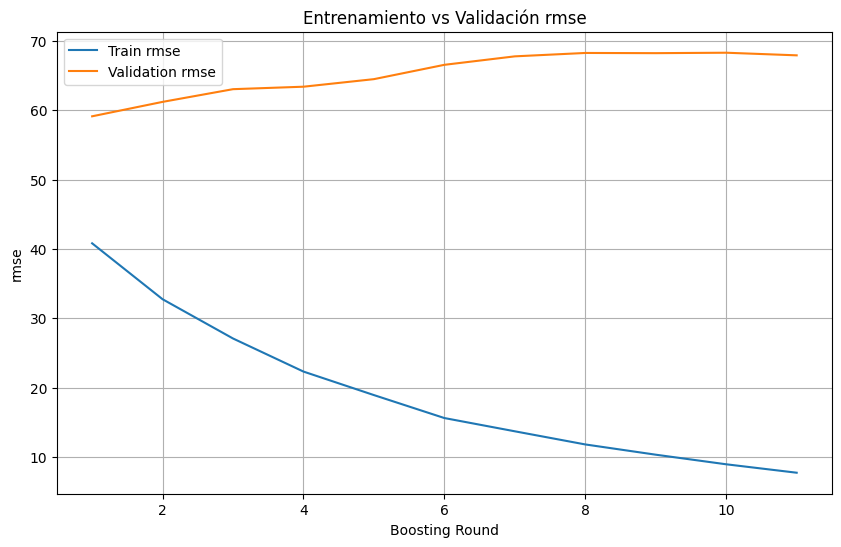

In [ ]:
parameters = { 'max_depth':(2, 3, 6, 12), 'learning_rate':(0.05, 0.1, 0.3, 0.9), 'n_estimators':(25, 50, 75, 150, 300)  }

i=0
for x_train, y_train, x_eval, y_eval in zip(x_train_exp3, y_train_exp3, x_eval_exp3, y_eval_exp3):
  i+=1
  XGB_exp3 = xgb.XGBRegressor(tree_method="hist", early_stopping_rounds=10, verbosity=0) #hist porque es más rápido

  grid = GridSearchCV(XGB_exp3, parameters, n_jobs=2, cv=cv)
  grid.fit(x_train, y_train, eval_set=[(x_eval, y_eval)])

  best_XGB_exp3 = grid.best_estimator_
  print('Best parameters:', grid.best_params_)
  best_XGB_exp3.fit(x_train, y_train, eval_set=[(x_train, y_train),(x_eval, y_eval)])
  # Predict on train test
  train_predictions = best_XGB_exp3.predict(x_train)
  # Predict on the test set
  predictions = best_XGB_exp3.predict(x_eval)

  # evaluate
  train_scores = evaluate_regression(y_train, train_predictions, 'XGB performance in training')
  eval_scores = evaluate_regression(y_eval, predictions, 'XGB performance in eval')

  all_scores_exp3['XGB_exp3_'+str(i)] = [train_scores, eval_scores]

  # 4. Obtener resultados
  results = best_XGB_exp3.evals_result()

  # 5. Graficar
  epochs = range(1, len(results['validation_0']['rmse']) + 1)
  train_rmse = results['validation_0']['rmse']
  val_rmse = results['validation_1']['rmse']

  plt.figure(figsize=(10, 6))
  plt.plot(epochs, train_rmse, label='Train rmse')
  plt.plot(epochs, val_rmse, label='Validation rmse')
  plt.xlabel("Boosting Round")
  plt.ylabel("rmse")
  plt.title("Entrenamiento vs Validación rmse")
  plt.legend()
  plt.grid(True)
  plt.show()

#### RandomForest

Best parameters: {'max_depth': 10, 'max_features': 'sqrt', 'min_samples_leaf': 1, 'min_samples_split': 2, 'n_estimators': 100}


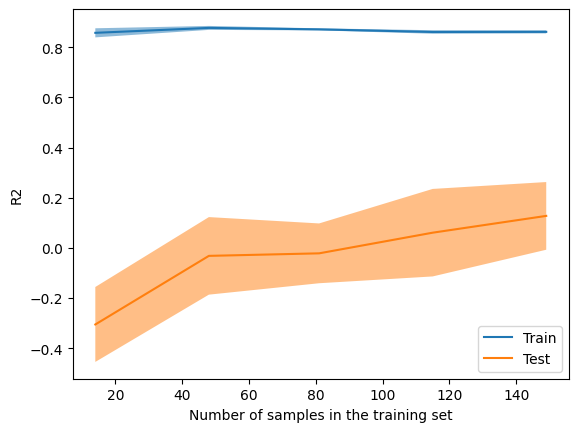

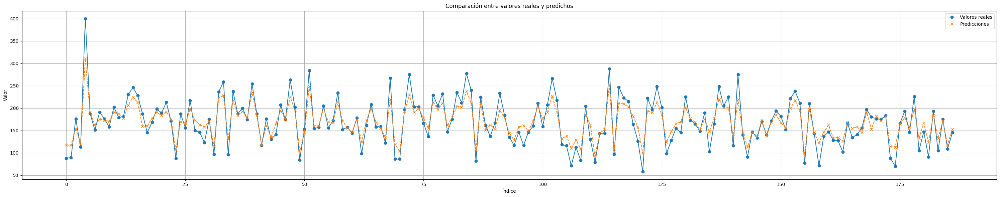

Evaluation metrics for rf_exp3 performance in training
MSE: 446.2030966591406
RMSE: 21.12351998742493
R2: 0.8422467825396425
MAE: 16.652484453234752
MAPE: 0.11400535080183812


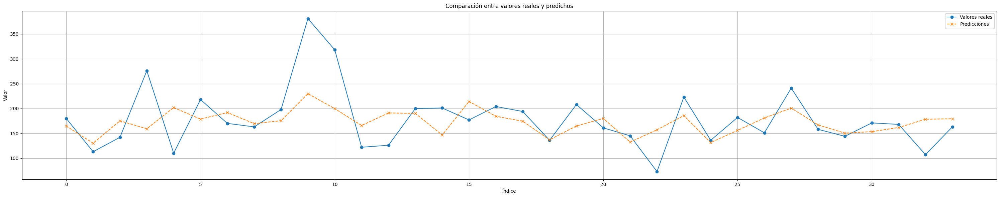

Evaluation metrics for rf_exp3 performance in eval
MSE: 2775.766568344541
RMSE: 52.685544206589924
R2: 0.22116614101635979
MAE: 38.48272203143256
MAPE: 0.23096993849354724
Best parameters: {'max_depth': None, 'max_features': 'sqrt', 'min_samples_leaf': 2, 'min_samples_split': 5, 'n_estimators': 100}


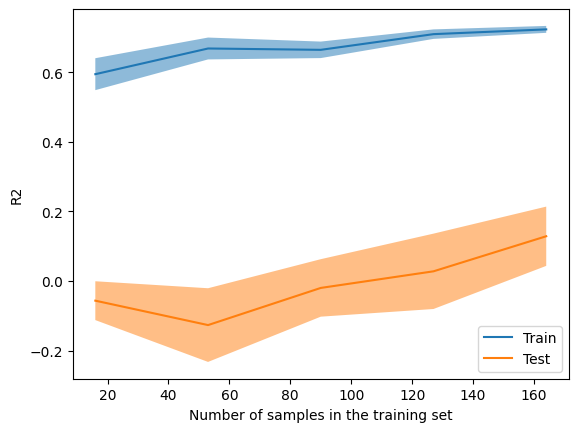

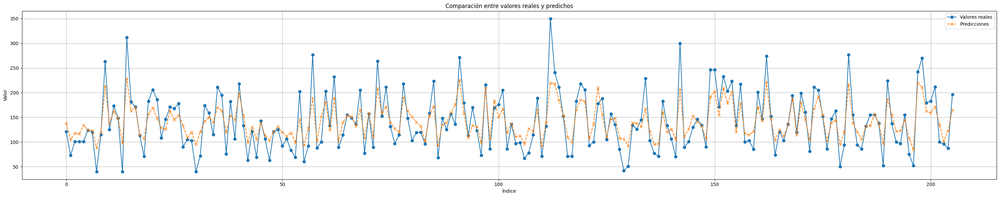

Evaluation metrics for rf_exp3 performance in training
MSE: 946.7057257512519
RMSE: 30.76858342126351
R2: 0.733050811221079
MAE: 24.43465143944513
MAPE: 0.2169915147402353


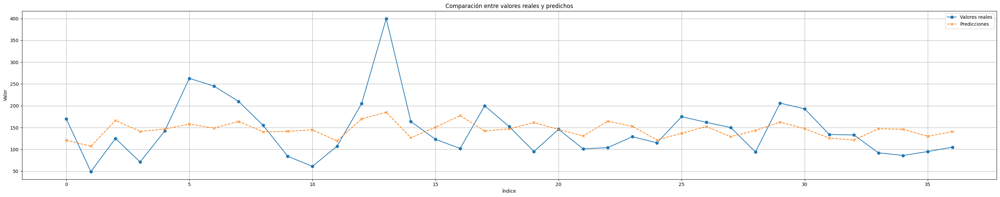

Evaluation metrics for rf_exp3 performance in eval
MSE: 3556.634295280373
RMSE: 59.63752422158697
R2: 0.1689315336177113
MAE: 45.766234637911104
MAPE: 0.3702509537672226
Best parameters: {'max_depth': 10, 'max_features': 'sqrt', 'min_samples_leaf': 1, 'min_samples_split': 2, 'n_estimators': 200}


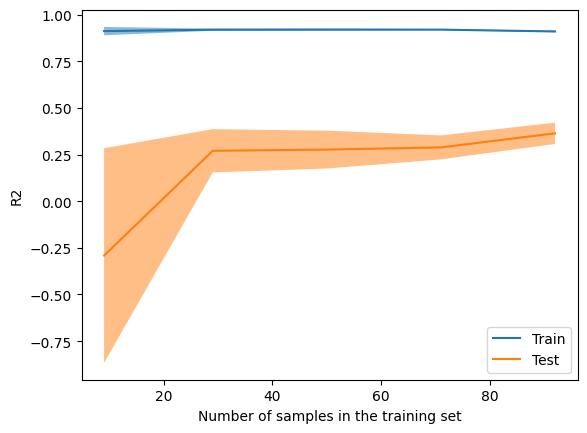

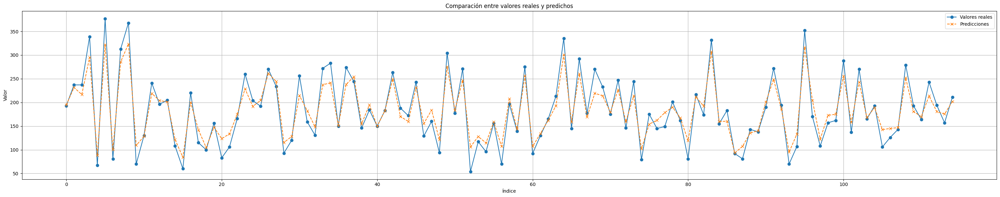

Evaluation metrics for rf_exp3 performance in training
MSE: 512.5001140909999
RMSE: 22.638465365192047
R2: 0.9062341735203259
MAE: 18.796772410824545
MAPE: 0.12658642741071827


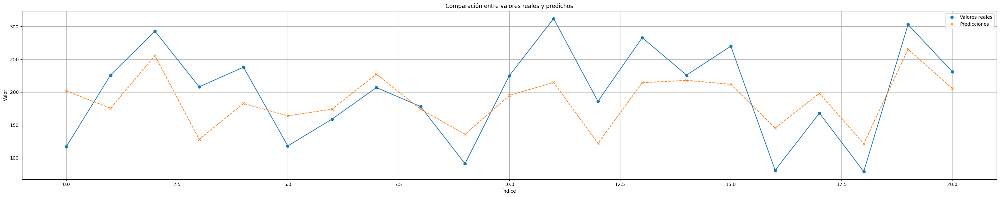

Evaluation metrics for rf_exp3 performance in eval
MSE: 2707.5951633898417
RMSE: 52.034557395925276
R2: 0.46240770721662094
MAE: 45.92504788912661
MAPE: 0.2770871406707441
Best parameters: {'max_depth': 10, 'max_features': 'sqrt', 'min_samples_leaf': 1, 'min_samples_split': 10, 'n_estimators': 25}


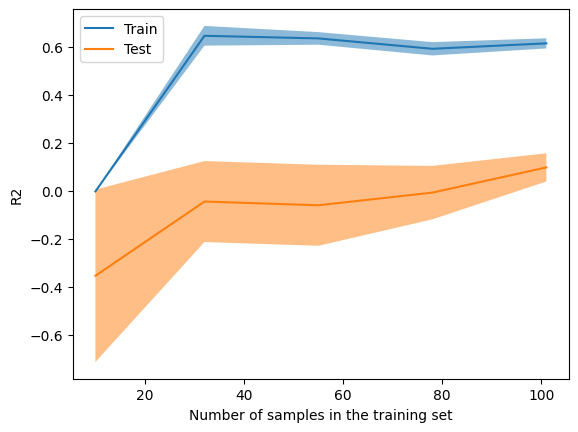

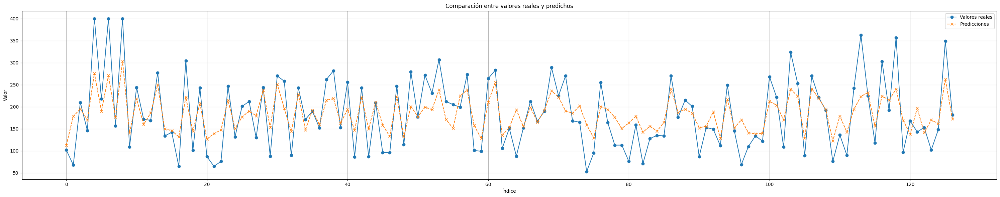

Evaluation metrics for rf_exp3 performance in training
MSE: 2580.56362258371
RMSE: 50.79924824821436
R2: 0.6067346066611727
MAE: 40.34349118679705
MAPE: 0.2937800197486657


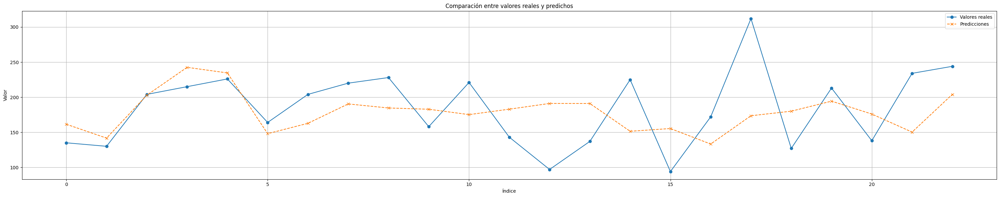

Evaluation metrics for rf_exp3 performance in eval
MSE: 2848.7840577962943
RMSE: 53.374001703041664
R2: -0.01443818859596191
MAE: 43.90532355631788
MAPE: 0.2626440466947166
Best parameters: {'max_depth': 10, 'max_features': 'sqrt', 'min_samples_leaf': 1, 'min_samples_split': 5, 'n_estimators': 100}


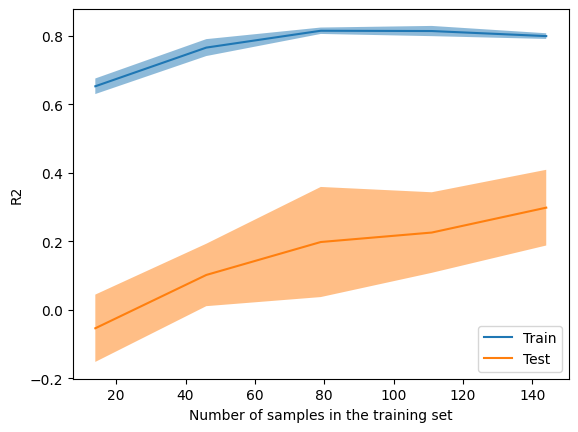

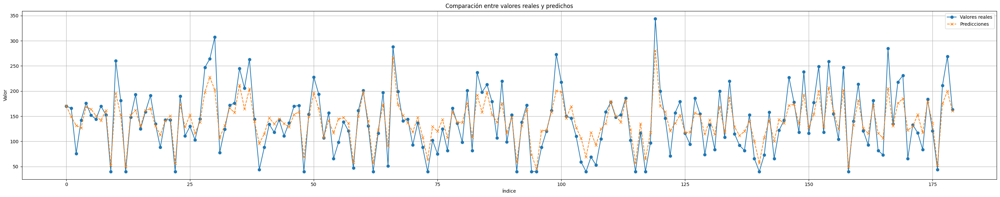

Evaluation metrics for rf_exp3 performance in training
MSE: 839.2652476865704
RMSE: 28.97007503764135
R2: 0.7900113937231331
MAE: 23.03200727416216
MAPE: 0.21179794016528802


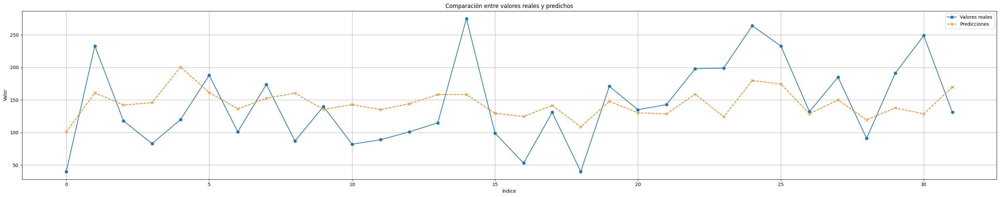

Evaluation metrics for rf_exp3 performance in eval
MSE: 3160.1719169979733
RMSE: 56.21540640249765
R2: 0.20230392932242647
MAE: 47.861144869346006
MAPE: 0.4347134452548298
Best parameters: {'max_depth': None, 'max_features': 'sqrt', 'min_samples_leaf': 2, 'min_samples_split': 5, 'n_estimators': 25}


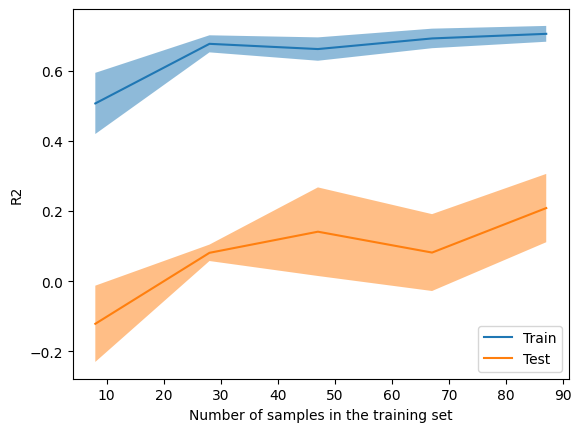

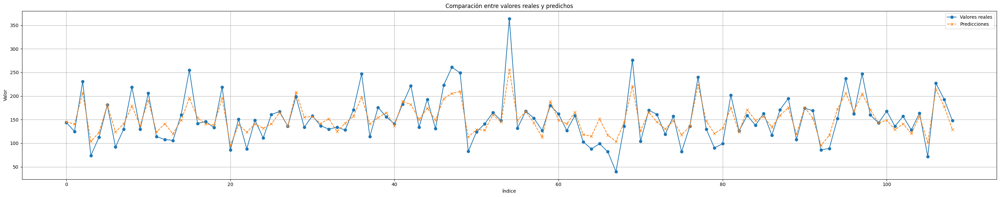

Evaluation metrics for rf_exp3 performance in training
MSE: 606.2461553624952
RMSE: 24.622066431607546
R2: 0.7631460811249523
MAE: 18.500182029998545
MAPE: 0.14058037059492196


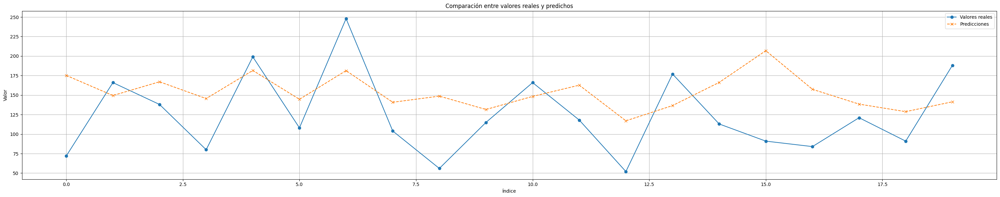

Evaluation metrics for rf_exp3 performance in eval
MSE: 3305.4585920817835
RMSE: 57.49311778014638
R2: -0.30247567735860037
MAE: 49.66652698412698
MAPE: 0.5400862740324366


In [ ]:
parameters = {
    'n_estimators': [25, 50, 100, 200],
    'max_depth': [None, 10, 15, 20],
    'min_samples_split': [2, 5, 10],
    'min_samples_leaf': [1, 2, 4],
    'max_features': ['sqrt', 'log2']
}

i=0
for x_train, y_train, x_eval, y_eval in zip(x_train_exp3, y_train_exp3, x_eval_exp3, y_eval_exp3):
  i+=1
  rf_exp3 = RandomForestRegressor(n_estimators=100, random_state=42)

  grid = GridSearchCV(rf_exp3, parameters, n_jobs=2, cv=cv)
  grid.fit(x_train, y_train)

  best_rf_exp3 = grid.best_estimator_
  print('Best parameters:', grid.best_params_)

  LearningCurveDisplay.from_estimator(best_rf_exp3, x_train, y_train, cv=cv, scoring='r2')
  best_rf_exp3.fit(x_train, y_train)

  # Predict on train test
  train_predictions = best_rf_exp3.predict(x_train)
  # Predict on the test set
  predictions = best_rf_exp3.predict(x_eval)

  # evaluate
  train_scores = evaluate_regression(y_train, train_predictions, 'rf_exp3 performance in training')
  eval_scores = evaluate_regression(y_eval, predictions, 'rf_exp3 performance in eval')

  all_scores_exp3['rf_exp3_'+str(i)] = [train_scores, eval_scores]

#### Resultados

Comparison of Model Performance Across Experiments


,Eval Score_AutoTabPFN_exp3_,Eval Score_TabNet_exp3_,Eval Score_XGB_exp3_,Eval Score_rf_exp3_,Eval Score_svm_exp3_,Train Score_AutoTabPFN_exp3_,Train Score_TabNet_exp3_,Train Score_XGB_exp3_,Train Score_rf_exp3_,Train Score_svm_exp3_
Patient ID,,,,,,,,,,
559,51.349767,67.007164,52.720320,53.374002,54.017483,69.259881,68.348076,70.553144,50.799248,69.431859
563,66.585911,60.874282,59.115167,57.493118,58.956532,34.381372,58.945192,40.805729,24.622066,39.492432
570,47.145900,60.655369,54.713893,52.034557,55.919226,46.023280,42.327156,44.182954,22.638465,56.230057
575,59.817659,46.936202,60.129552,59.637524,64.307623,47.327545,51.159729,43.174817,30.768583,50.164902
588,48.386150,49.791170,57.203221,52.685544,54.918708,40.320489,43.912680,43.452340,21.123520,43.631826
591,53.380059,65.993437,52.560563,56.215406,60.975141,48.273750,59.467720,43.536921,28.970075,46.840743


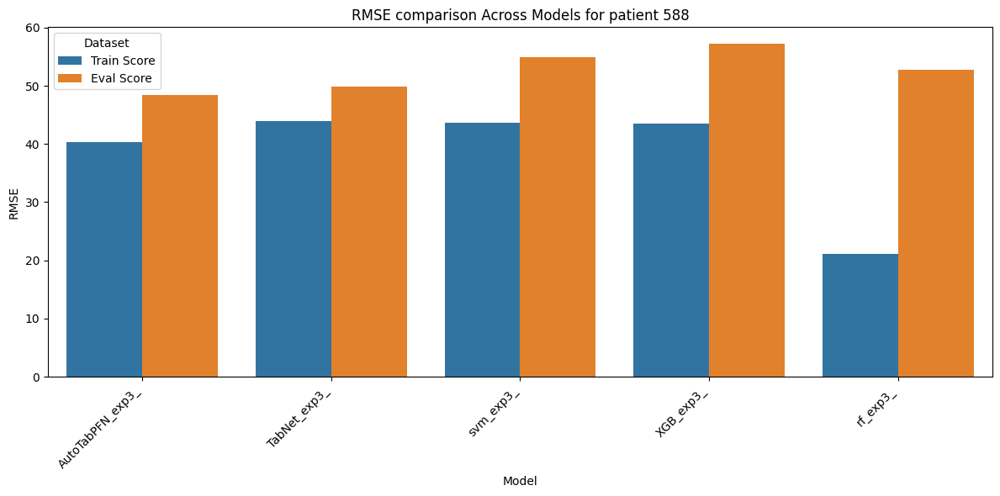

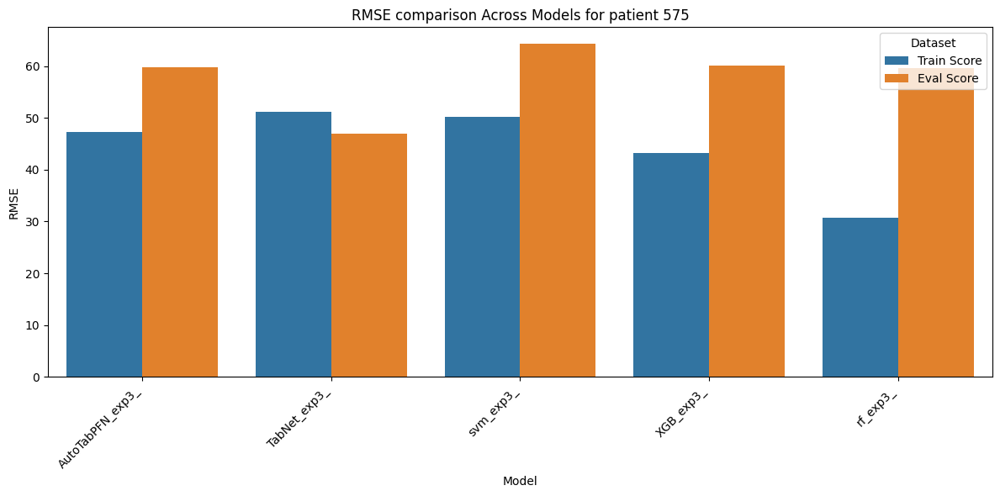

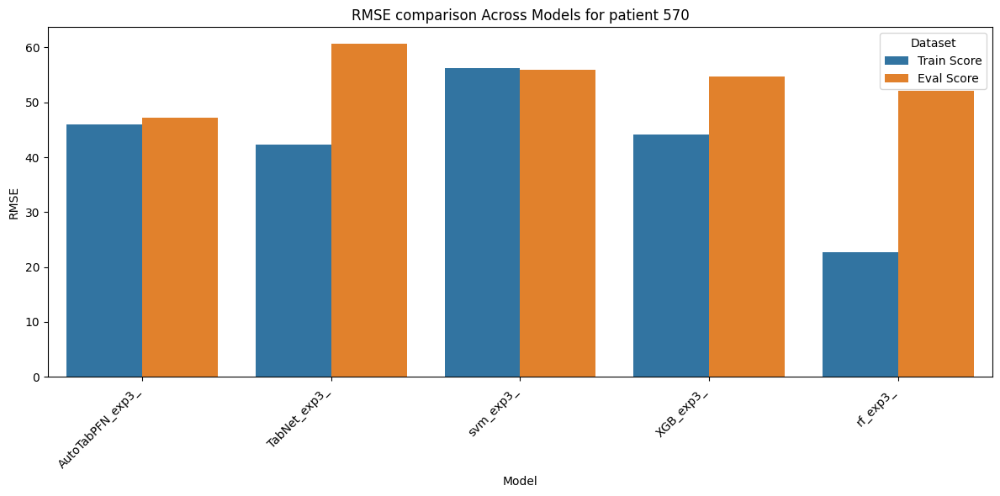

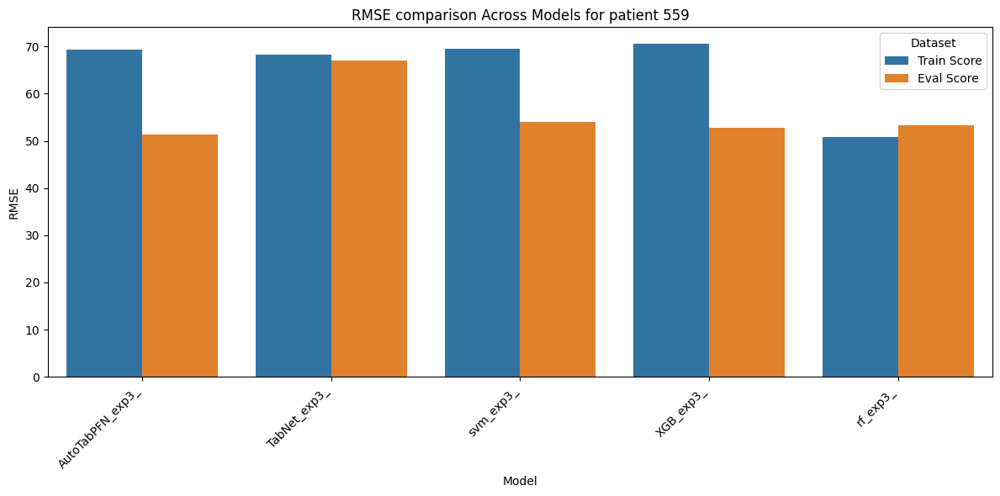

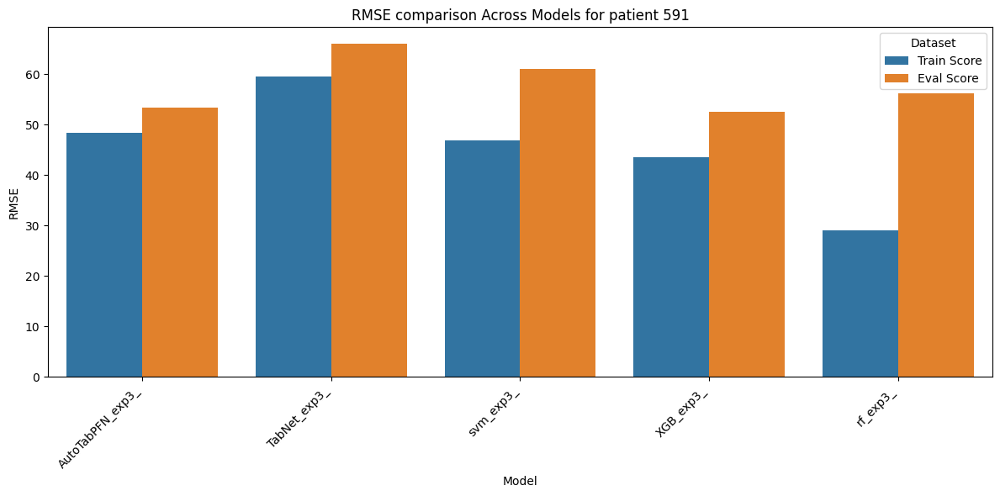

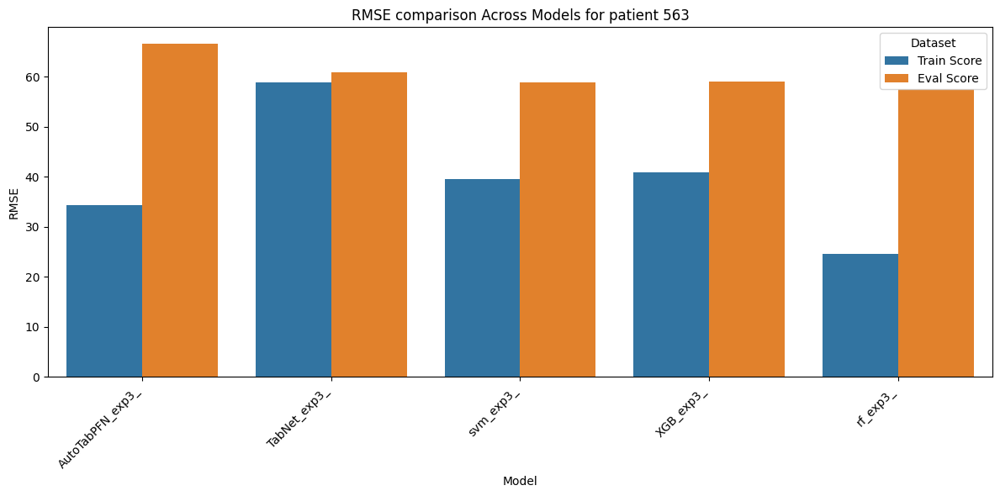

In [ ]:
patient_ids = list(separated_ids_features_prepared.keys())
models = ['tabpfn_exp3_', 'TabNet_exp3_', 'svm_exp3_', 'XGB_exp3_', 'rf_exp3_']

data_for_plot = []
for i, patient_id in enumerate(patient_ids):
  # scores for each patient
  for model in models:
    data_for_plot.append({
        'Model': model,
        'Patient ID': patient_id,
        'Train Score': all_scores_exp3[model+str(i+1)][0][1],
        'Eval Score': all_scores_exp3[model+str(i+1)][1][1]
    })

scores_df = pd.DataFrame(data_for_plot)

# Pivot the DataFrame to have metrics as rows and models as columns
pivot_df = scores_df.pivot_table(index='Patient ID', columns='Model', values=['Train Score', 'Eval Score'])

# Flatten the columns
pivot_df.columns = [f'{col[0]}_{col[1]}' for col in pivot_df.columns]

# Display the table
print("Comparison of Model Performance Across Experiments")
display(pivot_df)

# Optional: Use seaborn to visualize the scores
# Melt the DataFrame back to long format for plotting
scores_melted = scores_df.melt(id_vars=['Model', 'Patient ID'], var_name='Dataset', value_name='Score')

# Create bar plots for each metric
for id in patient_ids:
    plt.figure(figsize=(12, 6))
    sns.barplot(data=scores_melted[scores_melted['Patient ID'] == id], x='Model', y='Score', hue='Dataset')
    plt.title(f'RMSE comparison Across Models for patient {id}')
    plt.ylabel('RMSE')
    plt.xticks(rotation=45, ha='right')
    plt.tight_layout()
    plt.show()

## Conclusiones de los experimentos respecto a los objetivos iniciales

Los modelos de este experimento vuelven a tener problemas para realizar predicciones. Sin embargo, se observa una gran diferencia entre algunos pacientes. Mientras que en unos todos los modelos tienden a obtener mejores resultados, en otros es al contrario. Siendo que hay muchos datos anotados a mano por los pacientes sin el uso de herramientas objetivas (el nº de carbohidratos ingeridos, el esfuerzo de la actividad física, etc), es normal pensar que existe un componente de error en estas características que depende de la precisión de los pacientes a la hora de anotar. Además, según otros investigadores, las máquinas de monitorización de glucosa a menudo presentan retrasos temporales en sus registros.

Con esta información sobre la mano, parece que el objetivo de dar una dosis precisa de insulina se nos queda demasiado grande.

Antes de rendirnos, vamos a realizar una última pareja de experimentos donde simplificaremos el problema. En lugar de hacer que los modelos aprendan a predecir el valor exacto de insulina que tendrá un paciente, discretizaremos estos valores para pasar a un problema de clasificación en el que los modelos predecirán una clase. Cada clase estará asociada a un rango de glucosa. La respuesta final del sistema de recomendación consistiría en el rango de insulina con el cual el modelo clasifica a la ingesta dentro de la clase que represente al rango de glucosa recomendado.

In [ ]:
def discretize_glucose(labels, num_bins=5):
  """
  Discretiza los niveles de glucosa en un número determinado de bins con
  un número de ejemplos aproximadamente balanceado en cada bin.

  Args:
    labels (pd.Series): Serie de pandas con los niveles de glucosa (etiquetas).
    num_bins (int): Número de bins (niveles de glucosa discretizados) a crear.

  Returns:
    pd.Series: Serie de pandas con las etiquetas discretizadas.
    list: Lista de los umbrales utilizados para la discretización.
  """
  # Usa qcut para crear cuantiles, que resultará en bins con tamaños ~iguales
  # 'duplicates='drop'' maneja casos donde hay muchos valores idénticos
  discretized_labels, bins = pd.qcut(
      labels,
      q=num_bins,
      labels=False, # Usar etiquetas numéricas (0 a num_bins-1)
      retbins=True, # Devolver los umbrales
      duplicates='drop' # Descartar umbrales duplicados si los hay
  )

  # Asegurarse de que las etiquetas discretizadas tengan el mismo índice que las originales
  discretized_labels.index = labels.index

  # Si duplicates='drop' redujo el número de bins, ajustar num_bins si es necesario
  if len(bins) - 1 < num_bins:
      print(f"Advertencia: El número de bins se redujo a {len(bins) - 1} debido a valores duplicados en los datos.")

  return discretized_labels, bins

# Ejemplo de uso: Discretizar df_label_raw en 5 niveles
df_label_discretized, glucose_bins = discretize_glucose(df_label_raw, num_bins=5)

print("Etiquetas discretizadas:")
print(df_label_discretized.value_counts().sort_index())
print("\nUmbrales de discretización:")
glucose_bins


Etiquetas discretizadas:
label
0    219
1    218
2    220
3    217
4    217
Name: count, dtype: int64

Umbrales de discretización:


array([ 40., 100., 136., 168., 212., 400.])

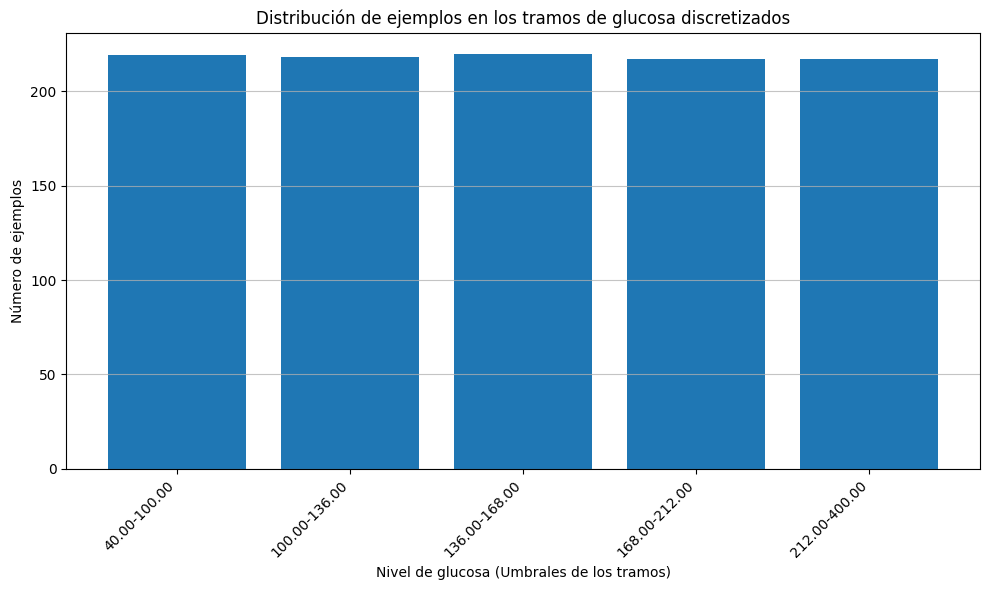

In [ ]:
# Dibujar el histograma
plt.figure(figsize=(10, 6))
plt.hist(df_label_discretized, bins=np.arange(len(glucose_bins)), align='left', rwidth=0.8)

# Configurar el eje x con los umbrales
plt.xticks(np.arange(len(glucose_bins)-1), [f'{glucose_bins[i]:.2f}-{glucose_bins[i+1]:.2f}' for i in range(len(glucose_bins)-1)], rotation=45, ha='right')

# Añadir etiquetas y título
plt.xlabel('Nivel de glucosa (Umbrales de los tramos)')
plt.ylabel('Número de ejemplos')
plt.title('Distribución de ejemplos en los tramos de glucosa discretizados')
plt.grid(axis='y', alpha=0.75)
plt.tight_layout()
plt.show()

### Experimentar con conjunto discreto

In [ ]:
# volver a generar los conjuntos de entrenamiento con todas las variables
unwanted_features = ['illness', 'id']

# pasar la pipeline
all_ids_features_prepared = full_pipeline.fit_transform(df_raw)

# separación de datos
x_train_discrete, x_eval_discrete, y_train_discrete, y_eval_discrete = split_classification(all_ids_features_prepared, df_label_discretized)
y_train_discrete = y_train_discrete.values.ravel()
y_eval_discrete = y_eval_discrete.values.ravel()

all_scores_discrete = {}

# 4. nombres de las variables usadas
feature_names_discrete = full_pipeline[1:].get_feature_names_out()

# 5. mezclador de ejemplos para CV
cv = StratifiedKFold(n_splits=5, shuffle=True, random_state=42)

#### TabPFN

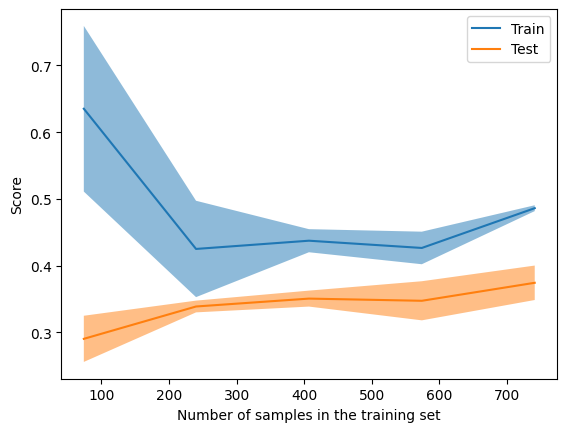

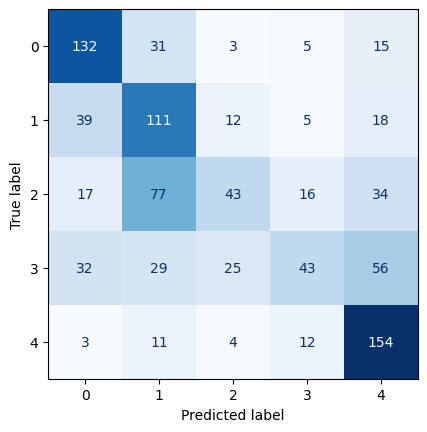

Evaluation metrics for AutoTabPFN performance in training
Accuracy: 0.5210355987055016


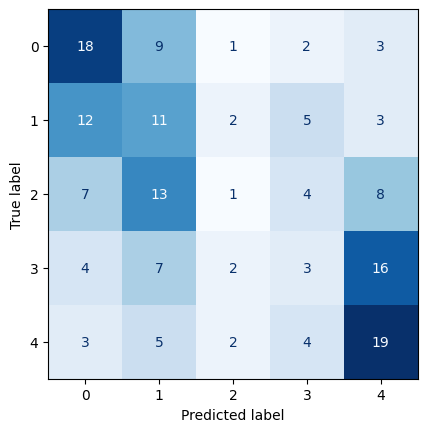

Evaluation metrics for AutoTabPFN performance in eval
Accuracy: 0.3170731707317073


In [ ]:
tabpfn_discrete = TabPFNClassifier() # TABPFN INSTEAD OF AUTOTAB SO THAT WE CAN PLOT LEARNING CURVES

LearningCurveDisplay.from_estimator(tabpfn_discrete, x_train_discrete, y_train_discrete, cv=cv)
tabpfn_discrete.fit(x_train_discrete, y_train_discrete)

# Predict on train test
train_predictions = tabpfn_discrete.predict(x_train_discrete)
# Predict on the test set
predictions = tabpfn_discrete.predict(x_eval_discrete)

# evaluate
train_scores = evaluate_classification(y_train_discrete, train_predictions, 'tabpfn performance in training')
eval_scores = evaluate_classification(y_eval_discrete, predictions, 'tabpfn performance in eval')

all_scores_discrete['tabpfn_discrete'] = [train_scores, eval_scores]

#### TabNet


Early stopping occurred at epoch 35 with best_epoch = 15 and best_val_0_accuracy = 0.34146
Best parameters: {'momentum': 0.01, 'n_a': 8, 'n_d': 8}

Early stopping occurred at epoch 24 with best_epoch = 4 and best_val_1_accuracy = 0.34146


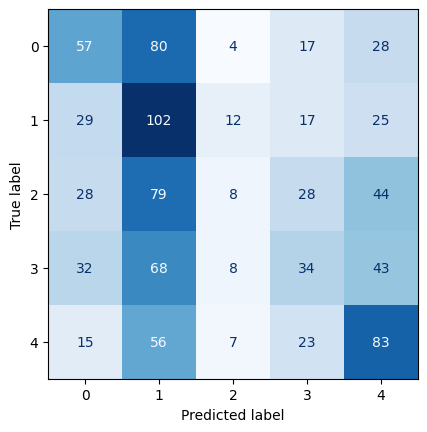

Evaluation metrics for TabNet performance in training
Accuracy: 0.3063646170442287


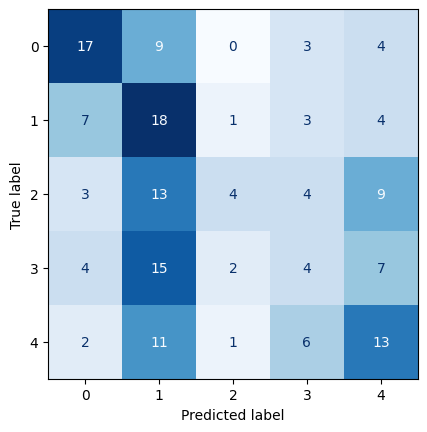

Evaluation metrics for AutoTabPFN performance in eval
Accuracy: 0.34146341463414637


In [ ]:
parameters = {'n_d': (8, 16, 32), 'n_a': (8, 16, 32), 'momentum': (0.01, 0.02, 0.15)}

tabNet_discrete = TabNetClassifier(verbose=0)

grid = GridSearchCV(tabNet_discrete, parameters, n_jobs=2, cv=cv, scoring='neg_log_loss')
grid.fit(
  x_train_discrete, y_train_discrete,
  eval_set=[(x_eval_discrete, y_eval_discrete)],
  batch_size=64,
  virtual_batch_size=32,
  patience=20
)

best_tabNet_discrete = grid.best_estimator_
print('Best parameters:', grid.best_params_)
best_tabNet_discrete.fit(
  x_train_discrete, y_train_discrete,
  eval_set=[(x_train_discrete, y_train_discrete), (x_eval_discrete, y_eval_discrete)],
  batch_size=64,
  virtual_batch_size=32,
  patience=20
)

# Predict on train test
train_predictions = best_tabNet_discrete.predict(x_train_discrete)
# Predict on the test set
predictions = best_tabNet_discrete.predict(x_eval_discrete)

# evaluate
train_scores = evaluate_classification(y_train_discrete, train_predictions, 'TabNet performance in training')
eval_scores = evaluate_classification(y_eval_discrete, predictions, 'TabNet performance in eval')

all_scores_discrete['TabNet_discrete'] = [train_scores, eval_scores]

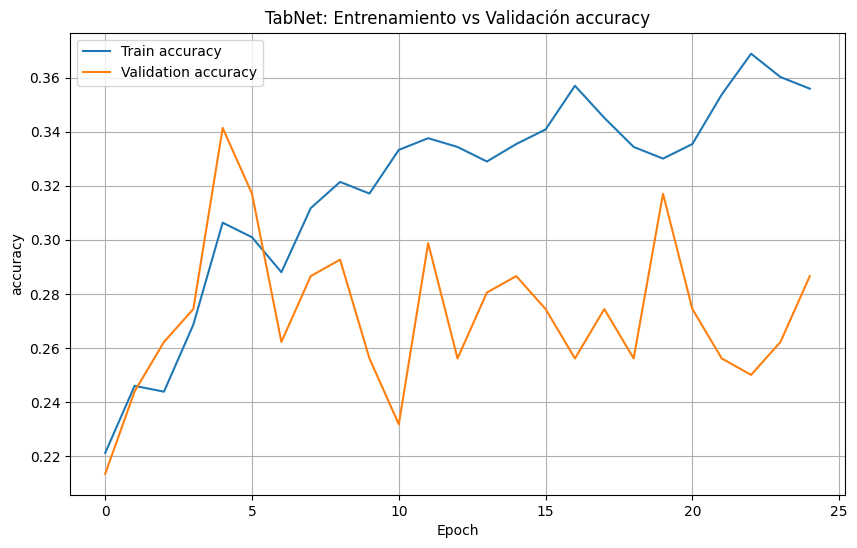

In [ ]:
# 4. Obtener los logs de entrenamiento
train_rmse = best_tabNet_discrete.history['val_0_accuracy']
val_rmse = best_tabNet_discrete.history['val_1_accuracy']

# 5. Graficar
plt.figure(figsize=(10, 6))
plt.plot(train_rmse, label='Train accuracy')
plt.plot(val_rmse, label='Validation accuracy')
plt.xlabel("Epoch")
plt.ylabel("accuracy")
plt.title("TabNet: Entrenamiento vs Validación accuracy")
plt.legend()
plt.grid(True)
plt.show()

#### SVM

Best parameters: {'C': 1, 'gamma': 'scale', 'kernel': 'rbf'}


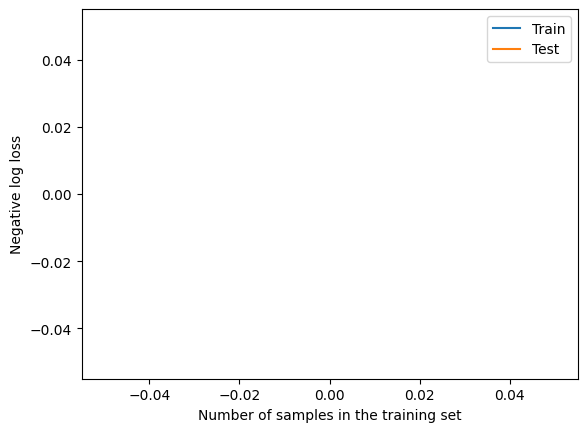

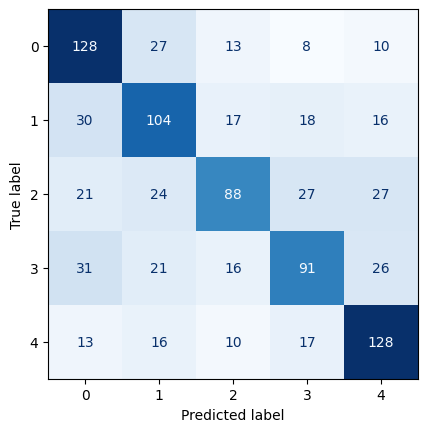

Evaluation metrics for SVM performance in training
Accuracy: 0.5814455231930961


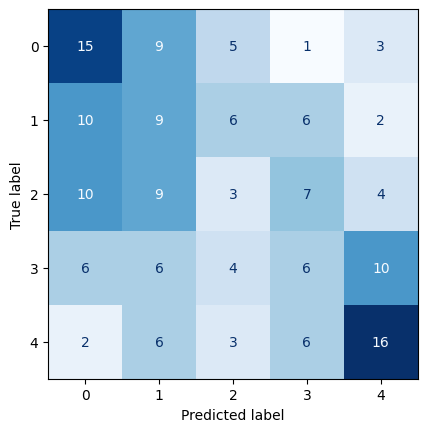

Evaluation metrics for SVM performance in eval
Accuracy: 0.29878048780487804


In [ ]:
parameters = {'kernel':('rbf', 'poly'), 'C':(1, 2, 4, 8, 16), 'gamma':('scale', 'auto')}

svm_discrete = svm.SVC()
grid = GridSearchCV(svm_discrete, parameters, n_jobs=2, cv=cv)
grid.fit(x_train_discrete, y_train_discrete)

best_svm_discrete = grid.best_estimator_
print('Best parameters:', grid.best_params_)
LearningCurveDisplay.from_estimator(best_svm_discrete, x_train_discrete, y_train_discrete, cv=cv, scoring='neg_log_loss')
best_svm_discrete.fit(x_train_discrete, y_train_discrete)

# Predict on train test
train_predictions = best_svm_discrete.predict(x_train_discrete)
# Predict on the test set
predictions = best_svm_discrete.predict(x_eval_discrete)

# evaluate
train_scores = evaluate_classification(y_train_discrete, train_predictions, 'SVM performance in training')
eval_scores = evaluate_classification(y_eval_discrete, predictions, 'SVM performance in eval')

all_scores_discrete['SVM_discrete'] = [train_scores, eval_scores]

#### XGBoost

[0]	validation_0-mlogloss:1.60210
[1]	validation_0-mlogloss:1.59583
[2]	validation_0-mlogloss:1.58960
[3]	validation_0-mlogloss:1.58464
[4]	validation_0-mlogloss:1.57970
[5]	validation_0-mlogloss:1.57572
[6]	validation_0-mlogloss:1.57140
[7]	validation_0-mlogloss:1.56755
[8]	validation_0-mlogloss:1.56389
[9]	validation_0-mlogloss:1.56136
[10]	validation_0-mlogloss:1.55888
[11]	validation_0-mlogloss:1.55587
[12]	validation_0-mlogloss:1.55373
[13]	validation_0-mlogloss:1.55135
[14]	validation_0-mlogloss:1.54893
[15]	validation_0-mlogloss:1.54703
[16]	validation_0-mlogloss:1.54526
[17]	validation_0-mlogloss:1.54380
[18]	validation_0-mlogloss:1.54202
[19]	validation_0-mlogloss:1.54058
[20]	validation_0-mlogloss:1.53784
[21]	validation_0-mlogloss:1.53628
[22]	validation_0-mlogloss:1.53422
[23]	validation_0-mlogloss:1.53348
[24]	validation_0-mlogloss:1.53121
[25]	validation_0-mlogloss:1.52892
[26]	validation_0-mlogloss:1.52769
[27]	validation_0-mlogloss:1.52653
[28]	validation_0-mlogloss:1.5

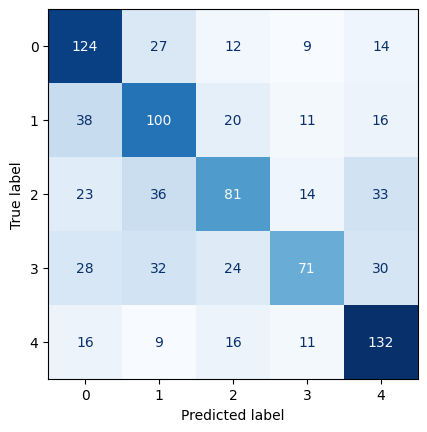

Evaluation metrics for XGB performance in training
Accuracy: 0.5480043149946062


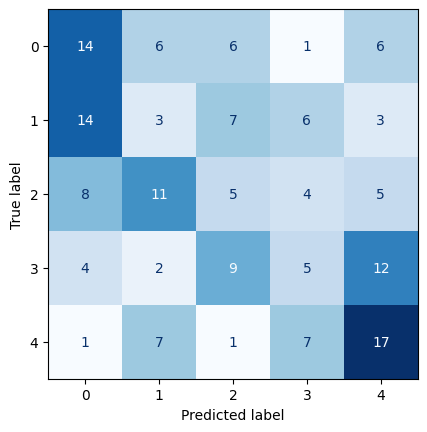

Evaluation metrics for XGB performance in eval
Accuracy: 0.2682926829268293


In [ ]:
parameters = { 'max_depth':(2, 3, 6, 12), 'learning_rate':(0.05, 0.1, 0.3, 0.9), 'n_estimators':(25, 50, 75, 150, 300)  }

XGB_discrete = xgb.XGBClassifier(tree_method="hist", early_stopping_rounds=10, verbosity=0) #hist porque es más rápido
grid = GridSearchCV(XGB_discrete, parameters, n_jobs=2, cv=cv)
grid.fit(x_train_discrete, y_train_discrete, eval_set=[(x_eval_discrete, y_eval_discrete)])

best_XGB_discrete = grid.best_estimator_
print('Best parameters:', grid.best_params_)
best_XGB_discrete.fit(x_train_discrete, y_train_discrete, eval_set=[(x_train_discrete, y_train_discrete), (x_eval_discrete, y_eval_discrete)]) # dos conjuntos de eval, entrenamiento y eval para graficar el entrenamiento

# Predict on train test
train_predictions = best_XGB_discrete.predict(x_train_discrete)
# Predict on the test set
predictions = best_XGB_discrete.predict(x_eval_discrete)

# evaluate
train_scores = evaluate_classification(y_train_discrete, train_predictions, 'XGB performance in training')
eval_scores = evaluate_classification(y_eval_discrete, predictions, 'XGB performance in eval')

all_scores_discrete['XGB_discrete'] = [train_scores, eval_scores]

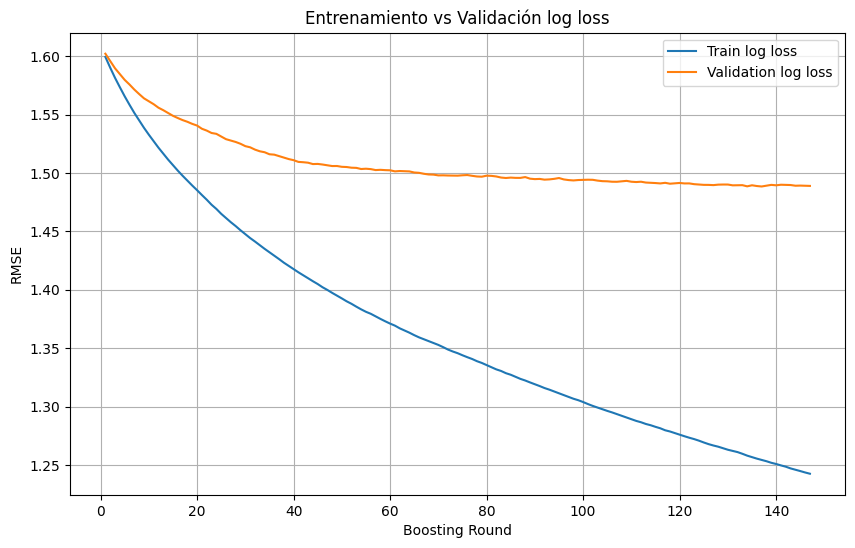

In [ ]:
# 4. Obtener resultados
results = best_XGB_discrete.evals_result()

# 5. Graficar
epochs = range(1, len(results['validation_0']['mlogloss']) + 1)
train_rmse = results['validation_0']['mlogloss']
val_rmse = results['validation_1']['mlogloss']

plt.figure(figsize=(10, 6))
plt.plot(epochs, train_rmse, label='Train log loss')
plt.plot(epochs, val_rmse, label='Validation log loss')
plt.xlabel("Boosting Round")
plt.ylabel("RMSE")
plt.title("Entrenamiento vs Validación log loss")
plt.legend()
plt.grid(True)
plt.show()

#### RandomForest

Best parameters: {'max_depth': 15, 'max_features': 'sqrt', 'min_samples_leaf': 1, 'min_samples_split': 2, 'n_estimators': 200}


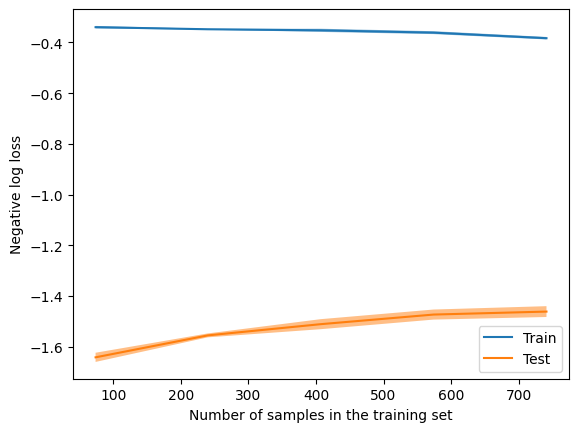

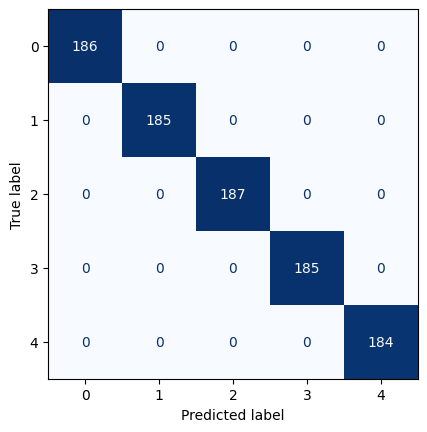

Evaluation metrics for RF performance in training
Accuracy: 1.0


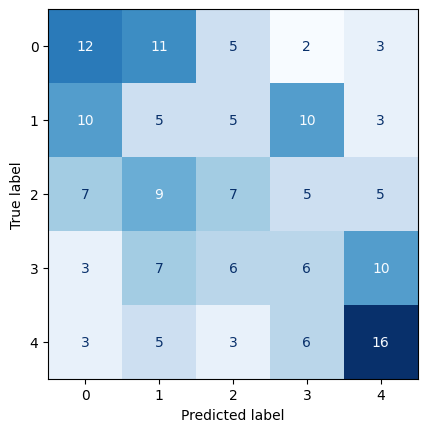

Evaluation metrics for RF performance in eval
Accuracy: 0.2804878048780488


In [ ]:
parameters = {
    'n_estimators': [25, 50, 100, 200],
    'max_depth': [None, 10, 15, 20],
    'min_samples_split': [2, 5, 10],
    'min_samples_leaf': [1, 2, 4],
    'max_features': ['sqrt', 'log2']
}

rf_discrete = RandomForestClassifier(n_estimators=100, random_state=42)
grid = GridSearchCV(rf_discrete, parameters, n_jobs=2, cv=cv)
grid.fit(x_train_discrete, y_train_discrete)

best_rf_discrete = grid.best_estimator_
print('Best parameters:', grid.best_params_)
LearningCurveDisplay.from_estimator(best_rf_discrete, x_train_discrete, y_train_discrete, cv=cv, scoring='neg_log_loss')
best_rf_discrete.fit(x_train_discrete, y_train_discrete)

# Predict on train test
train_predictions = best_rf_discrete.predict(x_train_discrete)
# Predict on the test set
predictions = best_rf_discrete.predict(x_eval_discrete)

# evaluate
train_scores = evaluate_classification(y_train_discrete, train_predictions, 'RF performance in training')
eval_scores = evaluate_classification(y_eval_discrete, predictions, 'RF performance in eval')

all_scores_discrete['RF_discrete'] = [train_scores, eval_scores]

#### Resultados

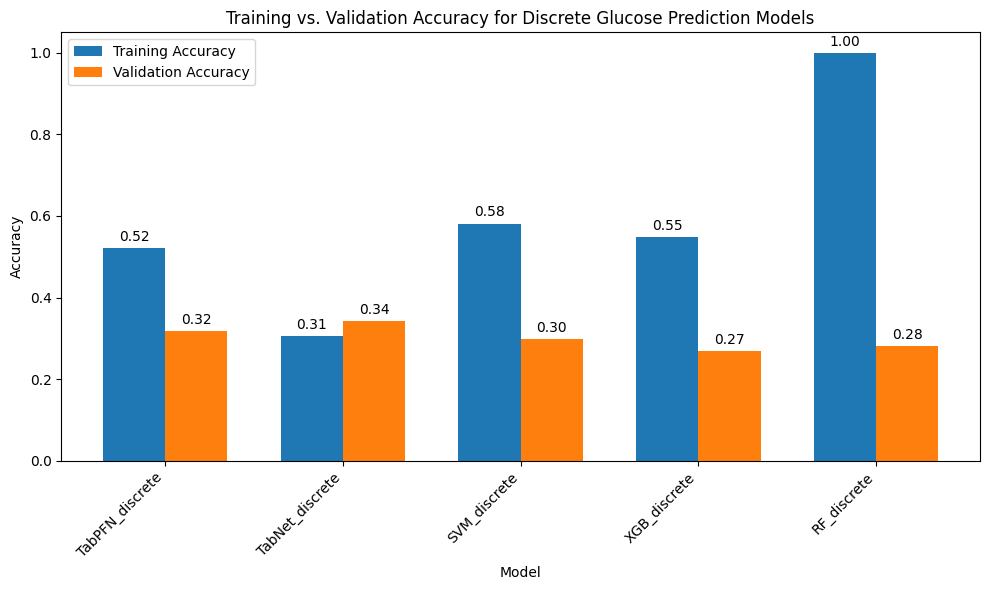

In [ ]:
# Extract model names and accuracy scores
model_names = list(all_scores_discrete.keys())

train_accuracies = [all_scores_discrete[model][0] for model in model_names]
eval_accuracies = [all_scores_discrete[model][1] for model in model_names]

# Set up the bar plot
bar_width = 0.35
index = np.arange(len(model_names))

fig, ax = plt.subplots(figsize=(10, 6))

bar1 = ax.bar(index - bar_width/2, train_accuracies, bar_width, label='Training Accuracy')
bar2 = ax.bar(index + bar_width/2, eval_accuracies, bar_width, label='Validation Accuracy')

# Add labels, title, and ticks
ax.set_xlabel('Model')
ax.set_ylabel('Accuracy')
ax.set_title('Training vs. Validation Accuracy for Discrete Glucose Prediction Models')
ax.set_xticks(index)
ax.set_xticklabels(model_names)
ax.legend()

# Add accuracy values on top of the bars
def autolabel(bars):
    for bar in bars:
        height = bar.get_height()
        ax.annotate(f'{height:.2f}',
                    xy=(bar.get_x() + bar.get_width() / 2, height),
                    xytext=(0, 3),  # 3 points vertical offset
                    textcoords="offset points",
                    ha='center', va='bottom')

autolabel(bar1)
autolabel(bar2)

plt.xticks(rotation=45, ha='right')
plt.tight_layout()
plt.show()


### Conjunto discreto y entrenamientos individuales

In [ ]:
# volver a generar los conjuntos de entrenamiento con todas las variables
unwanted_features = ['illness', 'id']

# pasar la pipeline
all_ids_features_prepared = full_pipeline.fit_transform(df_raw)

# separación de datos
x_train_discrete2, x_eval_discrete2, y_train_discrete2, y_eval_discrete2 = ([], [], [], [])
for id in separated_ids_features_prepared.keys():
  discretized_labels, _ = discretize_glucose(pd.DataFrame(separated_ids_labels_raw[id])[0], num_bins=3)
  x_train, x_eval, y_train, y_eval = split_classification(separated_ids_features_prepared[id], discretized_labels)
  x_train_discrete2.append(x_train)
  x_eval_discrete2.append(x_eval)
  y_train_discrete2.append(y_train)
  y_eval_discrete2.append(y_eval)




# 4. nombres de las variables usadas
feature_names_discrete2 = full_pipeline[1:].get_feature_names_out()

# 5. mezclador de ejemplos para CV
cv = KFold(n_splits=5, shuffle=True, random_state=42)

#### TabPFN

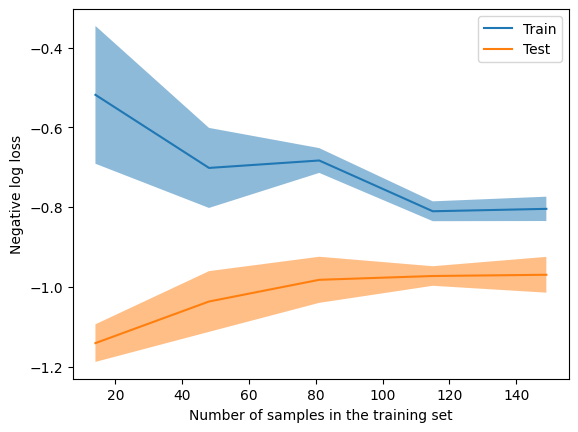

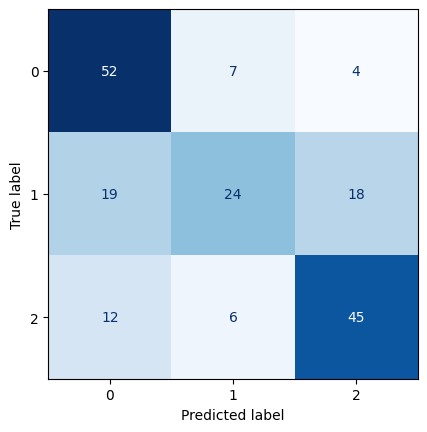

Evaluation metrics for AutoTabPFN performance in training
Accuracy: 0.6470588235294118


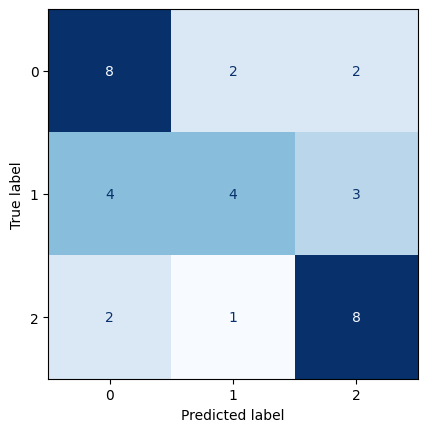

Evaluation metrics for AutoTabPFN performance in eval
Accuracy: 0.5882352941176471


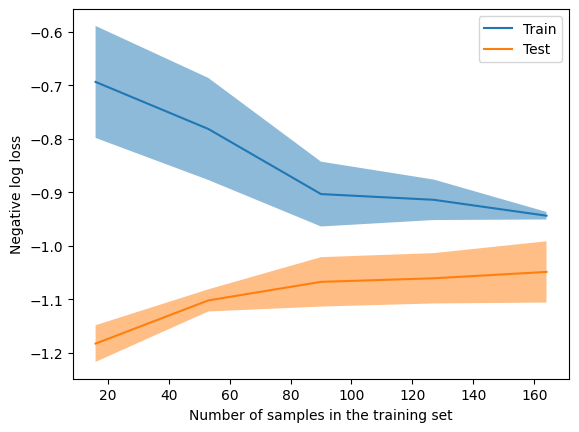

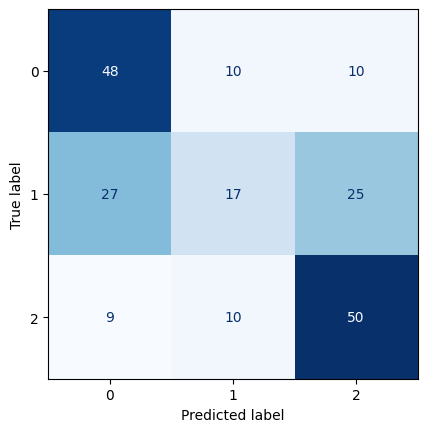

Evaluation metrics for AutoTabPFN performance in training
Accuracy: 0.558252427184466


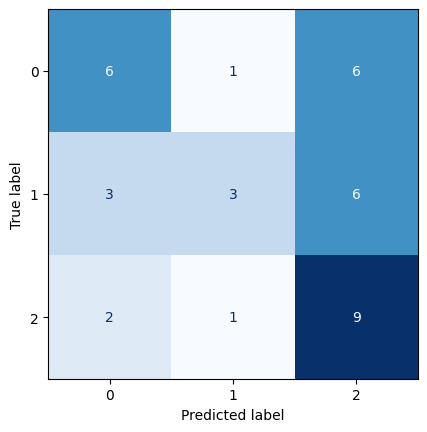

Evaluation metrics for AutoTabPFN performance in eval
Accuracy: 0.4864864864864865


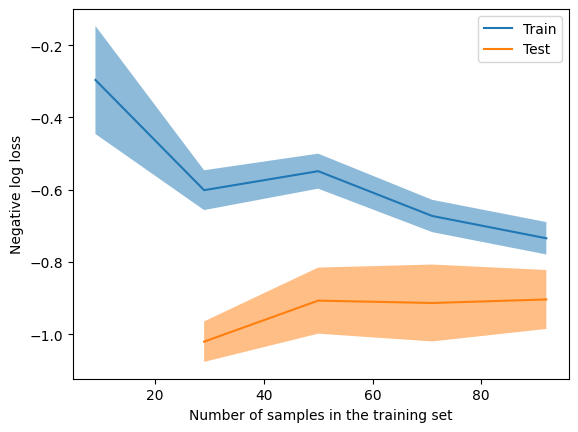

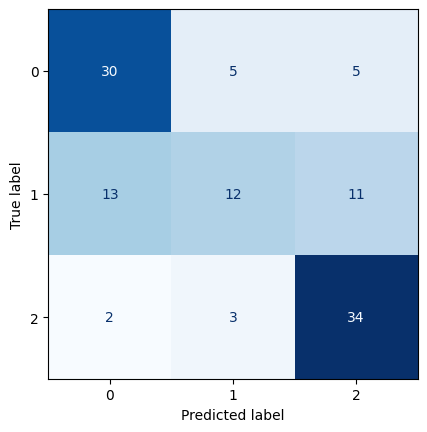

Evaluation metrics for AutoTabPFN performance in training
Accuracy: 0.6608695652173913


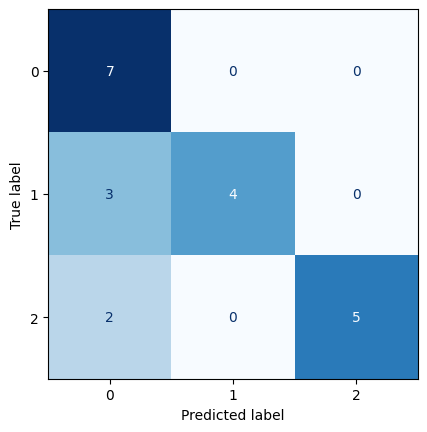

Evaluation metrics for AutoTabPFN performance in eval
Accuracy: 0.7619047619047619


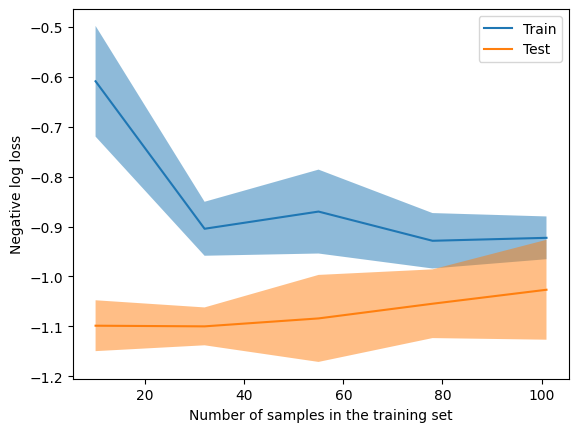

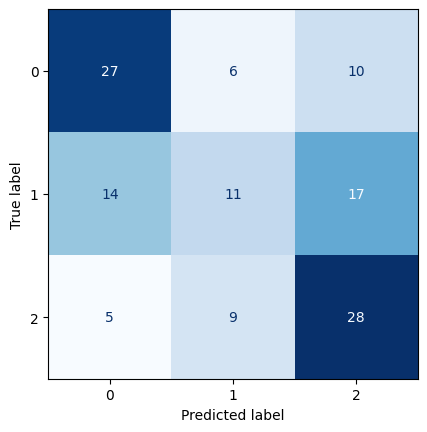

Evaluation metrics for AutoTabPFN performance in training
Accuracy: 0.5196850393700787


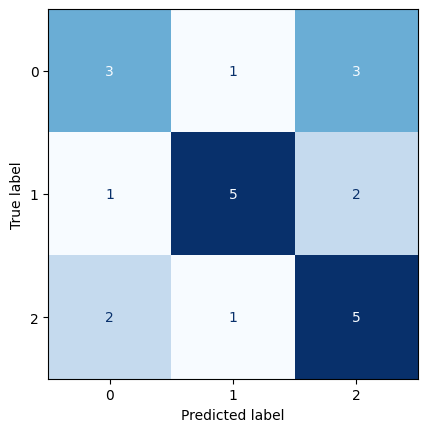

Evaluation metrics for AutoTabPFN performance in eval
Accuracy: 0.5652173913043478


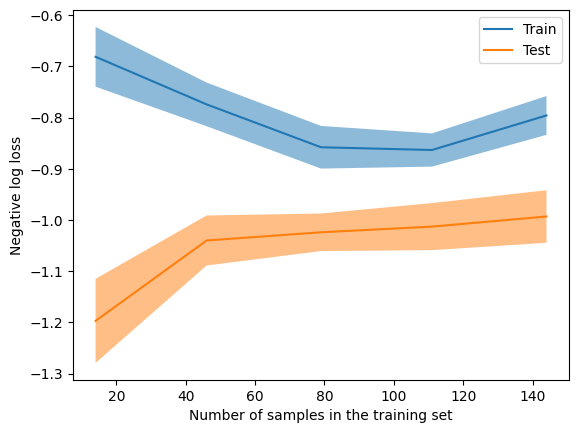

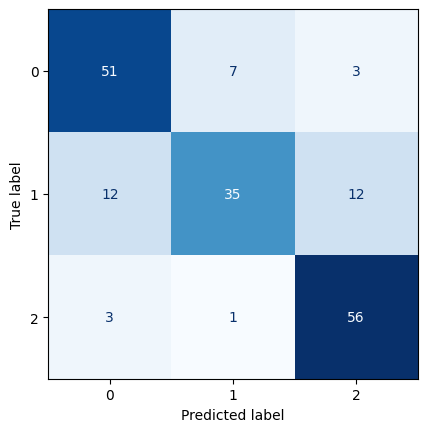

Evaluation metrics for AutoTabPFN performance in training
Accuracy: 0.7888888888888889


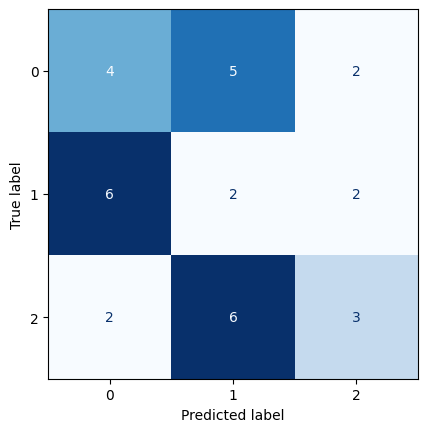

Evaluation metrics for AutoTabPFN performance in eval
Accuracy: 0.28125


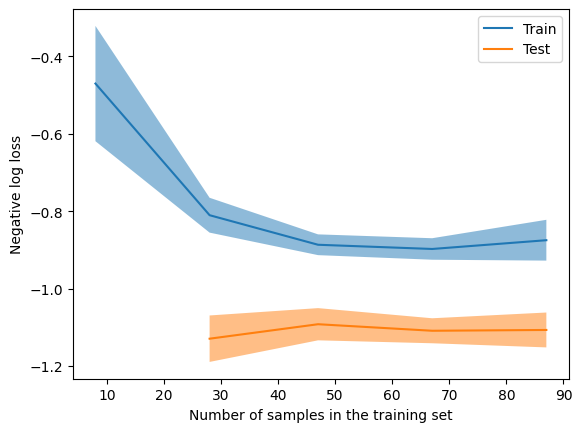

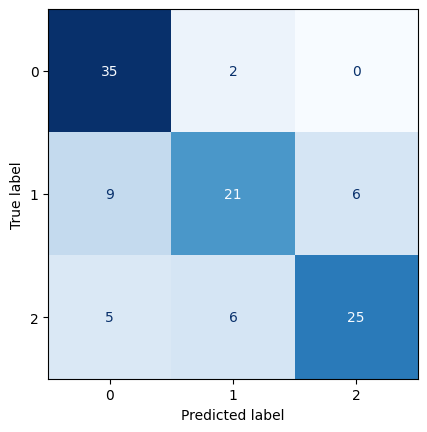

Evaluation metrics for AutoTabPFN performance in training
Accuracy: 0.7431192660550459


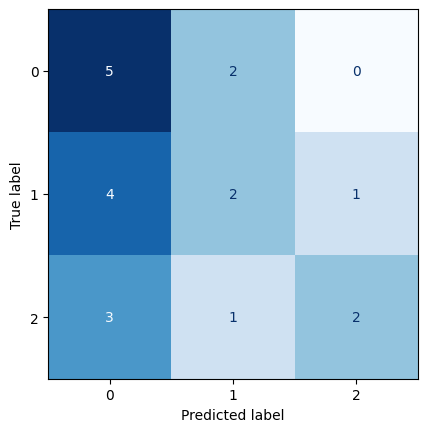

Evaluation metrics for AutoTabPFN performance in eval
Accuracy: 0.45


In [ ]:
tabpfn_discrete2 = TabPFNClassifier()
i=0
for x_train, y_train, x_eval, y_eval in zip(x_train_discrete2, y_train_discrete2, x_eval_discrete2, y_eval_discrete2):
  i+=1
  LearningCurveDisplay.from_estimator(tabpfn_discrete2, x_train, y_train, cv=cv, scoring='neg_log_loss')
  tabpfn_discrete2.fit(x_train, y_train)

  # Predict on train test
  train_predictions = tabpfn_discrete2.predict(x_train)
  # Predict on the test set
  predictions = tabpfn_discrete2.predict(x_eval)

  # evaluate
  train_scores = evaluate_classification(y_train, train_predictions, 'tabpfn performance in training')
  eval_scores = evaluate_classification(y_eval, predictions, 'tabpfn performance in eval')

  all_scores_discrete['TabPFN_discrete2_'+str(i)] = [train_scores, eval_scores]

#### TabNet


Early stopping occurred at epoch 32 with best_epoch = 12 and best_val_0_accuracy = 0.52941
Best parameters: {'momentum': 0.02, 'n_a': 8, 'n_d': 32}

Early stopping occurred at epoch 66 with best_epoch = 46 and best_val_1_accuracy = 0.58824


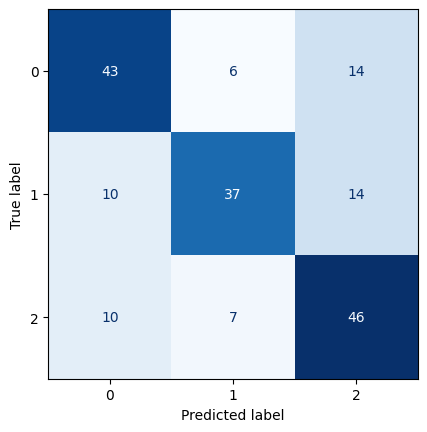

Evaluation metrics for TabNet performance in training
Accuracy: 0.6737967914438503


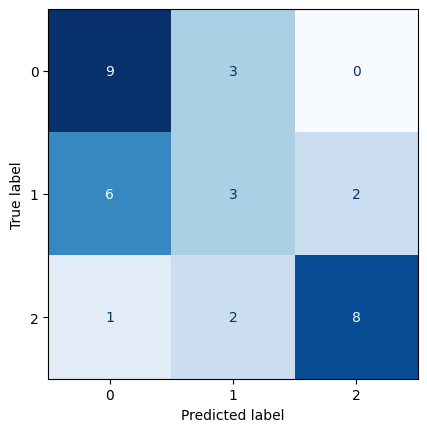

Evaluation metrics for TabNet performance in eval
Accuracy: 0.5882352941176471


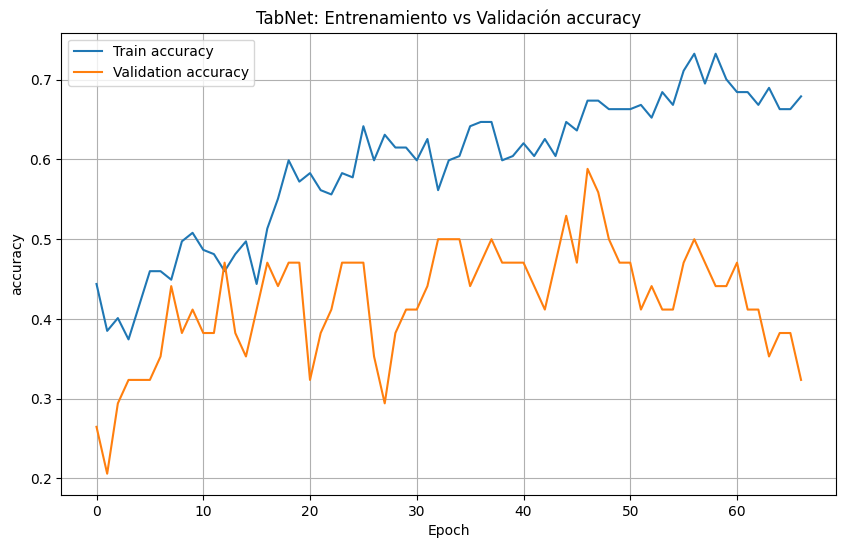


Early stopping occurred at epoch 22 with best_epoch = 2 and best_val_0_accuracy = 0.45946
Best parameters: {'momentum': 0.01, 'n_a': 8, 'n_d': 32}

Early stopping occurred at epoch 41 with best_epoch = 21 and best_val_1_accuracy = 0.48649


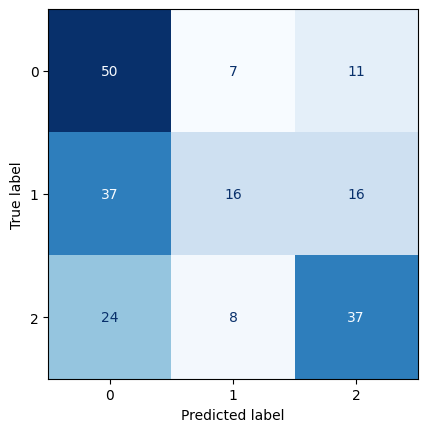

Evaluation metrics for TabNet performance in training
Accuracy: 0.5


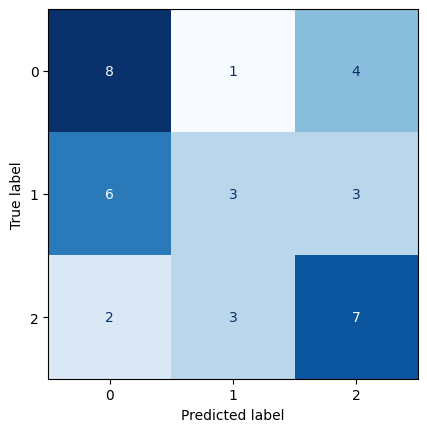

Evaluation metrics for TabNet performance in eval
Accuracy: 0.4864864864864865


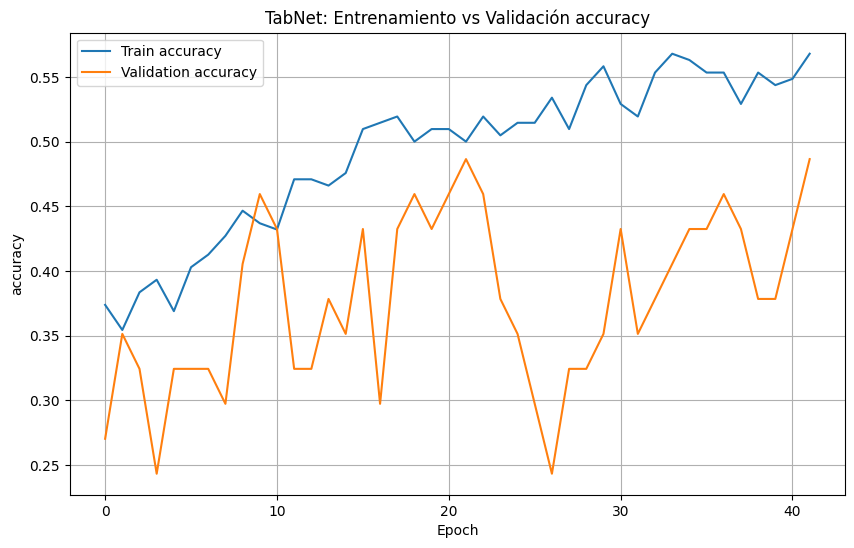


Early stopping occurred at epoch 27 with best_epoch = 7 and best_val_0_accuracy = 0.61905
Best parameters: {'momentum': 0.02, 'n_a': 32, 'n_d': 32}

Early stopping occurred at epoch 24 with best_epoch = 4 and best_val_1_accuracy = 0.61905


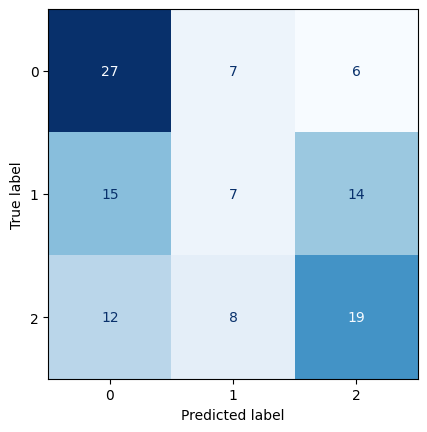

Evaluation metrics for TabNet performance in training
Accuracy: 0.4608695652173913


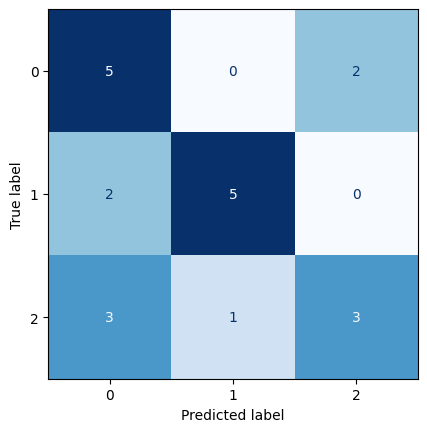

Evaluation metrics for TabNet performance in eval
Accuracy: 0.6190476190476191


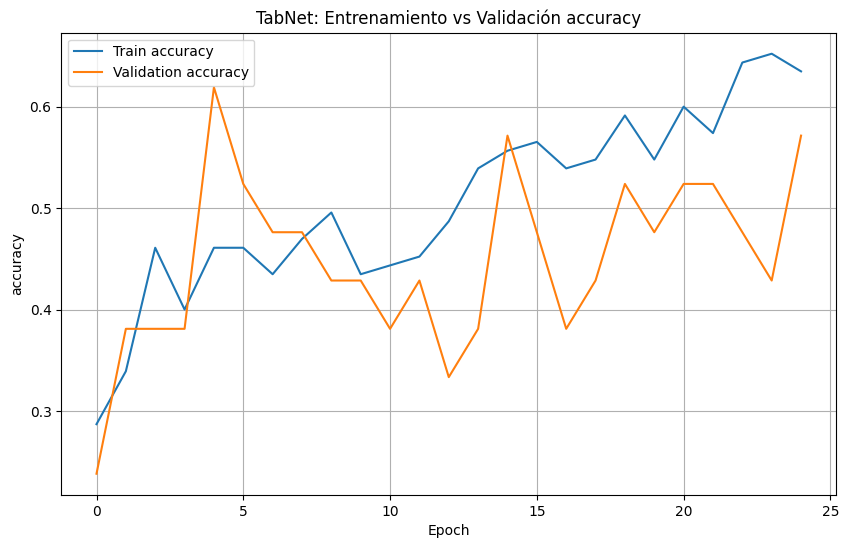


Early stopping occurred at epoch 31 with best_epoch = 11 and best_val_0_accuracy = 0.52174
Best parameters: {'momentum': 0.01, 'n_a': 32, 'n_d': 32}

Early stopping occurred at epoch 41 with best_epoch = 21 and best_val_1_accuracy = 0.6087


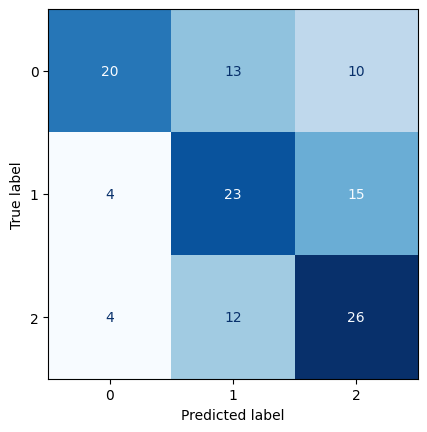

Evaluation metrics for TabNet performance in training
Accuracy: 0.5433070866141733


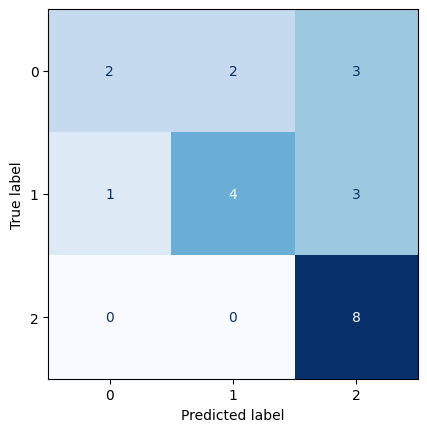

Evaluation metrics for TabNet performance in eval
Accuracy: 0.6086956521739131


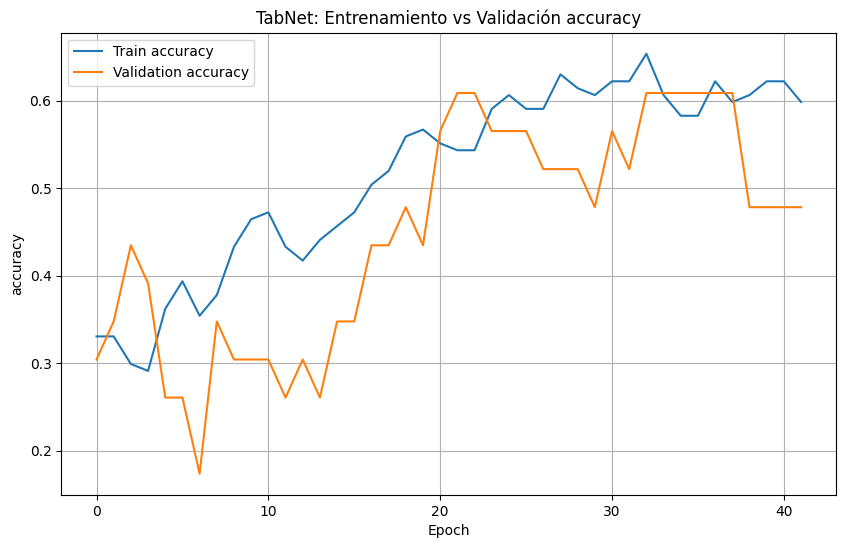


Early stopping occurred at epoch 41 with best_epoch = 21 and best_val_0_accuracy = 0.5
Best parameters: {'momentum': 0.01, 'n_a': 8, 'n_d': 32}

Early stopping occurred at epoch 20 with best_epoch = 0 and best_val_1_accuracy = 0.4375


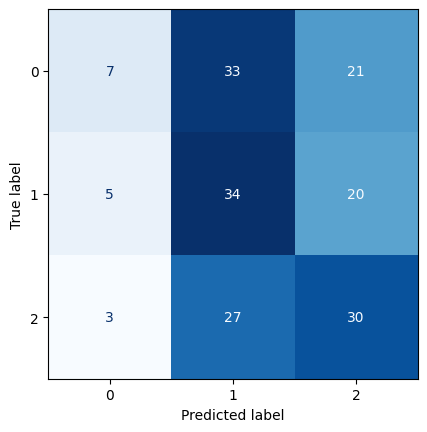

Evaluation metrics for TabNet performance in training
Accuracy: 0.39444444444444443


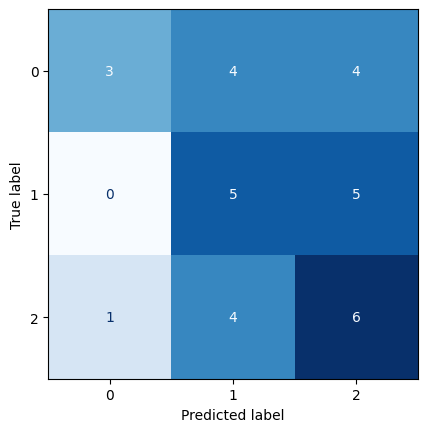

Evaluation metrics for TabNet performance in eval
Accuracy: 0.4375


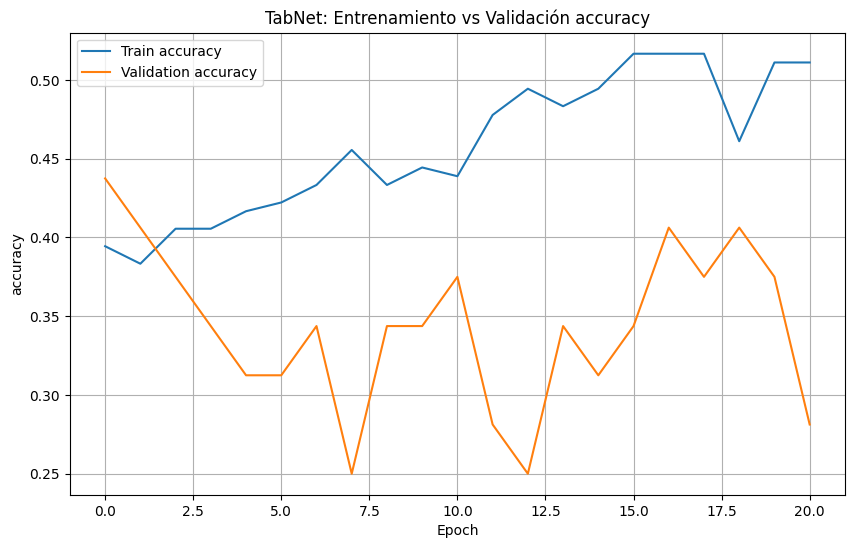


Early stopping occurred at epoch 47 with best_epoch = 27 and best_val_0_accuracy = 0.6
Best parameters: {'momentum': 0.15, 'n_a': 16, 'n_d': 16}

Early stopping occurred at epoch 33 with best_epoch = 13 and best_val_1_accuracy = 0.65


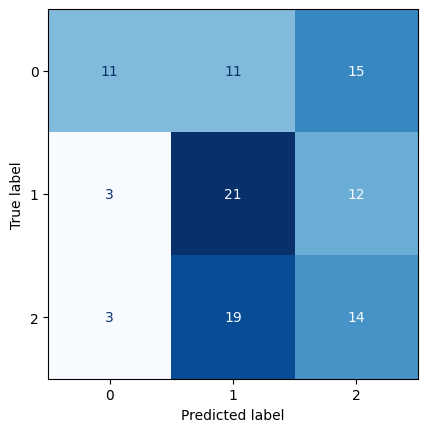

Evaluation metrics for TabNet performance in training
Accuracy: 0.42201834862385323


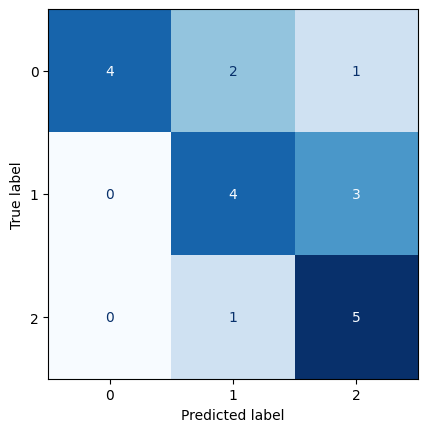

Evaluation metrics for TabNet performance in eval
Accuracy: 0.65


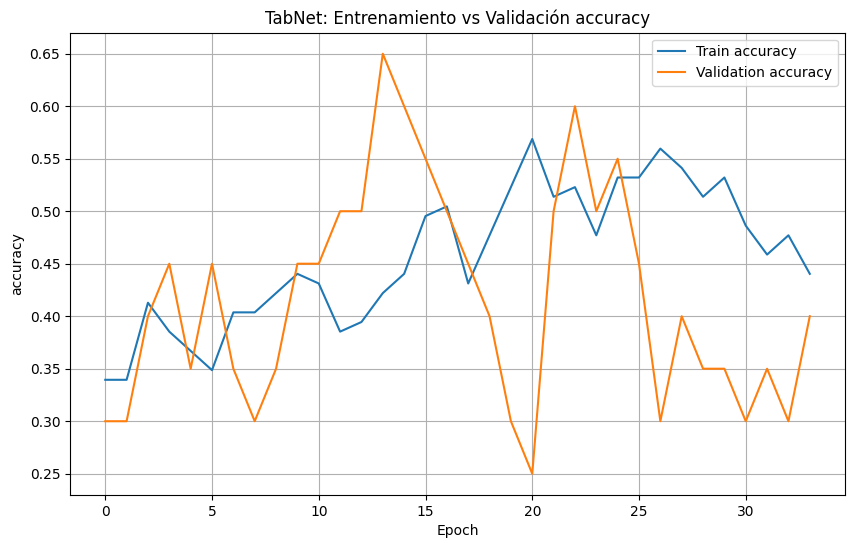

In [ ]:
parameters = {'n_d': (8, 16, 32), 'n_a': (8, 16, 32), 'momentum': (0.01, 0.02, 0.15)}

i=0
for x_train, y_train, x_eval, y_eval in zip(x_train_discrete2, y_train_discrete2, x_eval_discrete2, y_eval_discrete2):
  i+=1
  tabNet_discrete2 = TabNetClassifier(verbose=0)

  grid = GridSearchCV(tabNet_discrete2, parameters, n_jobs=2, cv=cv, scoring='neg_mean_squared_error')
  grid.fit(
    x_train, y_train,
    eval_set=[(x_eval, y_eval)],
    batch_size=64,
    virtual_batch_size=16,
    patience=20
  )

  best_tabNet_discrete2 = grid.best_estimator_
  print('Best parameters:', grid.best_params_)
  best_tabNet_discrete2.fit(
    x_train, y_train,
    eval_set=[(x_train, y_train), (x_eval, y_eval)],
    batch_size=64,
    virtual_batch_size=16,
    patience=20
  )

  # Predict on train test
  train_predictions = best_tabNet_discrete2.predict(x_train)
  # Predict on the test set
  predictions = best_tabNet_discrete2.predict(x_eval)

  # evaluate
  train_scores = evaluate_classification(y_train, train_predictions, 'TabNet performance in training')
  eval_scores = evaluate_classification(y_eval, predictions, 'TabNet performance in eval')

  all_scores_discrete['TabNet_discrete2_'+str(i)] = [train_scores, eval_scores]

  # 4. Obtener los logs de entrenamiento
  train_rmse = best_tabNet_discrete2.history['val_0_accuracy']
  val_rmse = best_tabNet_discrete2.history['val_1_accuracy']

  # 5. Graficar
  plt.figure(figsize=(10, 6))
  plt.plot(train_rmse, label='Train accuracy')
  plt.plot(val_rmse, label='Validation accuracy')
  plt.xlabel("Epoch")
  plt.ylabel("accuracy")
  plt.title("TabNet: Entrenamiento vs Validación accuracy")
  plt.legend()
  plt.grid(True)
  plt.show()

#### SVM

Best parameters: {'C': 2, 'gamma': 'scale', 'kernel': 'rbf'}


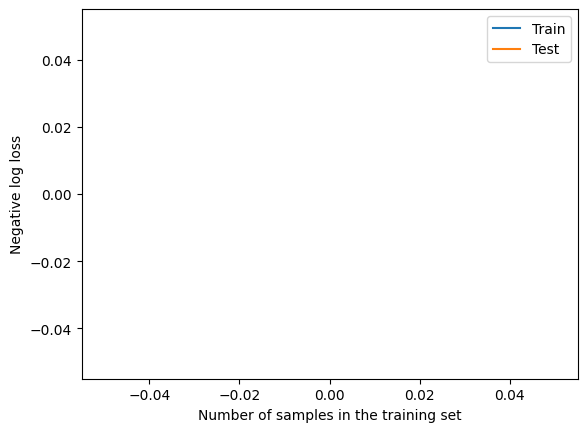

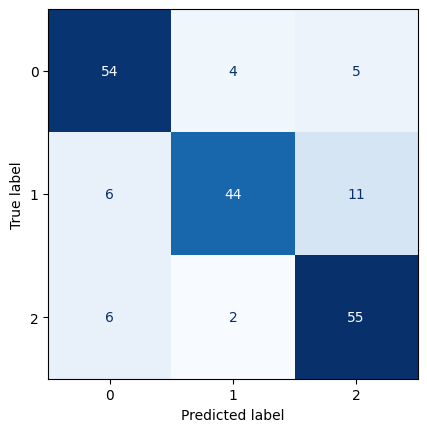

Evaluation metrics for svm_discrete2 performance in training
Accuracy: 0.8181818181818182


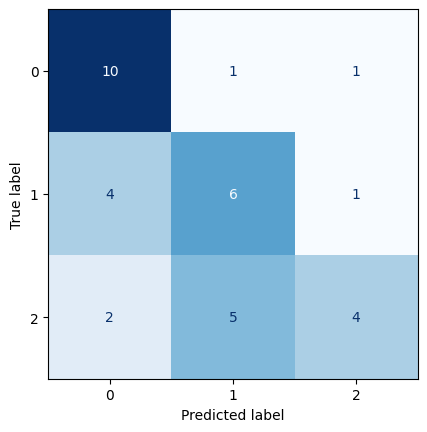

Evaluation metrics for svm_discrete2 performance in eval
Accuracy: 0.5882352941176471
Best parameters: {'C': 0.5, 'gamma': 'scale', 'kernel': 'poly'}


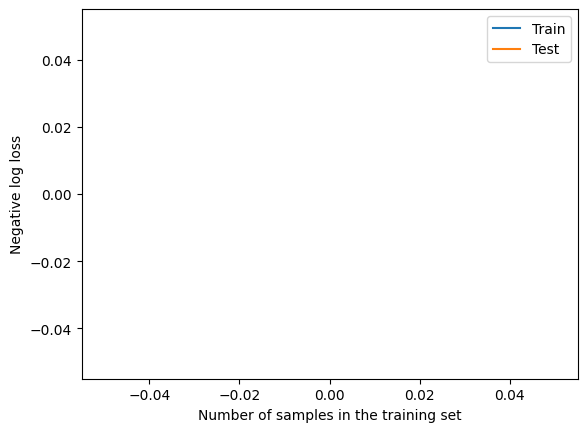

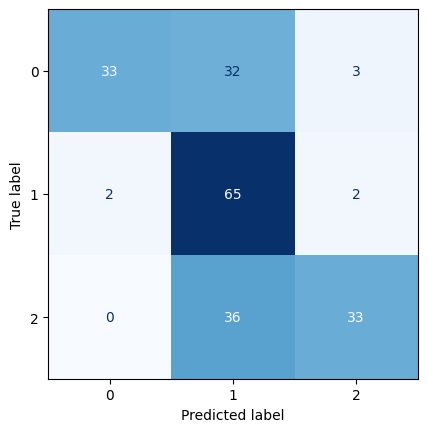

Evaluation metrics for svm_discrete2 performance in training
Accuracy: 0.6359223300970874


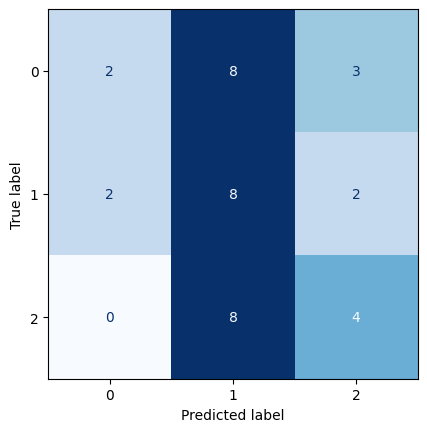

Evaluation metrics for svm_discrete2 performance in eval
Accuracy: 0.3783783783783784
Best parameters: {'C': 1, 'gamma': 'scale', 'kernel': 'rbf'}


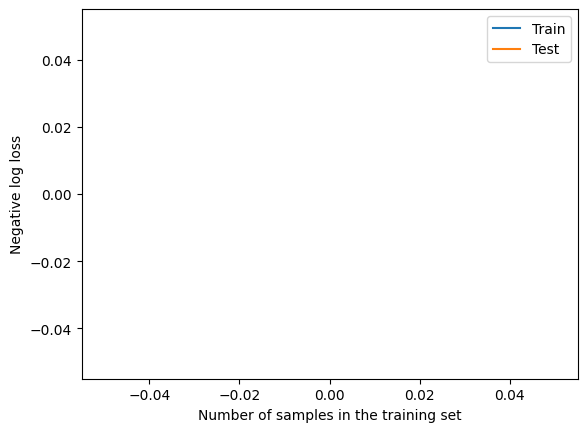

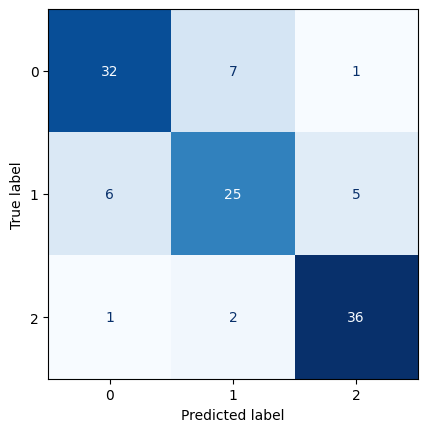

Evaluation metrics for svm_discrete2 performance in training
Accuracy: 0.808695652173913


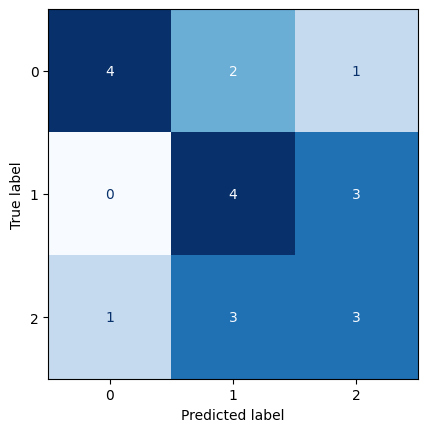

Evaluation metrics for svm_discrete2 performance in eval
Accuracy: 0.5238095238095238
Best parameters: {'C': 1, 'gamma': 'auto', 'kernel': 'poly'}


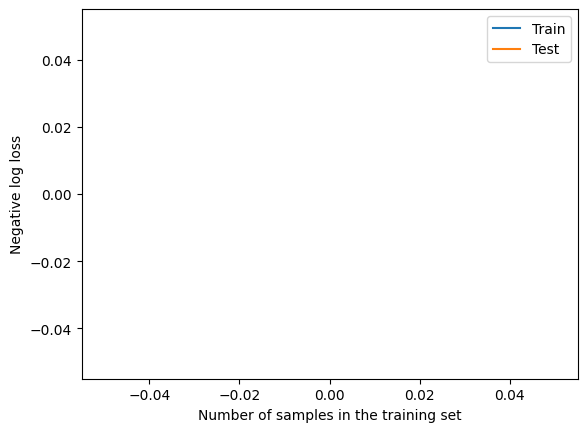

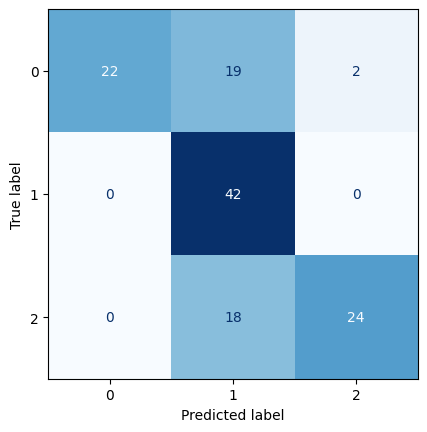

Evaluation metrics for svm_discrete2 performance in training
Accuracy: 0.6929133858267716


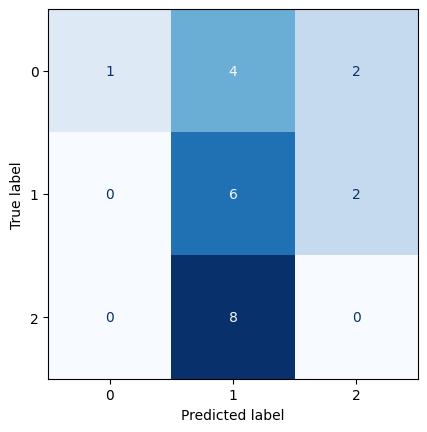

Evaluation metrics for svm_discrete2 performance in eval
Accuracy: 0.30434782608695654
Best parameters: {'C': 0.5, 'gamma': 'auto', 'kernel': 'rbf'}


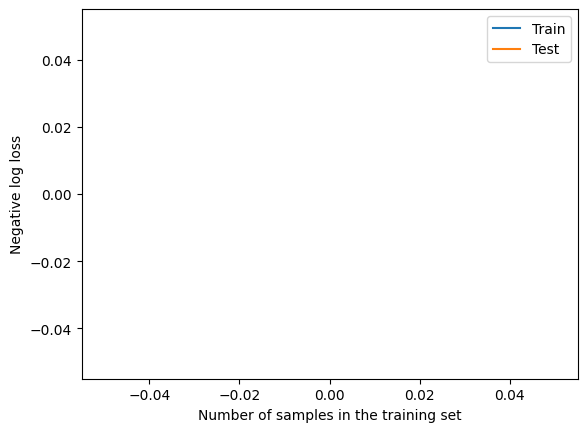

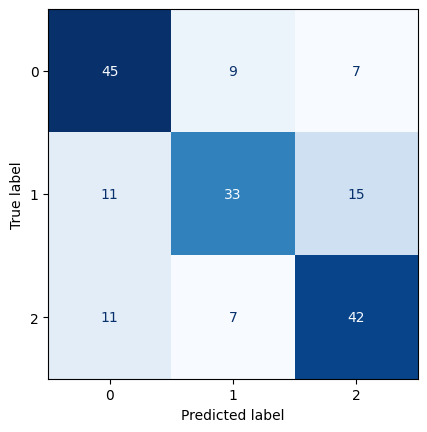

Evaluation metrics for svm_discrete2 performance in training
Accuracy: 0.6666666666666666


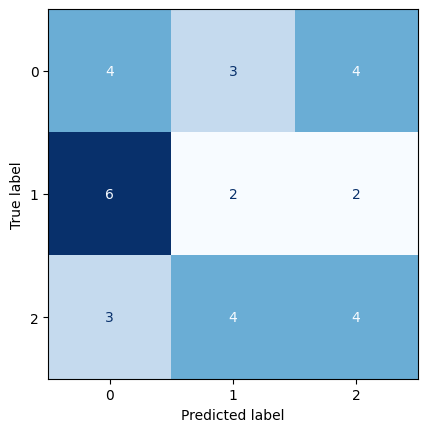

Evaluation metrics for svm_discrete2 performance in eval
Accuracy: 0.3125
Best parameters: {'C': 16, 'gamma': 'scale', 'kernel': 'rbf'}


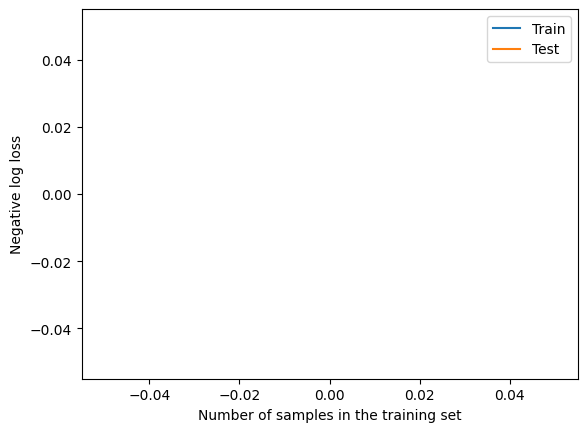

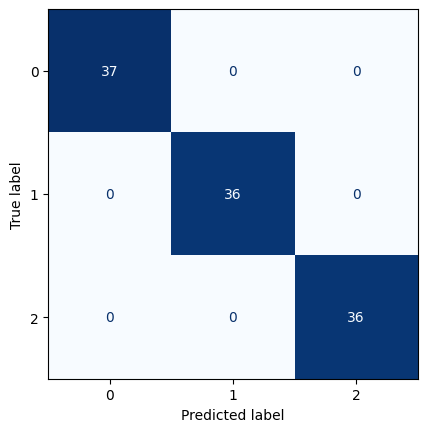

Evaluation metrics for svm_discrete2 performance in training
Accuracy: 1.0


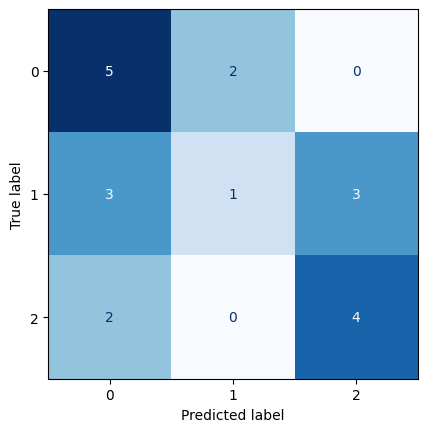

Evaluation metrics for svm_discrete2 performance in eval
Accuracy: 0.5


In [ ]:
parameters = {'kernel':('rbf', 'poly'), 'C':(0.1, 0.25, 0.5, 1, 2, 4, 8, 16), 'gamma':('scale', 'auto')}

i=0
for x_train, y_train, x_eval, y_eval in zip(x_train_discrete2, y_train_discrete2, x_eval_discrete2, y_eval_discrete2):
  i+=1
  svm_discrete2 = svm.SVC()

  grid = GridSearchCV(svm_discrete2, parameters, n_jobs=2, cv=cv)
  grid.fit(x_train, y_train)

  best_svm_discrete2 = grid.best_estimator_
  print('Best parameters:', grid.best_params_)

  LearningCurveDisplay.from_estimator(best_svm_discrete2, x_train, y_train, cv=cv, scoring='neg_log_loss')
  best_svm_discrete2.fit(x_train, y_train)

  # Predict on train test
  train_predictions = best_svm_discrete2.predict(x_train)
  # Predict on the test set
  predictions = best_svm_discrete2.predict(x_eval)

  # evaluate
  train_scores = evaluate_classification(y_train, train_predictions, 'svm_discrete2 performance in training')
  eval_scores = evaluate_classification(y_eval, predictions, 'svm_discrete2 performance in eval')

  all_scores_discrete['svm_discrete2_'+str(i)] = [train_scores, eval_scores]

#### XGBoost

[0]	validation_0-mlogloss:1.09039
[1]	validation_0-mlogloss:1.08230
[2]	validation_0-mlogloss:1.07546
[3]	validation_0-mlogloss:1.06945
[4]	validation_0-mlogloss:1.06237
[5]	validation_0-mlogloss:1.05686
[6]	validation_0-mlogloss:1.05107
[7]	validation_0-mlogloss:1.04691
[8]	validation_0-mlogloss:1.04258
[9]	validation_0-mlogloss:1.03847
[10]	validation_0-mlogloss:1.03508
[11]	validation_0-mlogloss:1.03223
[12]	validation_0-mlogloss:1.02932
[13]	validation_0-mlogloss:1.02861
[14]	validation_0-mlogloss:1.02651
[15]	validation_0-mlogloss:1.02313
[16]	validation_0-mlogloss:1.02216
[17]	validation_0-mlogloss:1.01960
[18]	validation_0-mlogloss:1.01932
[19]	validation_0-mlogloss:1.01639
[20]	validation_0-mlogloss:1.01629
[21]	validation_0-mlogloss:1.01211
[22]	validation_0-mlogloss:1.01000
[23]	validation_0-mlogloss:1.00651
[24]	validation_0-mlogloss:1.00405
[25]	validation_0-mlogloss:1.00300
[26]	validation_0-mlogloss:1.00067
[27]	validation_0-mlogloss:0.99786
[28]	validation_0-mlogloss:0.9

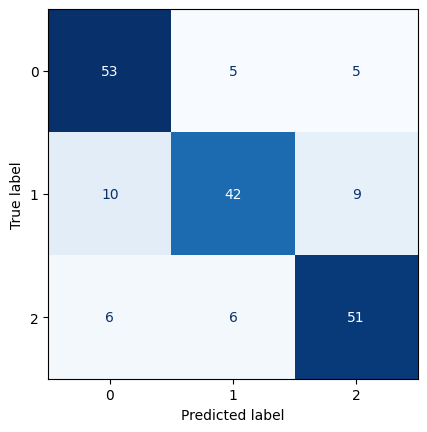

Evaluation metrics for XGB performance in training
Accuracy: 0.7807486631016043


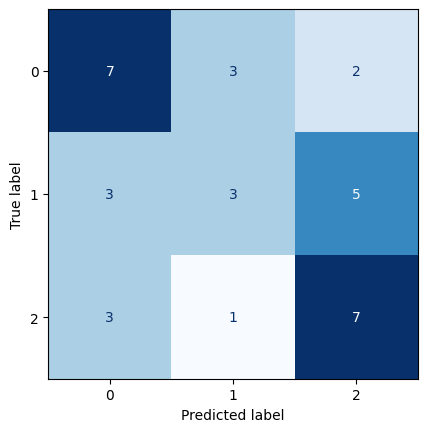

Evaluation metrics for XGB performance in eval
Accuracy: 0.5


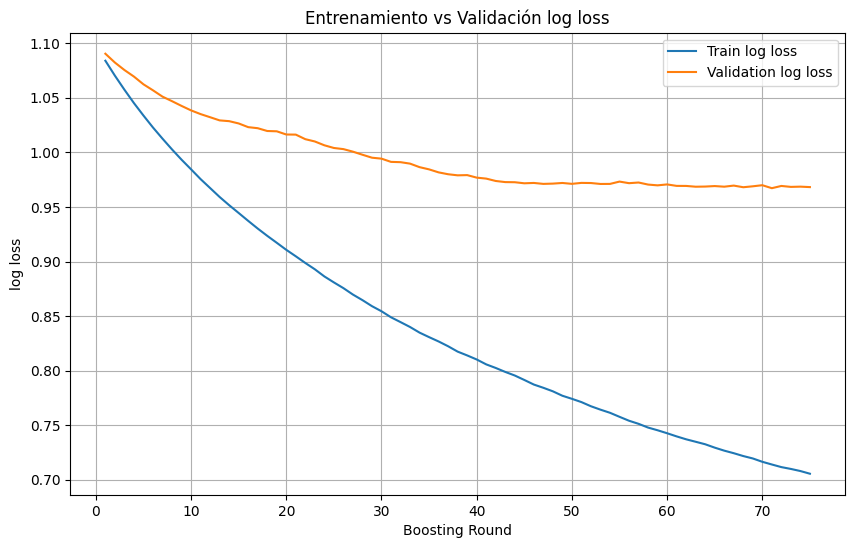

[0]	validation_0-mlogloss:1.09946
[1]	validation_0-mlogloss:1.09829
[2]	validation_0-mlogloss:1.09774
[3]	validation_0-mlogloss:1.09454
[4]	validation_0-mlogloss:1.09595
[5]	validation_0-mlogloss:1.09495
[6]	validation_0-mlogloss:1.09381
[7]	validation_0-mlogloss:1.09306
[8]	validation_0-mlogloss:1.09341
[9]	validation_0-mlogloss:1.09463
[10]	validation_0-mlogloss:1.09422
[11]	validation_0-mlogloss:1.09541
[12]	validation_0-mlogloss:1.09809
[13]	validation_0-mlogloss:1.09975
[14]	validation_0-mlogloss:1.10353
[15]	validation_0-mlogloss:1.10761
[16]	validation_0-mlogloss:1.10890
Best parameters: {'learning_rate': 0.05, 'max_depth': 6, 'n_estimators': 25}
[0]	validation_0-mlogloss:1.06820	validation_1-mlogloss:1.09946
[1]	validation_0-mlogloss:1.03866	validation_1-mlogloss:1.09829
[2]	validation_0-mlogloss:1.01091	validation_1-mlogloss:1.09774
[3]	validation_0-mlogloss:0.98423	validation_1-mlogloss:1.09454
[4]	validation_0-mlogloss:0.95530	validation_1-mlogloss:1.09595
[5]	validation_0-m

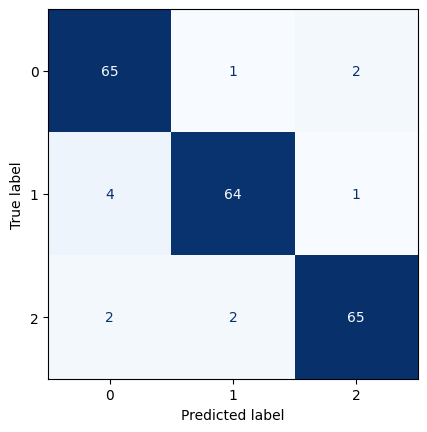

Evaluation metrics for XGB performance in training
Accuracy: 0.941747572815534


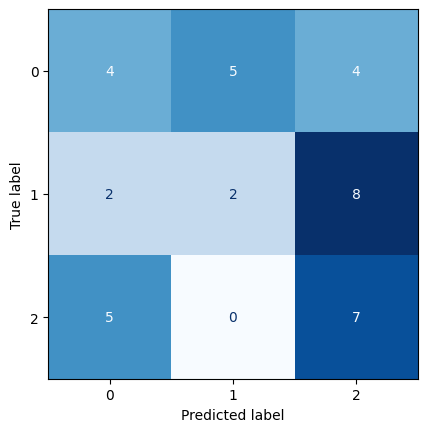

Evaluation metrics for XGB performance in eval
Accuracy: 0.35135135135135137


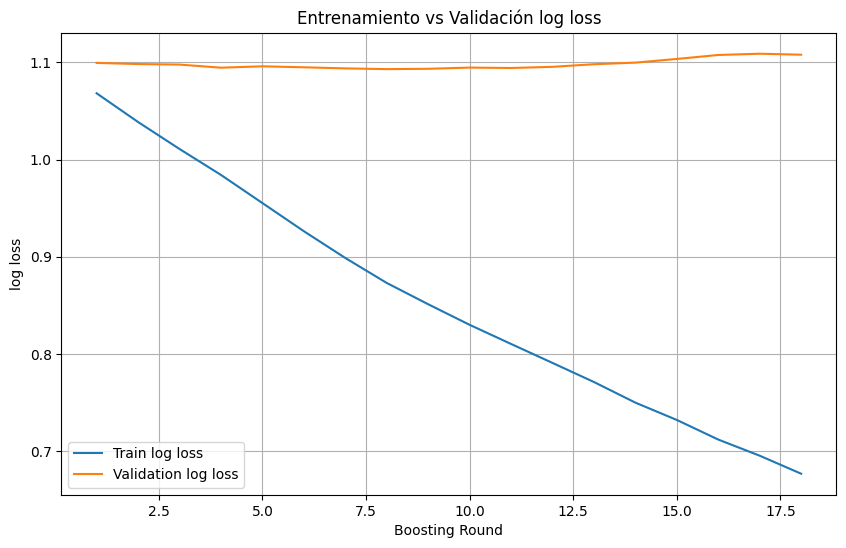

[0]	validation_0-mlogloss:1.07687
[1]	validation_0-mlogloss:1.05559
[2]	validation_0-mlogloss:1.03766
[3]	validation_0-mlogloss:1.01997
[4]	validation_0-mlogloss:1.00561
[5]	validation_0-mlogloss:0.99042
[6]	validation_0-mlogloss:0.97825
[7]	validation_0-mlogloss:0.96403
[8]	validation_0-mlogloss:0.94922
[9]	validation_0-mlogloss:0.93576
[10]	validation_0-mlogloss:0.92487
[11]	validation_0-mlogloss:0.91254
[12]	validation_0-mlogloss:0.90596
[13]	validation_0-mlogloss:0.89315
[14]	validation_0-mlogloss:0.88752
[15]	validation_0-mlogloss:0.87787
[16]	validation_0-mlogloss:0.87248
[17]	validation_0-mlogloss:0.86080
[18]	validation_0-mlogloss:0.85746
[19]	validation_0-mlogloss:0.85274
[20]	validation_0-mlogloss:0.84500
[21]	validation_0-mlogloss:0.83922
[22]	validation_0-mlogloss:0.83316
[23]	validation_0-mlogloss:0.82925
[24]	validation_0-mlogloss:0.82414
[25]	validation_0-mlogloss:0.81670
[26]	validation_0-mlogloss:0.81452
[27]	validation_0-mlogloss:0.81596
[28]	validation_0-mlogloss:0.8

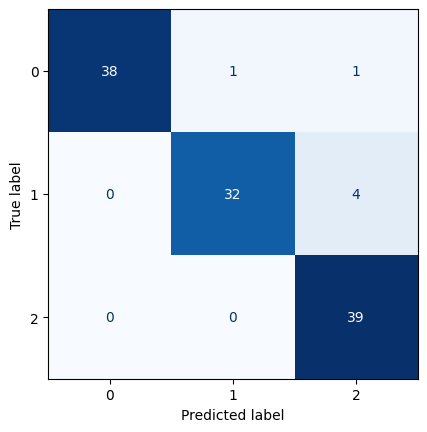

Evaluation metrics for XGB performance in training
Accuracy: 0.9478260869565217


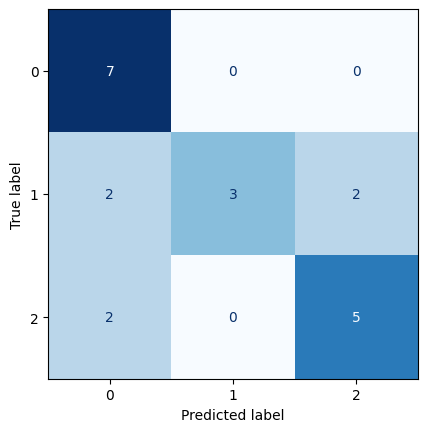

Evaluation metrics for XGB performance in eval
Accuracy: 0.7142857142857143


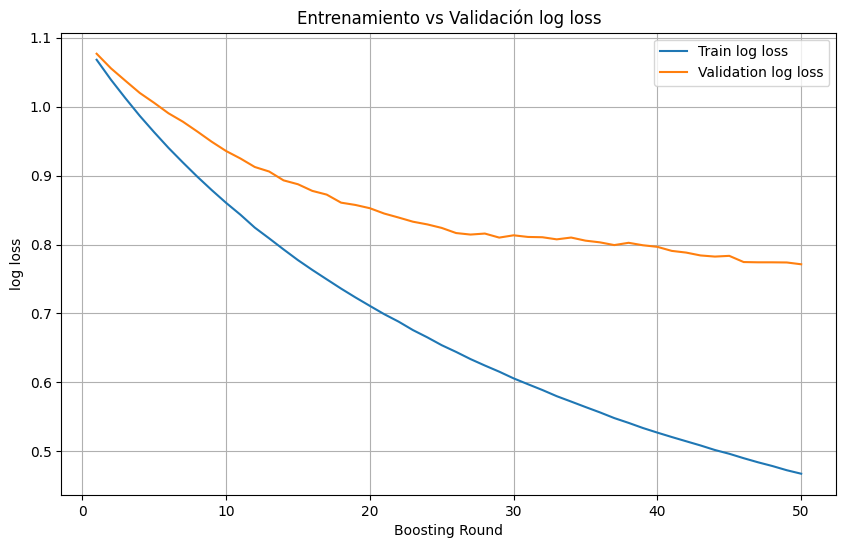

[0]	validation_0-mlogloss:1.09287
[1]	validation_0-mlogloss:1.08699
[2]	validation_0-mlogloss:1.08283
[3]	validation_0-mlogloss:1.07822
[4]	validation_0-mlogloss:1.07309
[5]	validation_0-mlogloss:1.06830
[6]	validation_0-mlogloss:1.06558
[7]	validation_0-mlogloss:1.06358
[8]	validation_0-mlogloss:1.06187
[9]	validation_0-mlogloss:1.05852
[10]	validation_0-mlogloss:1.05555
[11]	validation_0-mlogloss:1.05484
[12]	validation_0-mlogloss:1.05211
[13]	validation_0-mlogloss:1.05125
[14]	validation_0-mlogloss:1.05019
[15]	validation_0-mlogloss:1.05039
[16]	validation_0-mlogloss:1.04997
[17]	validation_0-mlogloss:1.04686
[18]	validation_0-mlogloss:1.04044
[19]	validation_0-mlogloss:1.03891
[20]	validation_0-mlogloss:1.03413
[21]	validation_0-mlogloss:1.02953
[22]	validation_0-mlogloss:1.02012
[23]	validation_0-mlogloss:1.01392
[24]	validation_0-mlogloss:1.01152
[25]	validation_0-mlogloss:1.00340
[26]	validation_0-mlogloss:0.99946
[27]	validation_0-mlogloss:0.99933
[28]	validation_0-mlogloss:0.9

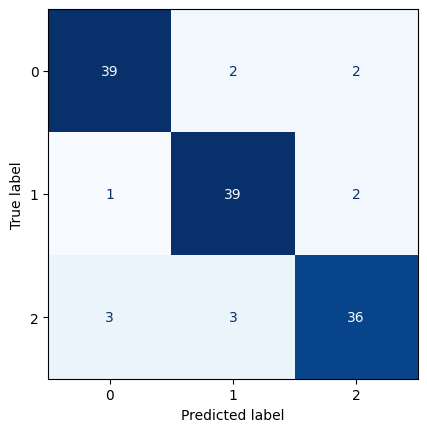

Evaluation metrics for XGB performance in training
Accuracy: 0.8976377952755905


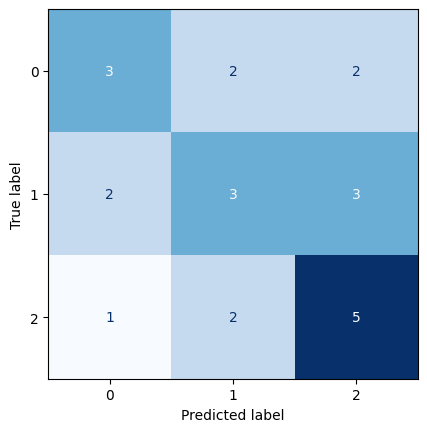

Evaluation metrics for XGB performance in eval
Accuracy: 0.4782608695652174


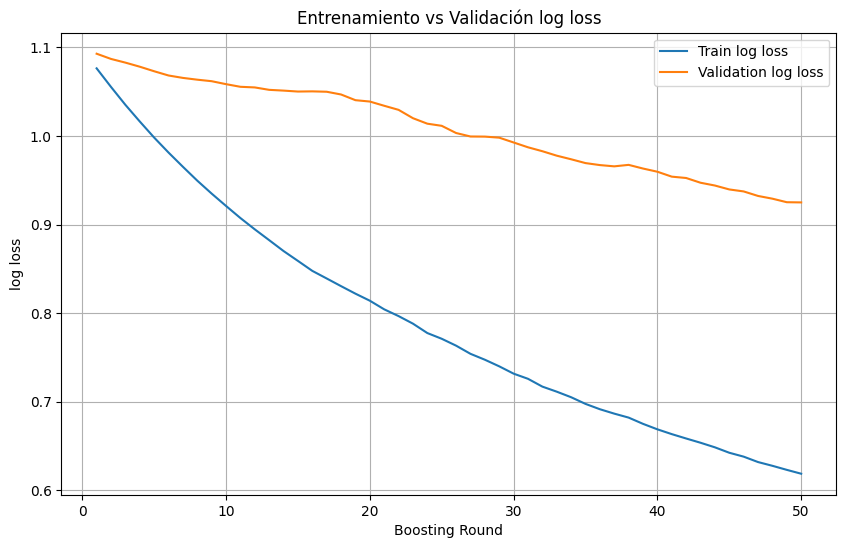

[0]	validation_0-mlogloss:1.09175
[1]	validation_0-mlogloss:1.08359
[2]	validation_0-mlogloss:1.07708
[3]	validation_0-mlogloss:1.07356
[4]	validation_0-mlogloss:1.06734
[5]	validation_0-mlogloss:1.06478
[6]	validation_0-mlogloss:1.05860
[7]	validation_0-mlogloss:1.05555
[8]	validation_0-mlogloss:1.05088
[9]	validation_0-mlogloss:1.04802
[10]	validation_0-mlogloss:1.04323
[11]	validation_0-mlogloss:1.04178
[12]	validation_0-mlogloss:1.03607
[13]	validation_0-mlogloss:1.03439
[14]	validation_0-mlogloss:1.03164
[15]	validation_0-mlogloss:1.03083
[16]	validation_0-mlogloss:1.02687
[17]	validation_0-mlogloss:1.02548
[18]	validation_0-mlogloss:1.02249
[19]	validation_0-mlogloss:1.02232
[20]	validation_0-mlogloss:1.01980
[21]	validation_0-mlogloss:1.01876
[22]	validation_0-mlogloss:1.01588
[23]	validation_0-mlogloss:1.01499
[24]	validation_0-mlogloss:1.01410
[25]	validation_0-mlogloss:1.01189
[26]	validation_0-mlogloss:1.01273
[27]	validation_0-mlogloss:1.01083
[28]	validation_0-mlogloss:1.0

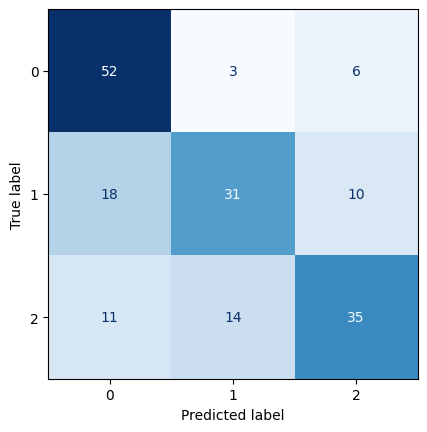

Evaluation metrics for XGB performance in training
Accuracy: 0.6555555555555556


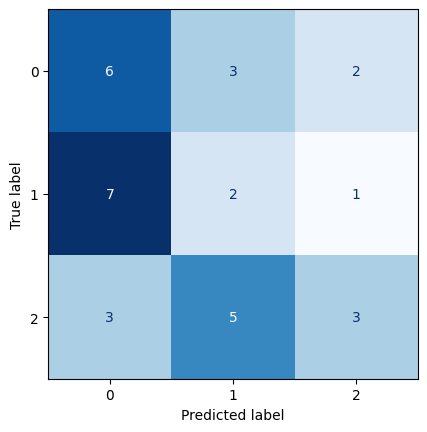

Evaluation metrics for XGB performance in eval
Accuracy: 0.34375


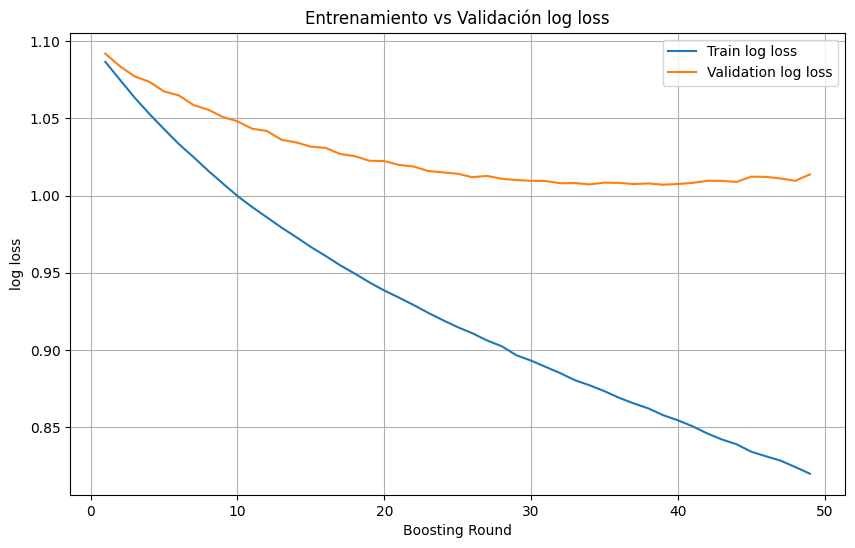

[0]	validation_0-mlogloss:1.10832
[1]	validation_0-mlogloss:1.11828
[2]	validation_0-mlogloss:1.12614
[3]	validation_0-mlogloss:1.13231
[4]	validation_0-mlogloss:1.14440
[5]	validation_0-mlogloss:1.15503
[6]	validation_0-mlogloss:1.15562
[7]	validation_0-mlogloss:1.16209
[8]	validation_0-mlogloss:1.16287
[9]	validation_0-mlogloss:1.17279
[10]	validation_0-mlogloss:1.17747
Best parameters: {'learning_rate': 0.1, 'max_depth': 3, 'n_estimators': 25}
[0]	validation_0-mlogloss:1.04865	validation_1-mlogloss:1.10832
[1]	validation_0-mlogloss:1.00403	validation_1-mlogloss:1.11828
[2]	validation_0-mlogloss:0.96477	validation_1-mlogloss:1.12614
[3]	validation_0-mlogloss:0.92811	validation_1-mlogloss:1.13231
[4]	validation_0-mlogloss:0.89566	validation_1-mlogloss:1.14440
[5]	validation_0-mlogloss:0.86471	validation_1-mlogloss:1.15503
[6]	validation_0-mlogloss:0.83543	validation_1-mlogloss:1.15562
[7]	validation_0-mlogloss:0.80873	validation_1-mlogloss:1.16209
[8]	validation_0-mlogloss:0.78385	val

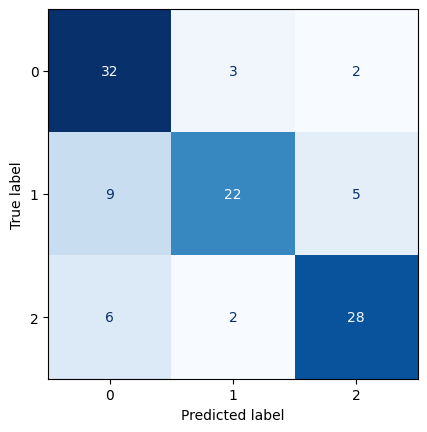

Evaluation metrics for XGB performance in training
Accuracy: 0.7522935779816514


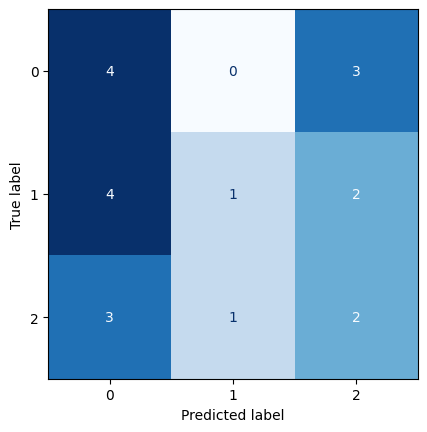

Evaluation metrics for XGB performance in eval
Accuracy: 0.35


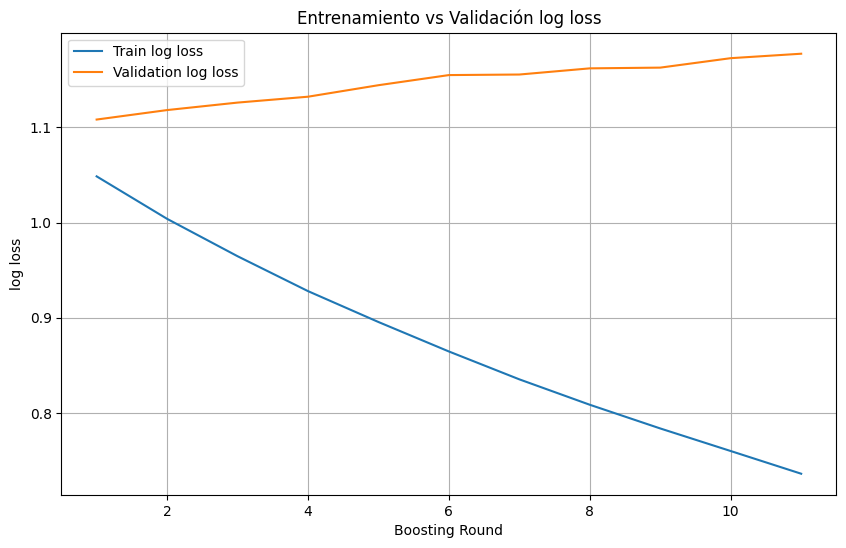

In [ ]:
parameters = { 'max_depth':(2, 3, 6, 12), 'learning_rate':(0.05, 0.1, 0.3, 0.9), 'n_estimators':(25, 50, 75, 150, 300)  }

i=0
for x_train, y_train, x_eval, y_eval in zip(x_train_discrete2, y_train_discrete2, x_eval_discrete2, y_eval_discrete2):
  i+=1
  XGB_discrete2 = xgb.XGBClassifier(tree_method="hist", early_stopping_rounds=10, verbosity=0) #hist porque es más rápido

  grid = GridSearchCV(XGB_discrete2, parameters, n_jobs=2, cv=cv)
  grid.fit(x_train, y_train, eval_set=[(x_eval, y_eval)])

  best_XGB_discrete2 = grid.best_estimator_
  print('Best parameters:', grid.best_params_)
  best_XGB_discrete2.fit(x_train, y_train, eval_set=[(x_train, y_train),(x_eval, y_eval)])
  # Predict on train test
  train_predictions = best_XGB_discrete2.predict(x_train)
  # Predict on the test set
  predictions = best_XGB_discrete2.predict(x_eval)

  # evaluate
  train_scores = evaluate_classification(y_train, train_predictions, 'XGB performance in training')
  eval_scores = evaluate_classification(y_eval, predictions, 'XGB performance in eval')

  all_scores_discrete['XGB_discrete2_'+str(i)] = [train_scores, eval_scores]

  # 4. Obtener resultados
  results = best_XGB_discrete2.evals_result()

  # 5. Graficar
  epochs = range(1, len(results['validation_0']['mlogloss']) + 1)
  train_rmse = results['validation_0']['mlogloss']
  val_rmse = results['validation_1']['mlogloss']

  plt.figure(figsize=(10, 6))
  plt.plot(epochs, train_rmse, label='Train log loss')
  plt.plot(epochs, val_rmse, label='Validation log loss')
  plt.xlabel("Boosting Round")
  plt.ylabel("log loss")
  plt.title("Entrenamiento vs Validación log loss")
  plt.legend()
  plt.grid(True)
  plt.show()

#### RandomForest

Best parameters: {'max_depth': None, 'max_features': 'sqrt', 'min_samples_leaf': 2, 'min_samples_split': 5, 'n_estimators': 100}


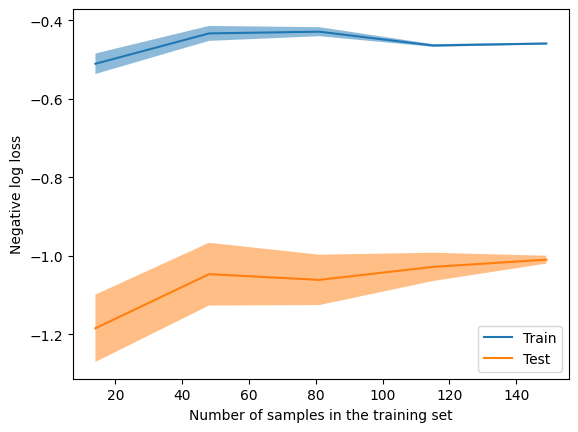

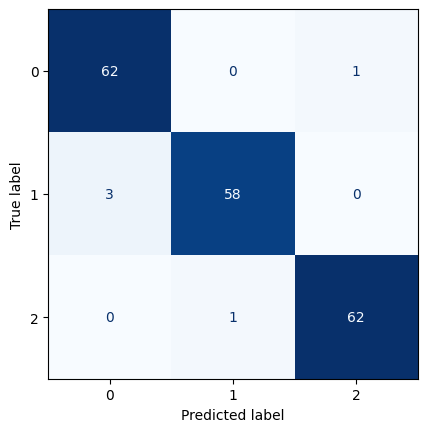

Evaluation metrics for rf_discrete2 performance in training
Accuracy: 0.9732620320855615


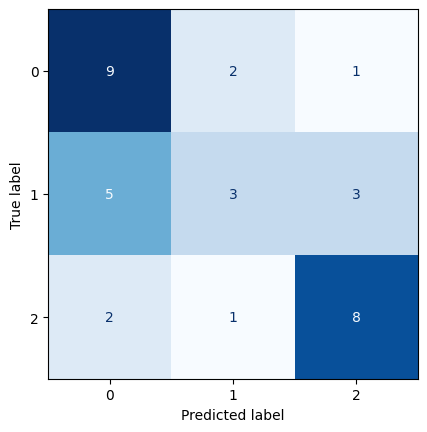

Evaluation metrics for rf_discrete2 performance in eval
Accuracy: 0.5882352941176471
Best parameters: {'max_depth': 10, 'max_features': 'sqrt', 'min_samples_leaf': 4, 'min_samples_split': 2, 'n_estimators': 25}


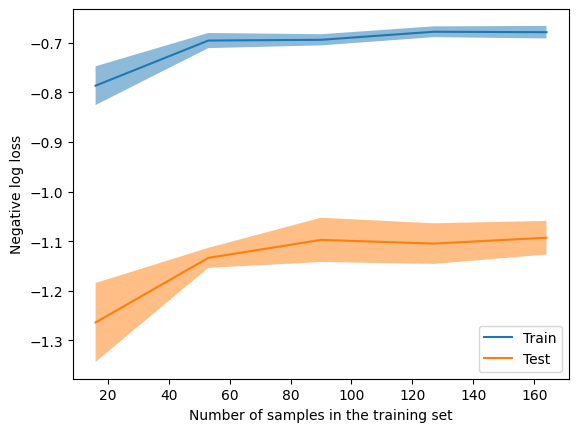

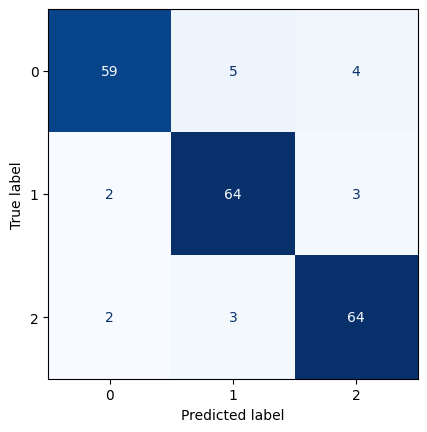

Evaluation metrics for rf_discrete2 performance in training
Accuracy: 0.9077669902912622


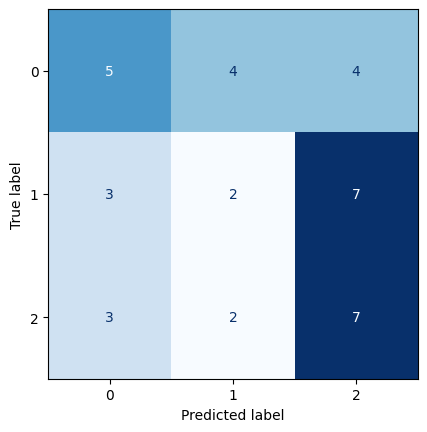

Evaluation metrics for rf_discrete2 performance in eval
Accuracy: 0.3783783783783784
Best parameters: {'max_depth': None, 'max_features': 'sqrt', 'min_samples_leaf': 2, 'min_samples_split': 5, 'n_estimators': 200}


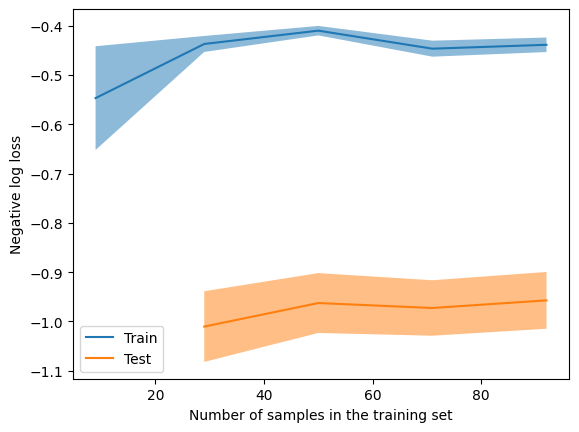

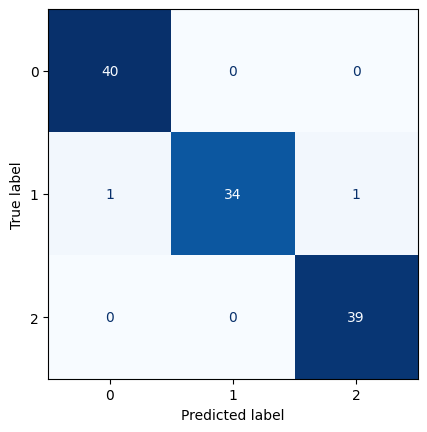

Evaluation metrics for rf_discrete2 performance in training
Accuracy: 0.9826086956521739


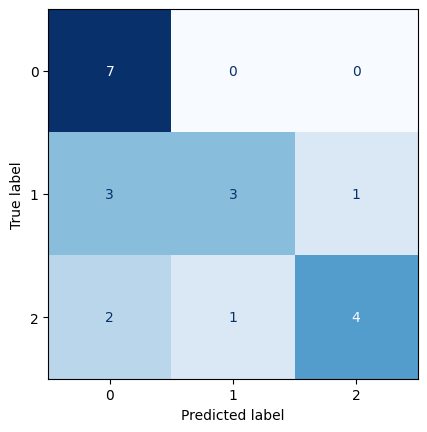

Evaluation metrics for rf_discrete2 performance in eval
Accuracy: 0.6666666666666666
Best parameters: {'max_depth': 10, 'max_features': 'sqrt', 'min_samples_leaf': 1, 'min_samples_split': 2, 'n_estimators': 200}


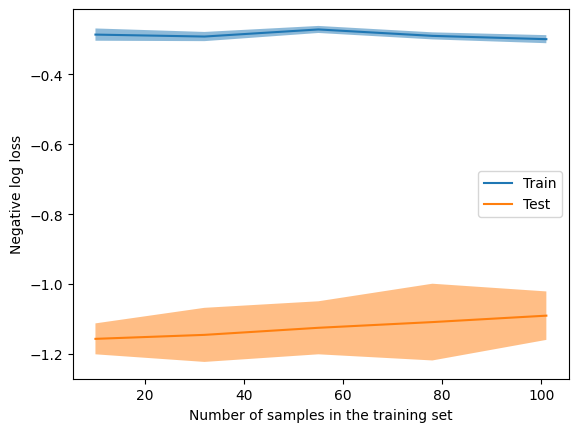

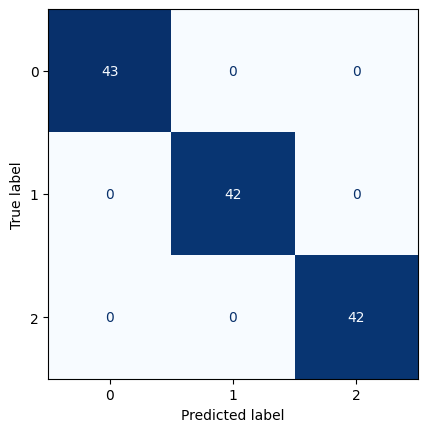

Evaluation metrics for rf_discrete2 performance in training
Accuracy: 1.0


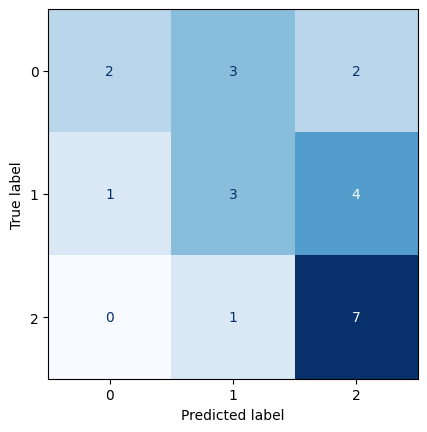

Evaluation metrics for rf_discrete2 performance in eval
Accuracy: 0.5217391304347826
Best parameters: {'max_depth': None, 'max_features': 'sqrt', 'min_samples_leaf': 1, 'min_samples_split': 2, 'n_estimators': 100}


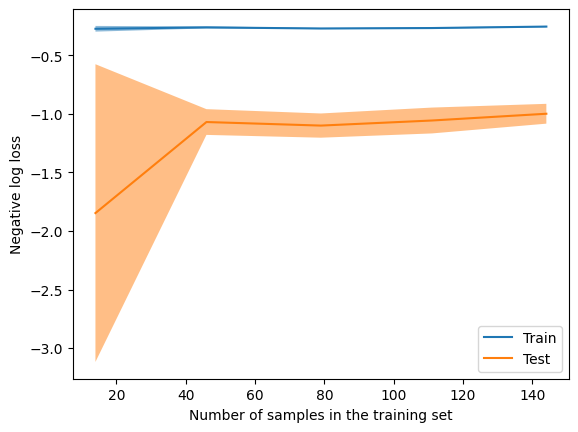

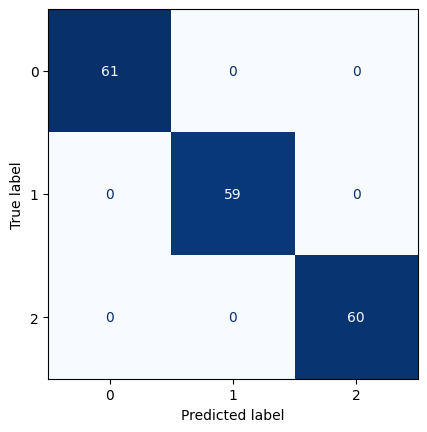

Evaluation metrics for rf_discrete2 performance in training
Accuracy: 1.0


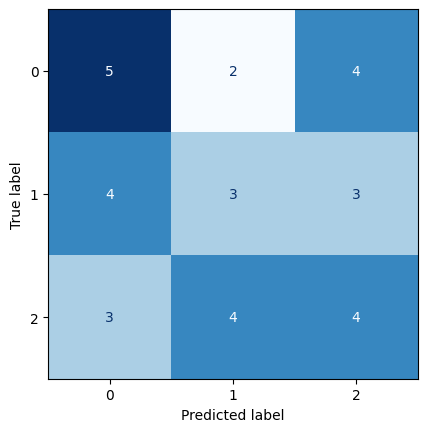

Evaluation metrics for rf_discrete2 performance in eval
Accuracy: 0.375
Best parameters: {'max_depth': None, 'max_features': 'sqrt', 'min_samples_leaf': 4, 'min_samples_split': 2, 'n_estimators': 50}


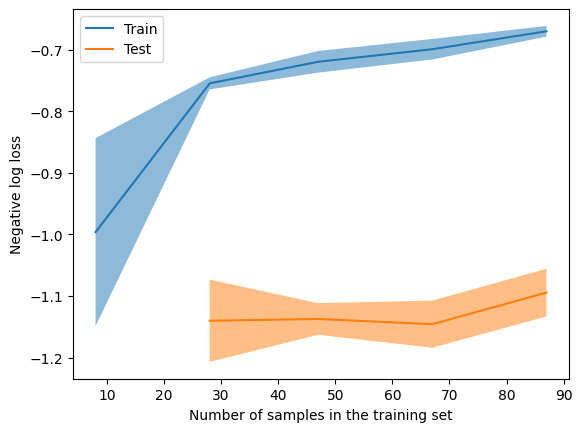

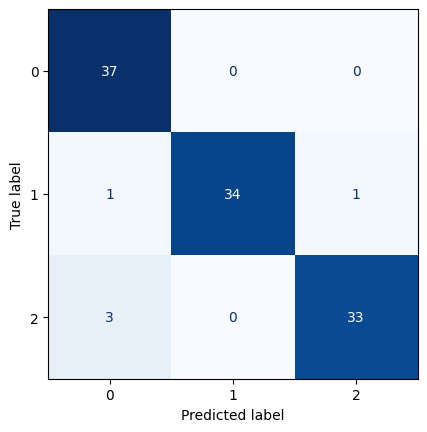

Evaluation metrics for rf_discrete2 performance in training
Accuracy: 0.9541284403669725


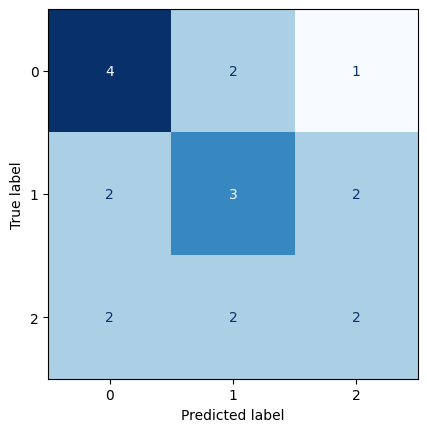

Evaluation metrics for rf_discrete2 performance in eval
Accuracy: 0.45


In [ ]:
parameters = {
    'n_estimators': [25, 50, 100, 200],
    'max_depth': [None, 10, 15, 20],
    'min_samples_split': [2, 5, 10],
    'min_samples_leaf': [1, 2, 4],
    'max_features': ['sqrt', 'log2']
}

i=0
for x_train, y_train, x_eval, y_eval in zip(x_train_discrete2, y_train_discrete2, x_eval_discrete2, y_eval_discrete2):
  i+=1
  rf_discrete2 = RandomForestClassifier(n_estimators=100, random_state=42)

  grid = GridSearchCV(rf_discrete2, parameters, n_jobs=2, cv=cv)
  grid.fit(x_train, y_train)

  best_rf_discrete2 = grid.best_estimator_
  print('Best parameters:', grid.best_params_)

  LearningCurveDisplay.from_estimator(best_rf_discrete2, x_train, y_train, cv=cv, scoring='neg_log_loss')
  best_rf_discrete2.fit(x_train, y_train)

  # Predict on train test
  train_predictions = best_rf_discrete2.predict(x_train)
  # Predict on the test set
  predictions = best_rf_discrete2.predict(x_eval)

  # evaluate
  train_scores = evaluate_classification(y_train, train_predictions, 'rf_discrete2 performance in training')
  eval_scores = evaluate_classification(y_eval, predictions, 'rf_discrete2 performance in eval')

  all_scores_discrete['rf_discrete2_'+str(i)] = [train_scores, eval_scores]

#### Resultados

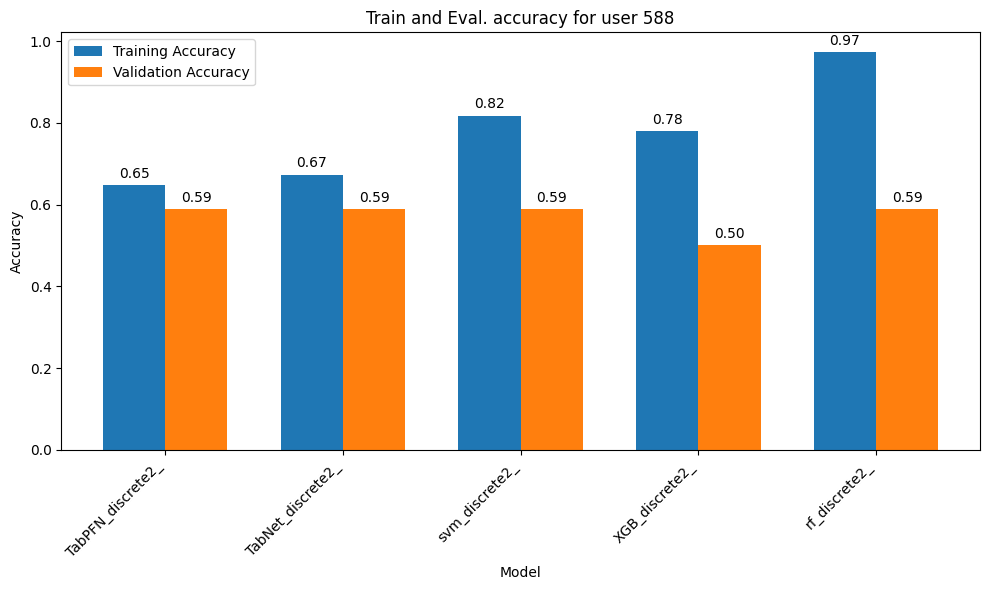

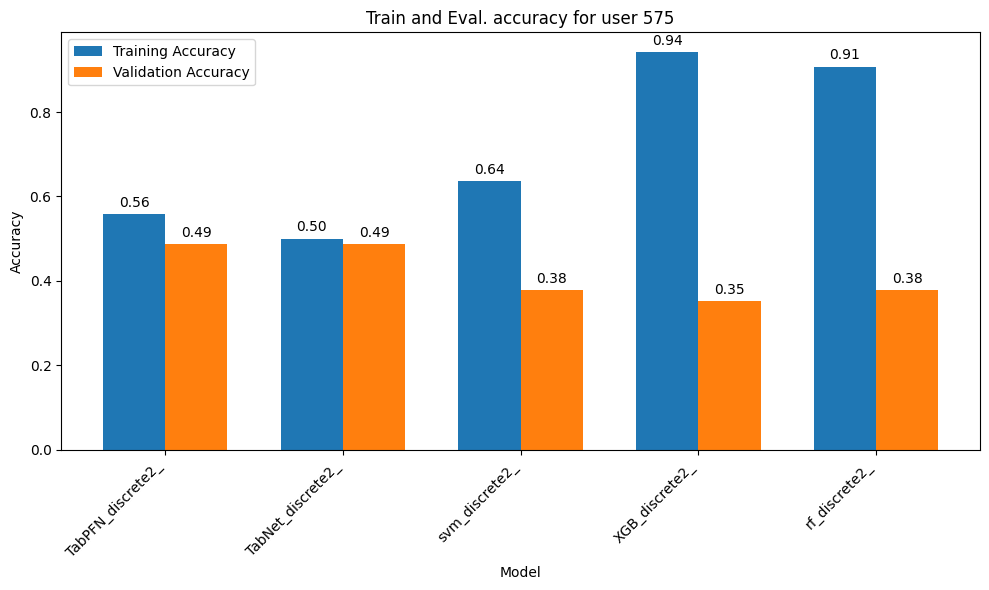

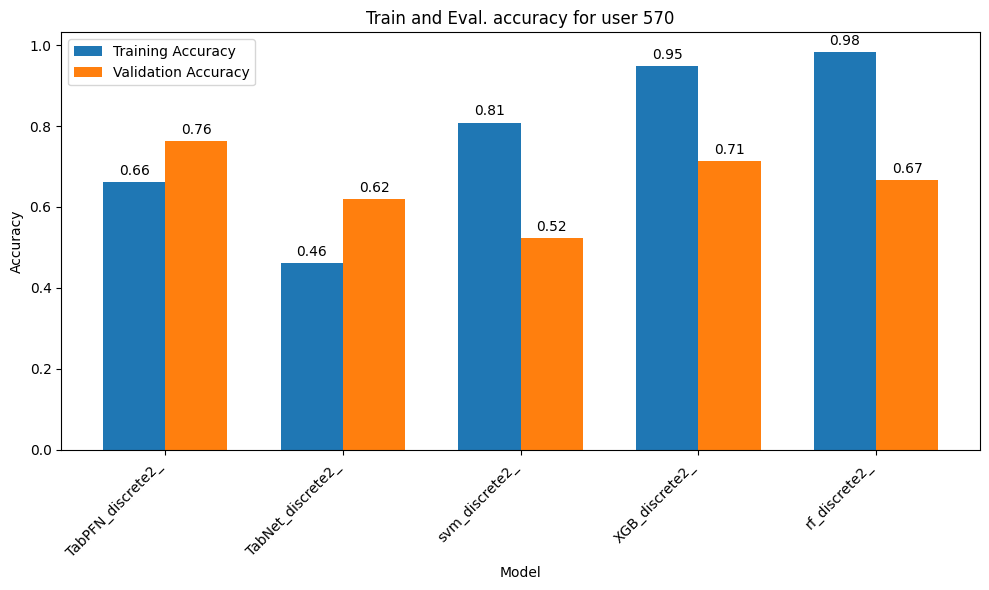

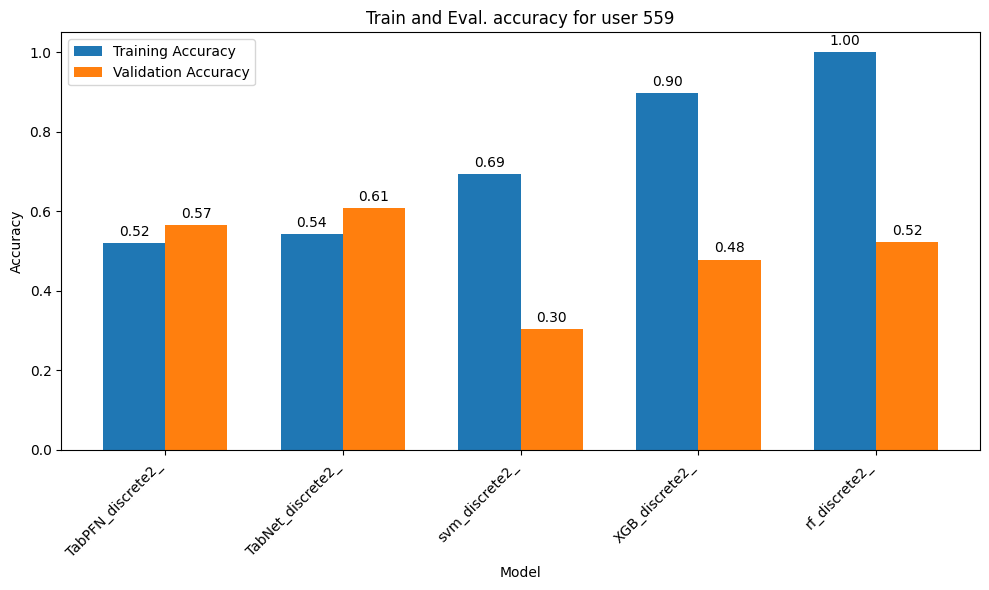

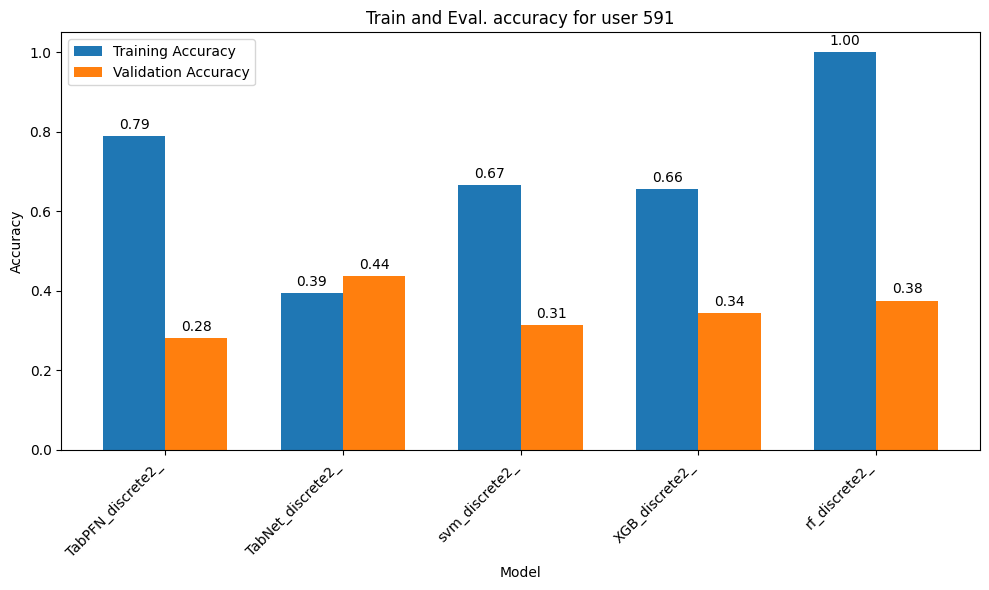

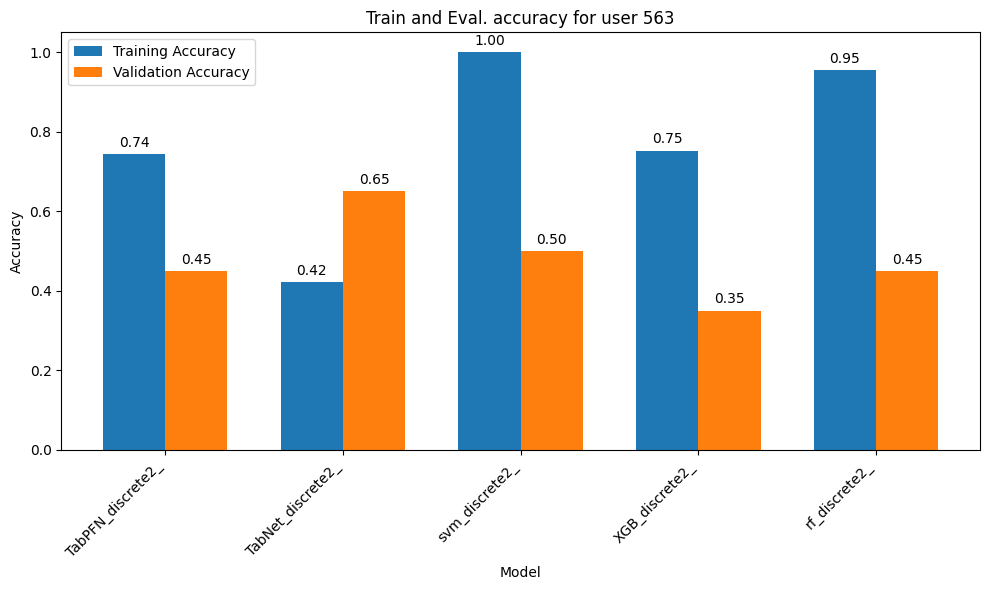

In [ ]:
# Extract model names and accuracy scores
model_names = ['TabPFN_discrete2_', 'TabNet_discrete2_', 'svm_discrete2_', 'XGB_discrete2_', 'rf_discrete2_']
patient_ids = list(separated_ids_features_prepared.keys())

for i, patient_id in enumerate(patient_ids):
  train_accuracies = [all_scores_discrete[model+str(i+1)][0] for model in model_names]
  eval_accuracies = [all_scores_discrete[model+str(i+1)][1] for model in model_names]

  # Set up the bar plot
  bar_width = 0.35
  index = np.arange(len(model_names))

  fig, ax = plt.subplots(figsize=(10, 6))

  bar1 = ax.bar(index - bar_width/2, train_accuracies, bar_width, label='Training Accuracy')
  bar2 = ax.bar(index + bar_width/2, eval_accuracies, bar_width, label='Validation Accuracy')

  # Add labels, title, and ticks
  ax.set_xlabel('Model')
  ax.set_ylabel('Accuracy')
  ax.set_title('Train and Eval. accuracy for user '+str(patient_id))
  ax.set_xticks(index)
  ax.set_xticklabels(model_names)
  ax.legend()

  # Add accuracy values on top of the bars
  def autolabel(bars):
      for bar in bars:
          height = bar.get_height()
          ax.annotate(f'{height:.2f}',
                      xy=(bar.get_x() + bar.get_width() / 2, height),
                      xytext=(0, 3),  # 3 points vertical offset
                      textcoords="offset points",
                      ha='center', va='bottom')

  autolabel(bar1)
  autolabel(bar2)

  plt.xticks(rotation=45, ha='right')
  plt.tight_layout()
  plt.show()